**EXP1 Predicitng Missing Cell-Types from Bulks using Non-Negative Least Squares regression Residual**

*This file includes EXP1 analysis and results. Files used were created in preprocessing/EXP1_pseudos notebook.*

**Summary:**
Increasing the number of missing celltypes, using random proportions pseudobulks. Then attempting to extract missing cell type information from residual. 

The residual is calculated in three different ways named: Residual (comparing NNLS calculated proportions to pseudobulks), Residual_diffbase (using different baseline being comapred to), and Residual_realref (using a "real" reference profile for cell lines).

This specific notebook uses only 5 cell types, with NO noise added in pseudobulks. 

**Hypothesis:**
Deleting cell types from NNLS reference will create a residual from which we can extract missing cell type information. 

**Deconv. Method:**
NNLS

**Factorization Methods:**
SVD, PCA, ICA

In [1564]:
# import the dependencies
import sys
sys.path.insert(1, '../../')
sys.path.insert(1, '../')
sys.path.insert(1, '../../../../../')

from functions import sn_sc_preprocess
from functions import validation_processing as vp
from importlib import reload
reload(sn_sc_preprocess)
reload(vp)
# general imports
import warnings
import numpy as np
from numpy import random
from numpy import array
from numpy import diag
from numpy import dot
from numpy import zeros
import pandas as pd
import scanpy as sc
from anndata import AnnData as ad
from tabulate import tabulate

import tensorflow as tf
import sklearn as sk
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import FunctionTransformer
import scipy as sp
from scipy.stats import spearmanr, pearsonr
from scipy.sparse import coo_matrix
from scipy.sparse import csr_matrix
import scipy.stats as stats
from collections import Counter
import scipy as sp
from scipy.optimize import nnls
from scipy.stats import ttest_ind

# Images, plots, display, and visualization
import matplotlib.pyplot as plt
import seaborn as sns
#sklearns
from sklearn.decomposition import FastICA
from sklearn.decomposition import NMF
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import adjusted_rand_score
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier

# programming stuff
import time
import os, sys
import pickle
from pathlib import Path

In [1565]:
#####################
### set the study ###
#####################
#paths:
res_name = "MCT_snadp_EXP1"
pseudo_name = "MCT_snadp_EXP1_5CTnonoise"
actual_path = os.getcwd()
path = f"{actual_path}/../data/EXP1/"
aug_data_path = f"{actual_path}/../data/EXP1/"
cibersort_path = f"{actual_path}/../data/EXP1/cibersort/CIBERSORTx_Job1_EXP1_randomprop_pt0_cibersort_signatmat_inferred_phenoclasses.CIBERSORTx_Job1_EXP1_randomprop_pt0_cibersort_signatmat_inferred_refsample.bm.K999.txt"

#########number of cells to delete########
num_missing_cells = [0,1,2,3]

Import the previously processed datasets. 

*See preprocessing/EXP1_pseudos.ipynb notebook for details.*

In [1566]:
#and as anndata object
adata_path = os.path.join(aug_data_path, f"{res_name}_adata_notlog.h5ad")
adata_path = Path(adata_path)
sn_adata = sc.read_h5ad(adata_path)
sn_adata

AnnData object with n_obs × n_vars = 122808 × 28518
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'cell_types'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_var_genes'

In [1567]:
#excluding all cell types except 5 of interest
exclude = ['preadipocyte',
    'mesothelial cell',
    'pericyte cell',
    'fat cell',
    'endothelial cell',
    'endothelial cell of lymphatic vessel',
    'smooth muscle cell',
    'mast cell',
    'immature NK T cell',
    'stromal cell of endometrium',
    'neutrophil']
sn_adata = sn_adata[~sn_adata.obs["cell_types"].isin(exclude), :]
#Tilde is “not”, so this reads like “var names that are not in exclude”
Counter(sn_adata.obs["cell_types"])

Counter({'macrophage': 14543,
         'T cell': 3629,
         'dendritic cell': 764,
         'B cell': 272,
         'monocyte': 820})

In [1568]:
# cell type order to keep it the same
cell_order = sn_adata.obs.cell_types.unique()
num_cells = len(sn_adata.obs.cell_types.unique())

Randomly selecting cells to delete:

In [1569]:
#initiaiting
cells_to_choose = np.array(range(0,len(cell_order)))
cells_to_miss = dict()
cells_to_miss[0] = np.array([])
past_miss = cells_to_miss[0]

cells_to_miss[num_missing_cells[-1:][0]] = np.random.choice(cells_to_choose,
                                 num_missing_cells[-1:][0] , replace=False)

In [1570]:
#selecting randomly 1 and 2
cells_to_miss[1] = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_choose = np.delete(cells_to_choose, cells_to_miss[1])
new_rand = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_miss[2] = np.append(cells_to_miss[1], new_rand)
cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand)

In [1571]:
#adding one random selection
new_rand = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_miss[3] = np.append(cells_to_miss[2], new_rand)
cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand)

In [1572]:
cells_to_miss 

{0: array([], dtype=float64),
 3: array([2, 1, 4]),
 1: array([2]),
 2: array([2, 1])}

In [1573]:
#matching order 0-3
changing_order = cells_to_miss[3]
cells_to_miss.pop(3)
cells_to_miss[3] = changing_order
#QC selections
cells_to_miss

{0: array([], dtype=float64),
 1: array([2]),
 2: array([2, 1]),
 3: array([2, 1, 4])}

**Deconvolution using NNLS**

Creating reference profile:

In [1574]:
# Making cell type reference without scaling
cell_types = sn_adata.obs["cell_types"].unique()
gene_ids = sn_adata.var["gene_ids"]
ref_raw = pd.DataFrame(index = gene_ids, columns = cell_types)
num_samples = 10000
for cell_type in cell_types:
    cell_df = sn_adata[sn_adata.obs["cell_types"].isin([cell_type])]
    cell_sample = sk.utils.resample(cell_df, n_samples = num_samples, replace=True)
    x = cell_sample.X.sum(axis=0)
    sum_over_genes = pd.DataFrame(x).T
    #and save to df dict
    ref_raw[cell_type] = sum_over_genes.values
ref_raw

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,120.0,140.0,187.0,82.0,92.0
A1BG-AS1,365.0,321.0,652.0,326.0,422.0
A1CF,7.0,22.0,20.0,0.0,0.0
A2M,10383.0,11461.0,9242.0,2198.0,2072.0
A2M-AS1,106.0,1429.0,119.0,218.0,59.0
...,...,...,...,...,...
PLA2G1B,0.0,0.0,0.0,0.0,0.0
SERPINB13,0.0,0.0,0.0,0.0,0.0
SLC17A2,0.0,0.0,0.0,0.0,0.0


In [1575]:
# Making cell type reference with just average
cell_types = sn_adata.obs["cell_types"].unique()
gene_ids = sn_adata.var["gene_ids"]
ref_av = pd.DataFrame(index = gene_ids, columns = cell_types)

for cell_type in cell_types:
    
    cell_sample = sn_adata[sn_adata.obs["cell_types"].isin([cell_type])]
    x = cell_sample.X.mean(axis=0)
    sum_over_genes = pd.DataFrame(x).T

    #and save to df dict
    ref_av[cell_type] = sum_over_genes.values
ref_av

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.011277,0.013227,0.019634,0.007353,0.009756
A1BG-AS1,0.038231,0.031414,0.061518,0.033088,0.040244
A1CF,0.000894,0.001653,0.002618,0.000000,0.000000
A2M,1.049828,1.163954,0.908377,0.220588,0.207317
A2M-AS1,0.010452,0.144117,0.011780,0.025735,0.006098
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000069,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


In [1576]:
#clippign before scaling to 95th pecentile
ref_av_val = ref_av.values
clip_upper = np.quantile(ref_av_val, 0.95)
ref_av_val = np.clip(ref_av_val, 0, clip_upper)
ref_av = pd.DataFrame(ref_av_val,index = gene_ids, columns = cell_types)
ref_av

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.011277,0.013227,0.019634,0.007353,0.009756
A1BG-AS1,0.038231,0.031414,0.061518,0.033088,0.040244
A1CF,0.000894,0.001653,0.002618,0.000000,0.000000
A2M,0.443851,0.443851,0.443851,0.220588,0.207317
A2M-AS1,0.010452,0.144117,0.011780,0.025735,0.006098
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000069,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


In [1577]:
#clippign before scaling to 95th pecentile
ref_raw_val = ref_raw.values
clip_upper = np.quantile(ref_raw_val, 0.95)
ref_raw_val = np.clip(ref_raw_val, 0, clip_upper)
#and scaling to be between values 0 and 1 to use for NNLS
scaler = MinMaxScaler()
scaler.fit(ref_raw_val)
ref_df = scaler.transform(ref_raw_val)
ref_df = pd.DataFrame(ref_df, index = gene_ids, columns = cell_types)
ref_raw = pd.DataFrame(ref_raw_val, index = gene_ids, columns = cell_types)
ref_df

,macrophage,T cell,dendritic cell,B cell,monocyte
gene_ids,,,,,
A1BG,0.027288,0.031836,0.042524,0.018647,0.020921
A1BG-AS1,0.083001,0.072995,0.148264,0.074132,0.095963
A1CF,0.001592,0.005003,0.004548,0.000000,0.000000
A2M,1.000000,1.000000,1.000000,0.499824,0.471171
A2M-AS1,0.024104,0.324954,0.027061,0.049573,0.013417
...,...,...,...,...,...
PLA2G1B,0.000000,0.000000,0.000000,0.000000,0.000000
SERPINB13,0.000000,0.000000,0.000000,0.000000,0.000000
SLC17A2,0.000000,0.000000,0.000000,0.000000,0.000000


In [1578]:
#each pseudo file has:
## realisitc*200, cell_type_specific*1000*, random*200, equal*200
#so here we're defining the ranges to extract the bulks of choice.
bulk_range = dict()
bulk_range["realistic"] = range(0,200)
bulk_range["cell_type_specific"] = range(200,(50*num_cells)+200) #1000
bulk_range["random"] = range((50*num_cells)+200,(50*num_cells)+400) #1200
bulk_range["equal"] = range((50*num_cells)+400,(50*num_cells)+600) #1400

In [1579]:
#importing bulks to deconvolve
##select_bulks(bulk_type, num_bulks_touse, num_idx_total, res_name, path)
prop_df, pseudo_df = vp.select_bulks('random', 100, 10, pseudo_name, aug_data_path, bulk_range)
pseudo_df

gene_ids,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,A3GALT2,A4GALT,A4GNT,...,HIST1H3I,LINC01972,LINC02393,NCCRP1,PAEP,PLA2G1B,SERPINB13,SLC17A2,TBC1D3B,Z82186.1
0,52.0,160.0,3.0,3811.0,218.0,33.0,250.0,9.0,35.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,89.0,230.0,9.0,4616.0,108.0,50.0,226.0,18.0,35.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,59.0,192.0,8.0,3702.0,217.0,46.0,178.0,10.0,49.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,70.0,223.0,10.0,3823.0,192.0,41.0,168.0,12.0,43.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,53.0,192.0,4.0,3328.0,250.0,44.0,155.0,15.0,54.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,30.0,194.0,2.0,2284.0,77.0,43.0,196.0,15.0,50.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
996,50.0,200.0,3.0,3351.0,179.0,40.0,216.0,10.0,59.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
997,30.0,194.0,2.0,2284.0,77.0,43.0,196.0,15.0,50.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
998,82.0,220.0,5.0,4694.0,402.0,27.0,169.0,16.0,26.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [1580]:
#clippign before scaling to 95th pecentile
pseudo_copy = pseudo_df.copy() #keeping genes
pseudo_df = pseudo_df.values #np array
clip_upper = np.quantile(pseudo_df, 0.95)
pseudo_df = np.clip(pseudo_df, 0, clip_upper)
#and normalize to values between 0 and 1
scaler = MinMaxScaler()
scaler.fit(pseudo_df)
normalized_pseudo_df = scaler.transform(pseudo_df)
normalized_pseudo_df = pd.DataFrame(normalized_pseudo_df, 
                            columns = pseudo_copy.columns, index= pseudo_copy.index)
normalized_pseudo_df      

gene_ids,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,A3GALT2,A4GALT,A4GNT,...,HIST1H3I,LINC01972,LINC02393,NCCRP1,PAEP,PLA2G1B,SERPINB13,SLC17A2,TBC1D3B,Z82186.1
0,0.293333,0.103226,0.157895,1.0,0.315978,0.343284,0.508772,0.300000,0.197368,0.000000,...,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0
1,0.786667,0.554839,0.473684,1.0,0.118492,0.597015,0.424561,0.600000,0.197368,0.000000,...,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0
2,0.386667,0.309677,0.421053,1.0,0.314183,0.537313,0.256140,0.333333,0.381579,0.000000,...,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0
3,0.533333,0.509677,0.526316,1.0,0.269300,0.462687,0.221053,0.400000,0.302632,0.000000,...,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0
4,0.306667,0.309677,0.210526,1.0,0.373429,0.507463,0.175439,0.500000,0.447368,0.000000,...,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.000000,0.322581,0.105263,1.0,0.062837,0.492537,0.319298,0.500000,0.394737,0.000000,...,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
996,0.266667,0.361290,0.157895,1.0,0.245961,0.447761,0.389474,0.333333,0.513158,0.000000,...,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0
997,0.000000,0.322581,0.105263,1.0,0.062837,0.492537,0.319298,0.500000,0.394737,0.000000,...,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
998,0.693333,0.490323,0.263158,1.0,0.646320,0.253731,0.224561,0.533333,0.078947,0.000000,...,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0


In [1581]:
# read in cibersort genes 
cibersort_df = pd.read_csv(cibersort_path, sep="\t")
cibersort_genes = cibersort_df["NAME"].values.tolist()
gene_ids = cibersort_genes
len(gene_ids)

3427

In [1582]:
#deleting genes not in current df
gene_notin = {'A2M.AS1', 'A2ML1.AS1', 'AADACL2.AS1', 'ABCA9.AS1', 'ADAMTS9.AS1', 
'ADAMTS9.AS2', 'ADAMTSL4.AS1', 'ADIPOQ.AS1', 'ALOX12.AS1', 'ARMCX5.GPRASP2', 
'BAALC.AS1', 'BIRC6.AS2', 'CBR3.AS1', 'CELF2.AS2', 'CERS3.AS1', 'CKMT2.AS1', 
'CTBP1.AS', 'CYP1B1.AS1', 'CYYR1.AS1', 'DLGAP4.AS1', 'DNMBP.AS1', 'EIF1B.AS1', 
'EIF3J.AS1', 'ELMO1.AS1', 'ENTPD3.AS1', 'ERV3.1', 'FAM13A.AS1', 'FLG.AS1', 
'GNA14.AS1', 'GPRC5D.AS1', 'HAND2.AS1', 'HLA.DMA', 'HLA.DMB', 'HLA.DQA1', 'HLA.DQB1',
 'HLA.DRB5', 'HLA.F', 'HLX.AS1', 'HOXB.AS1', 'IFNG.AS1', 'IQCJ.SCHIP1', 'ITGA9.AS1',
  'ITGB2.AS1', 'KCNIP2.AS1', 'KCNIP4.IT1', 'KCNK15.AS1', 'KCNMA1.AS1', 'KCNMB2.AS1',
   'KIZ.AS1', 'KLRC4.KLRK1', 'KRTAP10.4', 'LANCL1.AS1', 'LIX1.AS1', 'LRP4.AS1',
    'LRRC75A.AS1', 'LURAP1L.AS1', 'LY86.AS1', 'MAGI1.AS1', 'MAMDC2.AS1', 'MAP3K20.AS1',
     'MEIS1.AS2', 'MRVI1.AS1', 'MSC.AS1', 'MT.ND6', 'MYLK.AS1', 'NR2F2.AS1', 'NUP50.AS1', 
     'PALM2.AKAP2', 'PARD6G.AS1', 'PAX8.AS1', 'PCDH9.AS2', 'PCED1B.AS1', 'PKP4.AS1', 
     'PRKCA.AS1', 'PRKCQ.AS1', 'PROX1.AS1', 'RAET1E.AS1', 'RASSF8.AS1', 'RBAK.RBAKDN',
      'RBMS3.AS3', 'RDH10.AS1', 'RHOXF1.AS1', 'ROR1.AS1', 'SATB1.AS1', 'SEMA6A.AS1', 
      'SGO1.AS1', 'SKAP1.AS1', 'SLC14A2.AS1', 'SLC5A4.AS1', 'SLC6A1.AS1', 'SMAD1.AS2',
       'SNAP25.AS1', 'SOCS2.AS1', 'SPRY4.AS1', 'ST7.AS2', 'STON1.GTF2A1L', 'SUCLG2.AS1',
        'TCF4.AS1', 'TEX26.AS1', 'THRA1.BTR', 'THSD4.AS1', 'TMEM220.AS1', 'TMEM72.AS1', 
        'TRG.AS1', 'TRHDE.AS1', 'TSPOAP1.AS1', 'UBOX5.AS1', 'UBR5.AS1', 'VAV3.AS1', 
        'VCAN.AS1', 'VIPR1.AS1', 'VLDLR.AS1', 'WAC.AS1', 'WT1.AS', 'ZBED3.AS1', 
        'ZBTB20.AS1', 'ZEB1.AS1', 'ZFPM2.AS1', 'ZMYM4.AS1', 'ZRANB2.AS2'}
gene_ids = [ele for ele in gene_ids if ele not in gene_notin]
len(gene_ids)     

3307

In [1583]:
#cutting to cibersort genes 
pseudo_copy  = pseudo_copy[gene_ids]
ref_raw = ref_raw.loc[gene_ids,:]
ref_df = ref_df.loc[gene_ids,:]
ref_av = ref_av.loc[gene_ids,:]
normalized_pseudo_df = normalized_pseudo_df[gene_ids]
normalized_pseudo_df

gene_ids,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.214984,0.528571,0.352431,0.532986,1.000000,0.335740,0.374419,0.460581,0.439582,0.137710,...,0.397490,0.374659,0.388154,0.437586,0.398323,0.446301,0.538462,0.453608,0.283765,0.578254
1,0.214984,0.616883,0.352431,0.625000,1.000000,0.133574,0.641860,0.356846,0.600261,0.732586,...,0.535565,0.148955,0.807936,0.105624,0.616352,0.486874,0.747253,0.402062,0.197817,0.657331
2,0.369707,0.571429,0.215278,0.307292,1.000000,0.371841,0.539535,0.150761,0.559112,0.267414,...,0.485356,0.356040,0.397930,0.160494,0.551363,0.439141,0.645604,0.360825,0.330150,0.439868
3,0.374593,0.570130,0.407986,0.387153,1.000000,0.270758,0.555814,0.327801,0.585238,0.468375,...,0.656904,0.287466,0.523864,0.172840,0.536688,0.577566,0.717033,0.082474,0.251023,0.545305
4,0.228013,0.462338,0.496528,0.232639,0.491628,0.435018,0.439535,0.316736,0.349445,0.219376,...,0.460251,0.504995,0.269120,0.308642,0.475891,0.310263,0.398352,0.134021,0.519782,0.341021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.734528,0.831169,0.418403,0.213542,0.933691,0.128159,0.639535,0.312586,0.787720,0.191353,...,0.577406,0.147593,0.334675,0.289438,0.752621,0.572792,0.750000,0.103093,0.070941,0.637562
996,0.426710,0.632468,0.494792,0.560764,1.000000,0.326715,0.479070,0.438451,0.492489,0.296237,...,0.598326,0.281108,0.378953,0.356653,0.511530,0.498807,0.673077,0.412371,0.261937,0.543657
997,0.734528,0.831169,0.418403,0.213542,0.933691,0.128159,0.639535,0.312586,0.787720,0.191353,...,0.577406,0.147593,0.334675,0.289438,0.752621,0.572792,0.750000,0.103093,0.070941,0.637562
998,0.172638,0.267532,0.298611,0.324653,0.692565,0.527076,0.430233,0.163209,0.291966,0.393915,...,0.234310,0.701181,0.450259,0.041152,0.375262,0.362768,0.359890,0.185567,0.633015,0.303130


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.051s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 2.488136
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.060493
[t-SNE] KL divergence after 500 iterations: 0.746804
[t-SNE] Computing 4 nearest neighbors...
[t-SNE] Indexed 5 samples in 0.000s...
[t-SNE] Computed neighbors for 5 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 5 / 5
[t-SNE] Mean sigma: 1125899906842624.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 32.713768
[t-SNE] KL divergence after 500 iterations: 0.110446


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


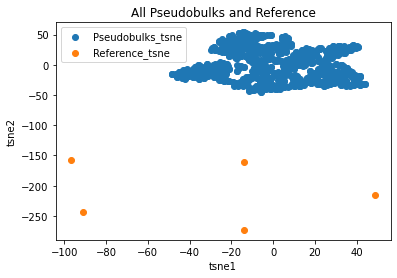

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.044s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 2.488136
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.030045
[t-SNE] KL divergence after 500 iterations: 0.746215
[t-SNE] Computing 4 nearest neighbors...
[t-SNE] Indexed 5 samples in 0.000s...
[t-SNE] Computed neighbors for 5 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 5 / 5
[t-SNE] Mean sigma: 1125899906842624.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.908161
[t-SNE] KL divergence after 500 iterations: 0.110453


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


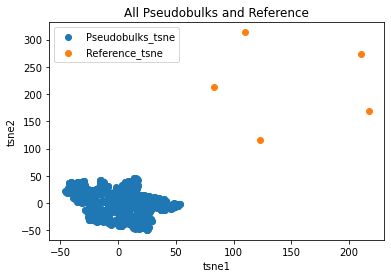

In [1584]:
#tsne plots of reference dataframes with the normalized pseudobulks
tsne = TSNE(n_components=2, perplexity=20, verbose=1, n_iter=500)
res_tsne = tsne.fit_transform(normalized_pseudo_df)
ref_tsne = tsne.fit_transform(ref_df.T)
plt.scatter(res_tsne[:,0], res_tsne[:,1], label = "Pseudobulks_tsne" )
plt.scatter(ref_tsne[:,0], ref_tsne[:,1], label = "Reference_tsne" )
plt.title(f"All Pseudobulks and Reference")
plt.xlabel("tsne1")
plt.ylabel("tsne2")
plt.legend()
plt.show()
tsne = TSNE(n_components=2, perplexity=20, verbose=1, n_iter=500)
res_tsne = tsne.fit_transform(normalized_pseudo_df)
ref_tsne = tsne.fit_transform(ref_av.T)
plt.scatter(res_tsne[:,0], res_tsne[:,1], label = "Pseudobulks_tsne" )
plt.scatter(ref_tsne[:,0], ref_tsne[:,1], label = "Reference_tsne" )
plt.title(f"All Pseudobulks and Reference")
plt.xlabel("tsne1")
plt.ylabel("tsne2")
plt.legend()
plt.show()

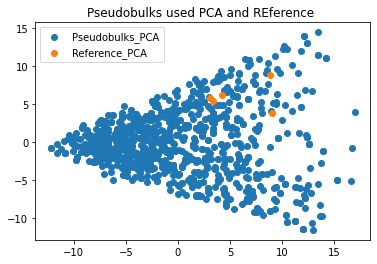

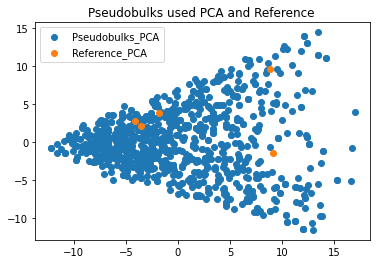

In [1585]:
#PCA plots of reference dataframes with the normalized pseudobulks
pca = PCA(n_components = 2)
pseudos_pca = pca.fit_transform(normalized_pseudo_df)
ref_pca = pca.transform(ref_av.T)
plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Pseudobulks_PCA" )
plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
plt.title("Pseudobulks used PCA and REference ")
plt.xlabel
plt.legend()
plt.show()
pca = PCA(n_components = 2)
pseudos_pca = pca.fit_transform(normalized_pseudo_df)
ref_pca = pca.transform(ref_df.T)
plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Pseudobulks_PCA" )
plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
plt.title("Pseudobulks used PCA and Reference ")
plt.xlabel
plt.legend()
plt.show()

In [1586]:
#making a "real" pseudobulk by multp. prop and unscaled reference
pseudo_df_realref = prop_df @ ref_av.T 
pseudo_df_realref = pd.DataFrame(pseudo_df_realref)
#making a "real" pseudobulk by multp. prop and scaled ref
pseudo_df_real = prop_df @ ref_df.T 
pseudo_df_real = pd.DataFrame(pseudo_df_real)

In [1587]:
# Putting together all reference expression, scaled and unscaled, and props.
all_refs = dict()
all_prop_refs = dict()
all_prop_refs_rebalanced = dict()
all_refs_raw = dict()
all_refs_av = dict()
#with no cell missing is just ref_df
all_refs[0] = ref_df
all_refs_av[0] = ref_av
all_refs_raw[0] = ref_raw
all_prop_refs[0] = prop_df
all_prop_refs_rebalanced[0] = prop_df
#assigning the rest in a loop
for num in num_missing_cells[1:]:
    #dropping cell types missing from references
    all_refs[num] = ref_df.drop(ref_df.columns[cells_to_miss[num]], axis=1)
    all_refs_av[num] = ref_av.drop(ref_av.columns[cells_to_miss[num]], axis=1)
    all_refs_raw[num] = ref_raw.drop(ref_raw.columns[cells_to_miss[num]], axis=1)
    all_prop_refs[num] = prop_df.drop(prop_df.columns[cells_to_miss[num]], axis=1) 
    all_prop_refs_rebalanced[num] = all_prop_refs[num]
    for idx,sample in all_prop_refs_rebalanced[num].iterrows():
        tot = np.sum(sample) #making them equal 1
        sample = sample / tot

NNLS Deconvolution:

In [1588]:
calc_prop_tot, calc_res_tot, custom_res_tot, comparison_prop_tot, missing_cell_tot  = vp.calc_nnls(all_refs, prop_df, normalized_pseudo_df, num_missing_cells, cells_to_miss)

Exp 0
Exp 1
Exp 2
Exp 3


Evalutating NNLS Performance:

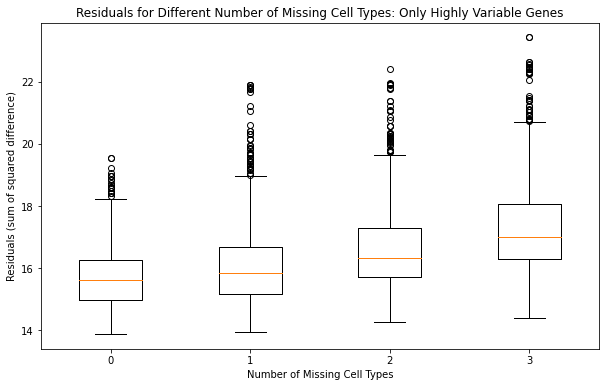

In [1589]:
#Distribution of residuals as the sum of squared difference from NNLS
residuals = [calc_res_tot[exp] for exp in num_missing_cells]

plt.figure(figsize=(10, 6))
plt.boxplot(residuals, labels=num_missing_cells)
plt.xlabel('Number of Missing Cell Types')
plt.ylabel('Residuals (sum of squared difference)')
plt.title('Residuals for Different Number of Missing Cell Types: Only Highly Variable Genes')
## nnls(A, b)
## /Ax -b/^2
plt.show()

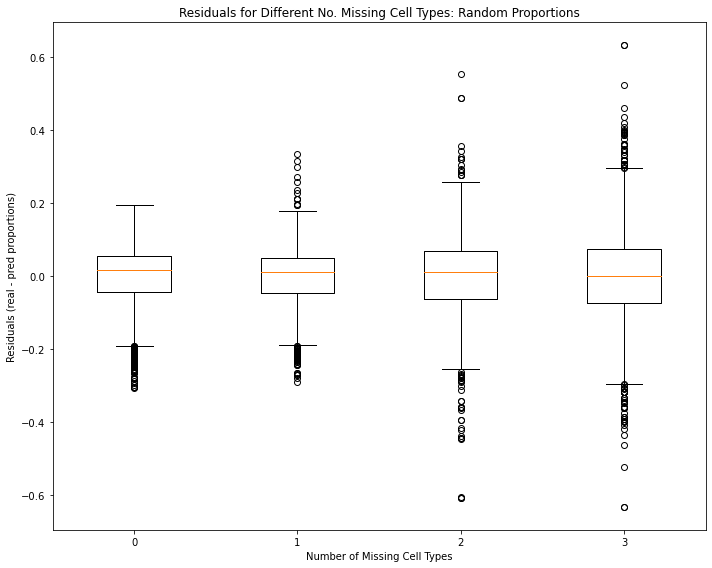

In [1590]:
#Distribution of residuals as the difference between calculated and real proportions.
fig, ax = plt.subplots(figsize=(10, 8))

# List to store all the residual values
residual_values = []

# Iterate over the dataframes and extract the residual values
for num_cells in num_missing_cells:
    df = custom_res_tot[num_cells]
    residuals = df.values.flatten()  # Flatten the dataframe to a 1D array
    residual_values.append(residuals)

# Plot the box and whisker plot for all the residuals
ax.boxplot(residual_values, labels=num_missing_cells)
ax.set_title("Residuals for Different No. Missing Cell Types: Random Proportions")
ax.set_xlabel("Number of Missing Cell Types")
ax.set_ylabel("Residuals (real - pred proportions)")

plt.tight_layout()
plt.show()

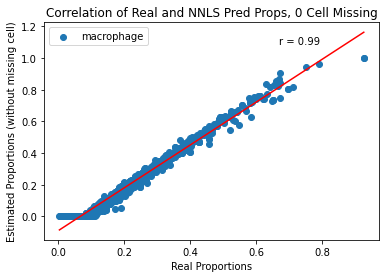

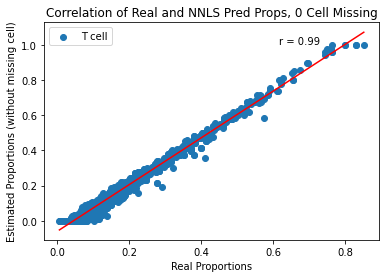

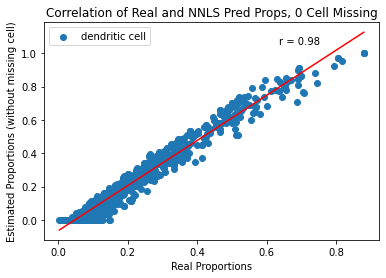

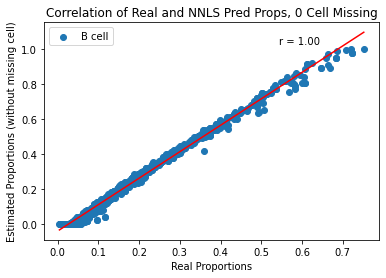

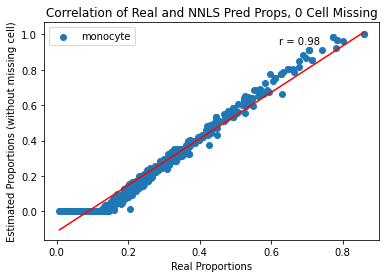

In [1591]:
#Evaluation performance with no cell types missing, expect to be very close to 1.
num = 0 
for col_cell in all_prop_refs[num].columns:
    x = all_prop_refs[num][col_cell].values.astype(float)
    y = calc_prop_tot[num][col_cell].values.astype(float)
    correlation_coefficient = np.corrcoef(x, y)[0,1]
    plt.scatter(x, y, label= f"{col_cell}")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.legend()
    plt.show()

Real Proportions shape: (5000,)
Estimated Proportions shape: (5000,)


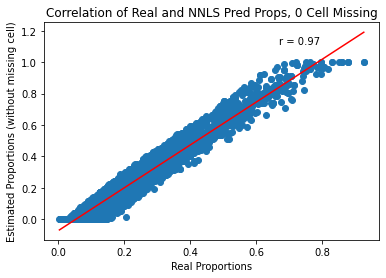

Real Proportions shape: (4000,)
Estimated Proportions shape: (4000,)


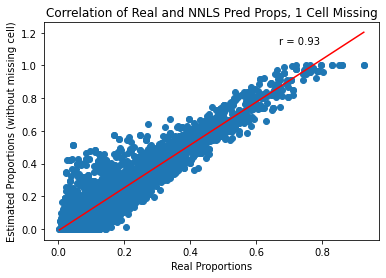

Real Proportions shape: (3000,)
Estimated Proportions shape: (3000,)


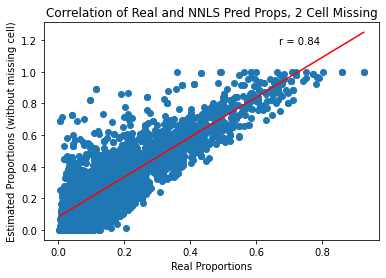

Real Proportions shape: (2000,)
Estimated Proportions shape: (2000,)


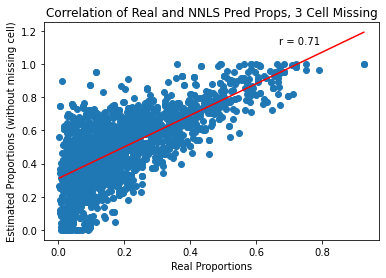

In [1592]:
#Evaluating perfomance for each num of cell types missing, across all cell types.
for num in num_missing_cells:
    real_proportions = all_prop_refs[num].values.flatten().astype(float)
    estimated_proportions = calc_prop_tot[num].values.flatten().astype(float)

    # Print the shapes of the matrices
    print("Real Proportions shape:", real_proportions.shape)
    print("Estimated Proportions shape:", estimated_proportions.shape)

    correlation_coefficient = np.corrcoef(real_proportions, estimated_proportions)[0,1]

    # Create a scatter plot
    plt.scatter(real_proportions.flatten(), estimated_proportions.flatten())
    x = real_proportions
    y = estimated_proportions
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.show()

Recreate Matrices:

In [1593]:
#recreate matrix with calculated proportion nnls and multiplying by the used reference
recreated_mat_all = dict()
for num in num_missing_cells:
        recreated_mat_all[num] = pd.DataFrame(all_refs[num] @ calc_prop_tot[num].T)
        recreated_mat_all[num] = recreated_mat_all[num].T
        recreated_mat_all[num].columns = gene_ids
recreated_mat_all[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.590674,0.433249,0.388860,0.375704,0.591437,0.140140,0.260023,0.196825,0.301915,0.353775,...,0.225414,0.394254,0.453537,0.190150,0.334722,0.233267,0.325014,0.051402,0.208218,0.319500
1,0.600125,0.415458,0.340807,0.388493,0.905062,0.069873,0.348488,0.145775,0.433138,0.725464,...,0.245782,0.113916,0.864514,0.039142,0.424466,0.281308,0.344780,0.049605,0.157276,0.358717
2,0.637738,0.438329,0.345597,0.344162,0.589061,0.132610,0.320867,0.072508,0.446594,0.442965,...,0.223513,0.350321,0.495298,0.043899,0.394422,0.244822,0.301788,0.043208,0.229318,0.316512
3,0.618028,0.396625,0.377824,0.330664,0.676367,0.116296,0.331372,0.148816,0.369458,0.585567,...,0.236398,0.282517,0.611831,0.073192,0.401509,0.242363,0.314198,0.040538,0.207015,0.304598
4,0.612779,0.366504,0.405630,0.290700,0.451280,0.181378,0.288850,0.149369,0.261840,0.410006,...,0.220508,0.514142,0.350990,0.118672,0.355433,0.202195,0.283480,0.035489,0.278584,0.252290
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.715255,0.539535,0.401200,0.317393,0.490023,0.066114,0.359149,0.144571,0.583021,0.348017,...,0.242904,0.162709,0.366381,0.128962,0.427624,0.243233,0.318801,0.037730,0.119121,0.330846
996,0.613731,0.451542,0.393466,0.364996,0.597770,0.118562,0.284384,0.195834,0.356527,0.383016,...,0.231691,0.322661,0.468979,0.178241,0.357641,0.237786,0.327469,0.048651,0.182399,0.323941
997,0.715255,0.539535,0.401200,0.317393,0.490023,0.066114,0.359149,0.144571,0.583021,0.348017,...,0.242904,0.162709,0.366381,0.128962,0.427624,0.243233,0.318801,0.037730,0.119121,0.330846
998,0.562500,0.280635,0.348655,0.301976,0.554853,0.228005,0.281500,0.059070,0.192850,0.546711,...,0.206540,0.632653,0.499860,0.001462,0.351548,0.208953,0.264890,0.037074,0.369592,0.240290


In [1594]:
#recreate matrix with calculated proportion nnls and multiplying by the av. reference
recreated_mat_all_realref = dict()
for num in num_missing_cells:
        recreated_mat_all_realref[num] = pd.DataFrame(all_refs_av[num] @ calc_prop_tot[num].T)
        recreated_mat_all_realref[num] = recreated_mat_all_realref[num].T
        recreated_mat_all_realref[num].columns = gene_ids
recreated_mat_all_realref[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.263016,0.188840,0.173428,0.168416,0.266034,0.060352,0.118219,0.085074,0.137836,0.160167,...,0.098218,0.173772,0.200804,0.084807,0.155152,0.103541,0.144482,0.021801,0.088718,0.142794
1,0.265884,0.184783,0.156615,0.176244,0.402411,0.032453,0.158035,0.062723,0.201606,0.332079,...,0.106099,0.050497,0.383760,0.017563,0.190096,0.126537,0.155109,0.019981,0.065953,0.158103
2,0.279129,0.192973,0.150064,0.151024,0.260018,0.057622,0.143626,0.031132,0.202412,0.195778,...,0.097028,0.155457,0.217593,0.019382,0.177145,0.110287,0.133670,0.019086,0.098043,0.140447
3,0.270844,0.176875,0.168359,0.147664,0.300263,0.051242,0.148761,0.064281,0.170175,0.264851,...,0.101964,0.124869,0.269805,0.032994,0.179145,0.109229,0.140646,0.017732,0.087070,0.135220
4,0.266510,0.162156,0.176136,0.127999,0.200956,0.077918,0.129161,0.064759,0.118808,0.181341,...,0.095404,0.227217,0.152839,0.053337,0.159532,0.090990,0.126380,0.016778,0.117984,0.113021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.314323,0.241419,0.174867,0.135576,0.214350,0.028411,0.157525,0.062330,0.262517,0.154216,...,0.104742,0.071360,0.159116,0.057779,0.191061,0.109461,0.138889,0.017942,0.050045,0.148469
996,0.272641,0.198452,0.175479,0.162725,0.267642,0.051224,0.128194,0.084618,0.162564,0.173581,...,0.100619,0.142038,0.207196,0.079614,0.164043,0.105883,0.145229,0.020915,0.077358,0.144830
997,0.314323,0.241419,0.174867,0.135576,0.214350,0.028411,0.157525,0.062330,0.262517,0.154216,...,0.104742,0.071360,0.159116,0.057779,0.191061,0.109461,0.138889,0.017942,0.050045,0.148469
998,0.242094,0.122191,0.150126,0.135250,0.246839,0.098798,0.127999,0.025629,0.089131,0.241286,...,0.089685,0.280847,0.219483,0.000693,0.156755,0.094660,0.120113,0.016651,0.157502,0.105948


Calculate Residuals:

In [1595]:
#Residual as the the difference between the recreated matrix and pseudobulks.
residuals = dict()
for num in num_missing_cells:
    res = normalized_pseudo_df.values - recreated_mat_all[num].values
    residuals[num] = pd.DataFrame(res, columns = gene_ids)
residuals[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,-0.375690,0.095323,-0.036430,0.157283,0.408563,0.195600,0.114396,0.263756,0.137667,-0.216065,...,0.172075,-0.019595,-0.065383,0.247435,0.063601,0.213034,0.213447,0.402207,0.075547,0.258754
1,-0.385141,0.201425,0.011623,0.236507,0.094938,0.063701,0.293373,0.211071,0.167123,0.007122,...,0.289783,0.035040,-0.056579,0.066482,0.191886,0.205565,0.402472,0.352457,0.040542,0.298614
2,-0.268031,0.133100,-0.130319,-0.036870,0.410939,0.239231,0.218668,0.078252,0.112518,-0.175551,...,0.261842,0.005719,-0.097368,0.116594,0.156940,0.194319,0.343816,0.317616,0.100832,0.123357
3,-0.243435,0.173505,0.030162,0.056489,0.323633,0.154463,0.224442,0.178985,0.215780,-0.117192,...,0.420505,0.004949,-0.087967,0.099647,0.135179,0.335203,0.402835,0.041936,0.044008,0.240706
4,-0.384766,0.095834,0.090898,-0.058061,0.040348,0.253640,0.150685,0.167367,0.087605,-0.190631,...,0.239743,-0.009147,-0.081869,0.189970,0.120457,0.108067,0.114872,0.098532,0.241198,0.088731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.019273,0.291634,0.017202,-0.103851,0.443668,0.062045,0.280386,0.168016,0.204699,-0.156664,...,0.334501,-0.015116,-0.031706,0.160476,0.324997,0.329560,0.431199,0.065362,-0.048180,0.306716
996,-0.187021,0.180925,0.101325,0.195767,0.402230,0.208153,0.194686,0.242617,0.135961,-0.086779,...,0.366636,-0.041553,-0.090026,0.178411,0.153890,0.261021,0.345608,0.363720,0.079538,0.219716
997,0.019273,0.291634,0.017202,-0.103851,0.443668,0.062045,0.280386,0.168016,0.204699,-0.156664,...,0.334501,-0.015116,-0.031706,0.160476,0.324997,0.329560,0.431199,0.065362,-0.048180,0.306716
998,-0.389862,-0.013102,-0.050044,0.022677,0.137712,0.299071,0.148732,0.104138,0.099116,-0.152796,...,0.027770,0.068527,-0.049601,0.039690,0.023714,0.153815,0.095000,0.148493,0.263423,0.062841


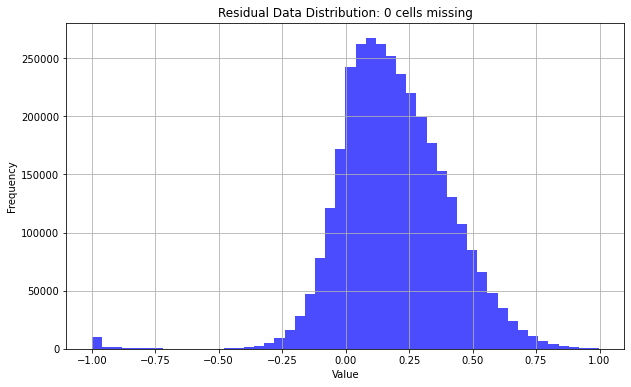

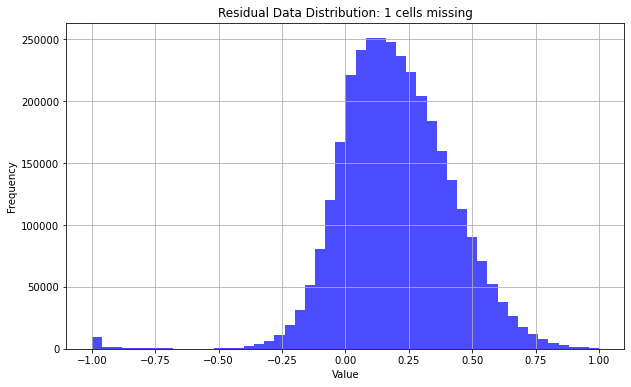

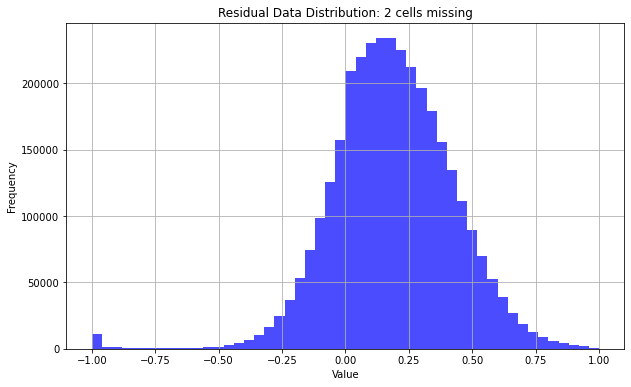

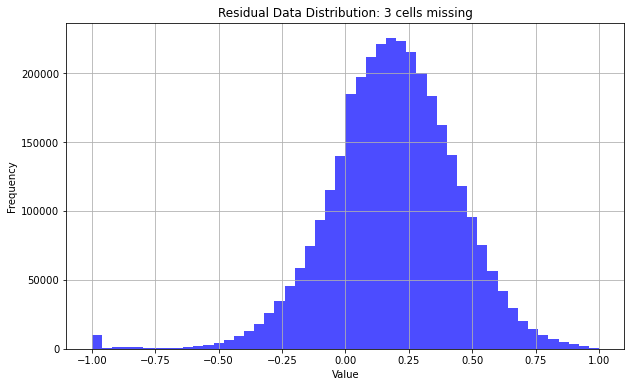

In [1596]:
#Distribution of residuals
for num in num_missing_cells:
    data = residuals[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [1597]:
#Residual with a different baseline, using real proportions * ref expression as baseline
#instead of the pseudobulks as before.
residuals_diffbase = dict()
for num in num_missing_cells:
    res = pseudo_df_real.values - recreated_mat_all[num].values
    residuals_diffbase[num] = pd.DataFrame(res, columns = gene_ids)
residuals_diffbase[0]   

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.01583,0.00374,-0.019424,-0.00594,0.025627,-0.008711,0.025296,-0.045238,0.060853,0.051519,...,0.000703,-0.037751,0.045362,-0.05784,0.02541,0.008609,-0.005022,-0.002176,0.001341,0.0047
1,0.00577,0.014211,-0.006177,0.004406,-0.026776,0.003143,-0.004233,-0.015187,0.020037,-0.045865,...,-0.003073,0.015815,-0.037404,-0.000781,-0.003342,0.000291,-0.002175,0.000936,0.002668,0.003933
2,0.006572,0.012643,-0.000138,0.003522,0.013027,-0.010969,0.006103,0.002786,0.023706,0.003942,...,0.002498,-0.034795,0.012736,0.00149,0.006314,0.004254,0.004237,0.000396,-0.014876,0.007391
3,0.018195,0.034562,-0.014888,0.01011,-0.01297,-0.009786,0.006569,-0.030331,0.069162,-0.045901,...,-0.001532,-0.025663,-0.023148,-0.014723,0.008267,0.007865,0.000717,0.001482,-0.011994,0.015739
4,0.012671,0.029824,-0.019703,0.018305,0.055561,-0.023251,0.016024,-0.024056,0.075733,0.020052,...,0.002861,-0.077764,0.059593,-0.026252,0.018283,0.016679,0.008339,0.002458,-0.025239,0.024934
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.01626,-0.01611,-0.022032,0.014499,0.053436,0.00741,-0.003188,-0.026537,-0.007631,0.039207,...,-0.003514,0.014969,0.064201,-0.032684,-0.000991,0.007392,-0.000538,0.002427,0.018045,0.006282
996,0.01765,0.010856,-0.018185,-0.003614,0.016036,-0.009528,0.022542,-0.042682,0.065064,0.031655,...,0.00042,-0.037153,0.029897,-0.049693,0.022877,0.008397,-0.004053,-0.001632,-0.002074,0.006774
997,-0.01626,-0.01611,-0.022032,0.014499,0.053436,0.00741,-0.003188,-0.026537,-0.007631,0.039207,...,-0.003514,0.014969,0.064201,-0.032684,-0.000991,0.007392,-0.000538,0.002427,0.018045,0.006282
998,0.019836,0.051102,-0.004622,0.020234,0.025335,-0.03105,0.009725,0.004025,0.079795,-0.03178,...,0.005078,-0.092437,0.012026,0.014023,0.011596,0.013873,0.013948,0.003217,-0.045526,0.028548


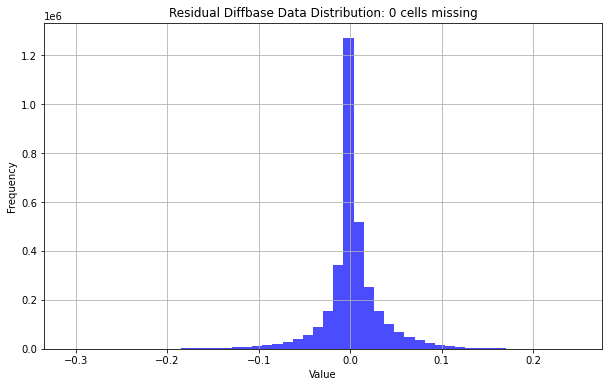

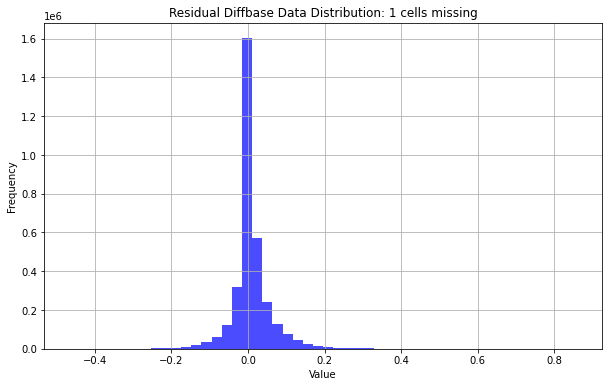

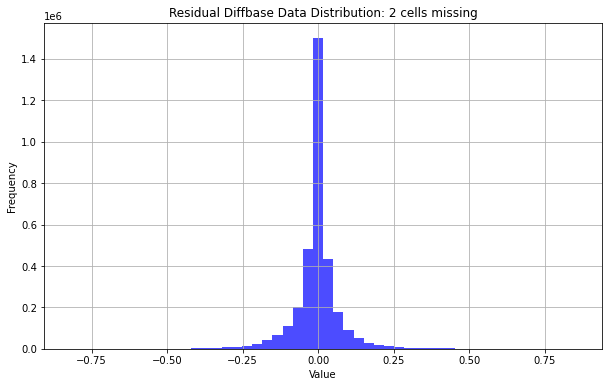

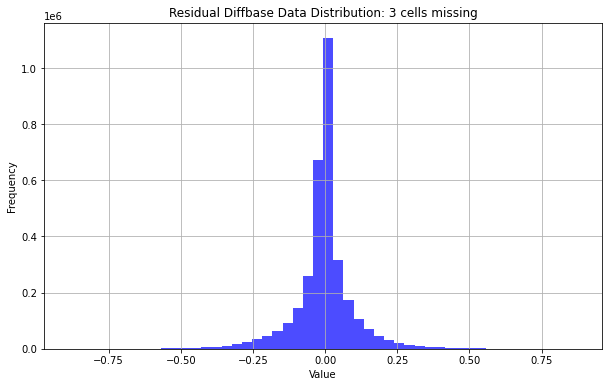

In [1598]:
#distribtuion of values for this residual diffbase:
for num in num_missing_cells:
    data = residuals_diffbase[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Diffbase Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [1599]:
#Residual with a different baseline, using real proportions * average expression as baseline
#instead of the used reference (sum).
residuals_realref = dict()
for num in num_missing_cells:
    res = pseudo_df_realref  - recreated_mat_all_realref[num]
    residuals_realref[num] = pd.DataFrame(res, columns = gene_ids)
residuals_realref[0]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.005569,0.002389,-0.009589,-0.003561,0.009595,-0.003415,0.010802,-0.019655,0.027534,0.022057,...,0.000157,-0.016273,0.019677,-0.025884,0.009634,0.004434,-0.002304,-0.00081,0.00067,0.001586
1,0.002632,0.005644,-0.003707,0.001251,-0.012166,0.001139,-0.002029,-0.006603,0.008307,-0.021824,...,-0.001152,0.007095,-0.016705,-0.000485,-0.001012,0.000056,-0.00142,0.000459,0.001515,0.001806
2,0.003229,0.005866,0.000294,0.001425,0.005579,-0.004657,0.002562,0.001176,0.010777,0.002157,...,0.001035,-0.015443,0.005689,0.000666,0.002767,0.001902,0.001713,0.000125,-0.006389,0.003299
3,0.00822,0.014795,-0.007753,0.003189,-0.006779,-0.004342,0.002497,-0.013226,0.030321,-0.022142,...,-0.000485,-0.011149,-0.010446,-0.006791,0.003939,0.00355,-0.000498,0.000656,-0.004587,0.006936
4,0.006208,0.013172,-0.00832,0.00781,0.023778,-0.009708,0.007081,-0.010547,0.034364,0.00917,...,0.001286,-0.03419,0.026673,-0.011892,0.008041,0.007577,0.003362,0.000714,-0.010481,0.010702
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.007157,-0.008038,-0.009476,0.007363,0.023866,0.003498,-0.000577,-0.011541,-0.002874,0.017582,...,-0.001342,0.006984,0.028948,-0.014758,-0.000287,0.003386,0.0003,0.000564,0.00803,0.002191
996,0.006643,0.005356,-0.009131,-0.002684,0.005418,-0.003864,0.009525,-0.018554,0.029212,0.013001,...,0.000087,-0.016054,0.012831,-0.022273,0.008831,0.004245,-0.002053,-0.00057,-0.000711,0.002608
997,-0.007157,-0.008038,-0.009476,0.007363,0.023866,0.003498,-0.000577,-0.011541,-0.002874,0.017582,...,-0.001342,0.006984,0.028948,-0.014758,-0.000287,0.003386,0.0003,0.000564,0.00803,0.002191
998,0.010344,0.022619,-0.001323,0.008349,0.010833,-0.013357,0.003966,0.001625,0.035749,-0.013692,...,0.002265,-0.041028,0.00559,0.006132,0.005906,0.005996,0.005359,0.001148,-0.019212,0.012805


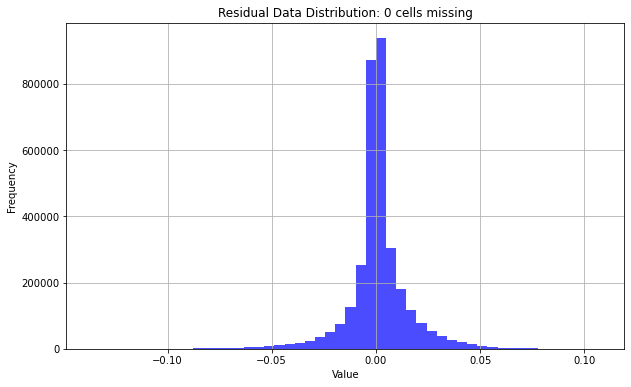

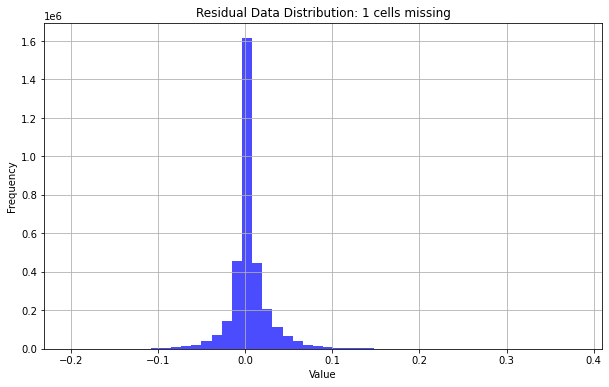

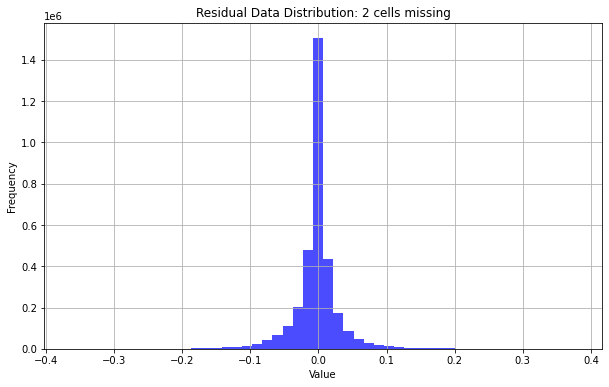

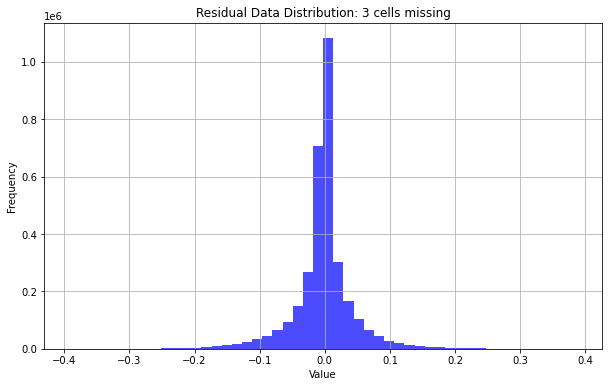

In [1600]:
#distribtuion of values of residual realref:
for num in num_missing_cells:
    data = residuals_realref[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

**Singular Value Decomposition**

SVD on each residual matrix. For this purposes, we will only focus on U and S.

U: Left singular vectors, representing the column space of the original matrix. (cells)

Σ or sigma: Singular values, representing the diagonal matrix of singular values.

Vh or V^T: Right singular vectors, representing the row space of the original matrix. (sample)

In [1601]:
num_cells_missing = [0,1,2,3] #for each number of missing cells

In [1602]:
# SVD on pseudobulk for QC
df = normalized_pseudo_df.T
Mat_pseudo = df.astype("float32")
U_pseudo, s_pseudo, V_pseudo = sp.linalg.svd(Mat_pseudo)
U_pseudo = pd.DataFrame(U_pseudo)
s_pseudo = pd.DataFrame(s_pseudo)
V_pseudo = pd.DataFrame(V_pseudo)

In [1603]:
# SVD on residual 1
U_all = dict()
s_all = dict()
V_all = dict()
Matres_all = dict()

for num in num_cells_missing:
    df = residuals[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all[num] = U
    s_all[num] = s
    V_all[num] = V
    Matres_all[num] = Mat

In [1604]:
# SVD on residual with another reference
U_all_realref = dict()
s_all_realref = dict()
V_all_realref = dict()
Matres_all_realref = dict()

for num in num_cells_missing:
    df = residuals_realref[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all_realref[num] = U
    s_all_realref[num] = s
    V_all_realref[num] = V
    Matres_all_realref[num] = Mat

In [1605]:
# SVD on residual with another reference
U_diffbase = dict()
s_diffbase = dict()
V_diffbase = dict()
Matres_diffbase = dict()

for num in num_cells_missing:
    df = residuals_diffbase[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_diffbase[num] = U
    s_diffbase[num] = s
    V_diffbase[num] = V
    Matres_diffbase[num] = Mat

In [1606]:
#SVD on reference for QC
U_all_ref = dict()
s_all_ref = dict()
V_all_ref = dict()
Matref_all_ref = dict()

for num in num_cells_missing:
    df = all_refs[num].T
    Mat_ref  = df.astype("float32")
    U_ref , s_ref , V_ref  = sp.linalg.svd(Mat_ref )
    U_ref = pd.DataFrame(U_ref )
    s_ref  = pd.DataFrame(s_ref )
    V_ref  = pd.DataFrame(V_ref )

    U_all_ref[num] = U_ref 
    s_all_ref[num] = s_ref 
    V_all_ref[num] = V_ref 
    Matref_all_ref[num] = Mat_ref 

In [1607]:
#SVD on recreated matrix for QC
U_all_rec = dict()
s_all_rec = dict()
V_all_rec = dict()
Matres_all_rec = dict()

for num in num_cells_missing:
    df = recreated_mat_all[num].T
    Mat_rec = df.astype("float32")
    U_rec , s_rec , V_rec  = sp.linalg.svd(Mat_rec )
    U_rec  = pd.DataFrame(U_rec )
    s_rec  = pd.DataFrame(s_rec )
    V_rec  = pd.DataFrame(V_rec )

    U_all_rec[num] = U_rec 
    s_all_rec[num] = s_rec 
    V_all_rec[num] = V_rec 
    Matres_all_rec[num] = Mat_rec 

S-Value Eval for each SVD:

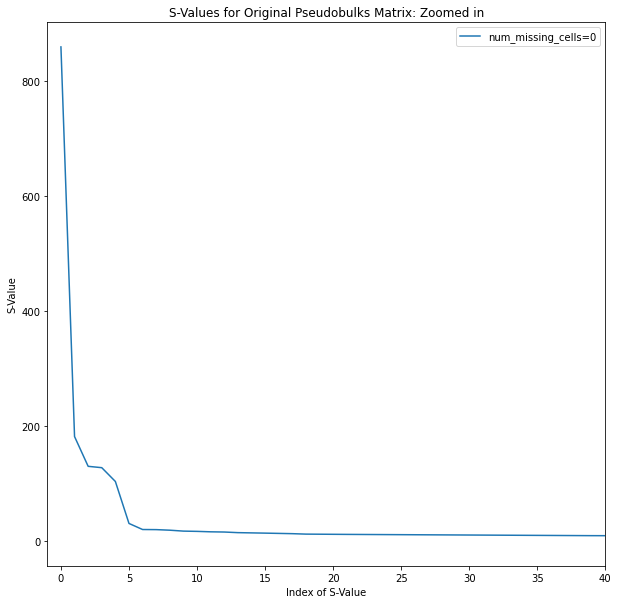

In [1608]:
###SVD on Pseudobulk##
num =0
plt.figure(figsize = [10,10])
# Create a color map
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
dataframe = pd.DataFrame(s_pseudo)
x = dataframe.index
y = dataframe.values.flatten()
color = color_map(num_missing_cells.index(num))
label = f"num_missing_cells={num}"
plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Original Pseudobulks Matrix: Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()
# Display the plot
plt.show()

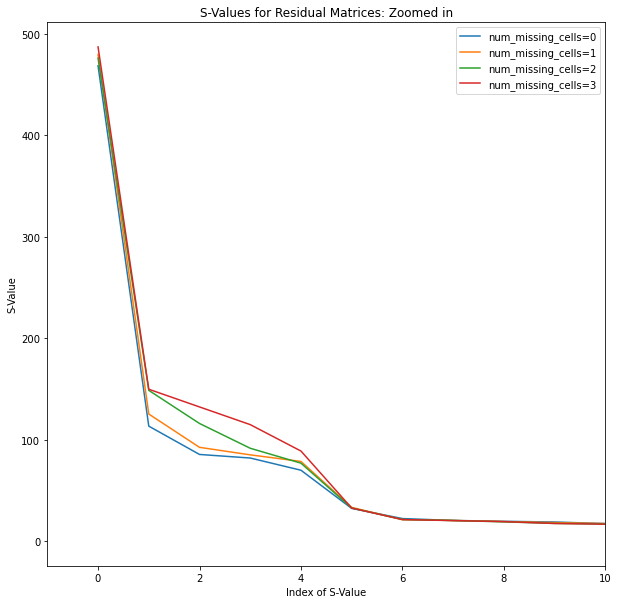

In [1609]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating num 
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)
# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

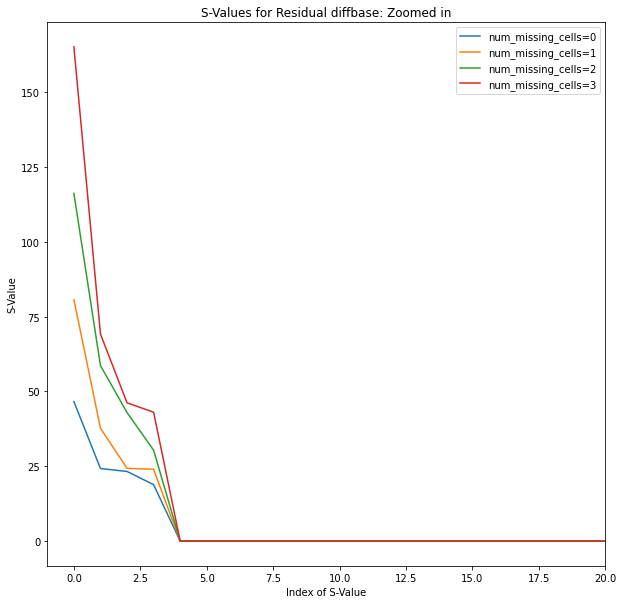

In [1610]:

plt.figure(figsize = [10,10])
# Create a color map for differentiating the num
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_diffbase[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)
# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual diffbase: Zoomed in')
plt.xlim([-1,20])
# Add a legend
plt.legend()
# Display the plot
plt.show()


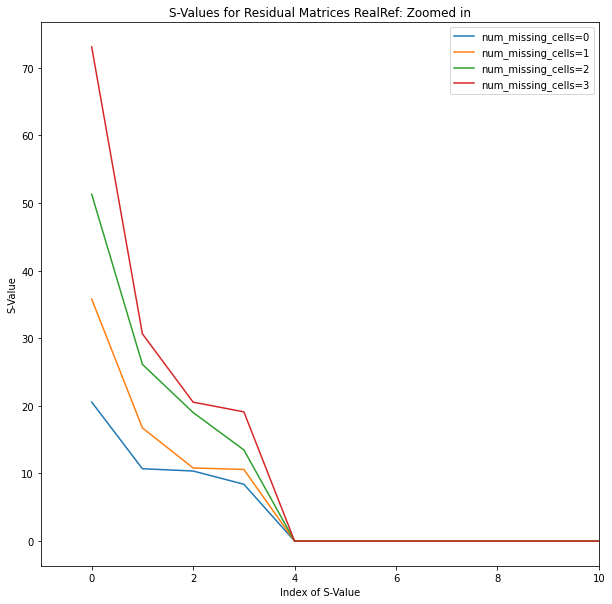

In [1611]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_realref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices RealRef: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

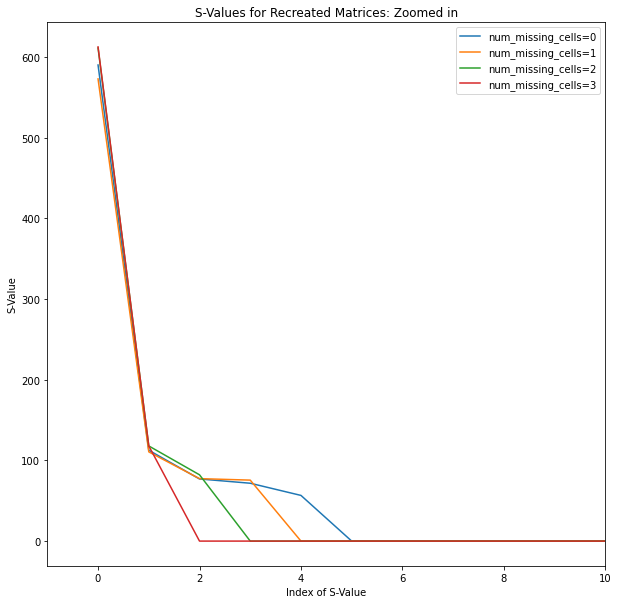

In [1612]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_rec[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Recreated Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

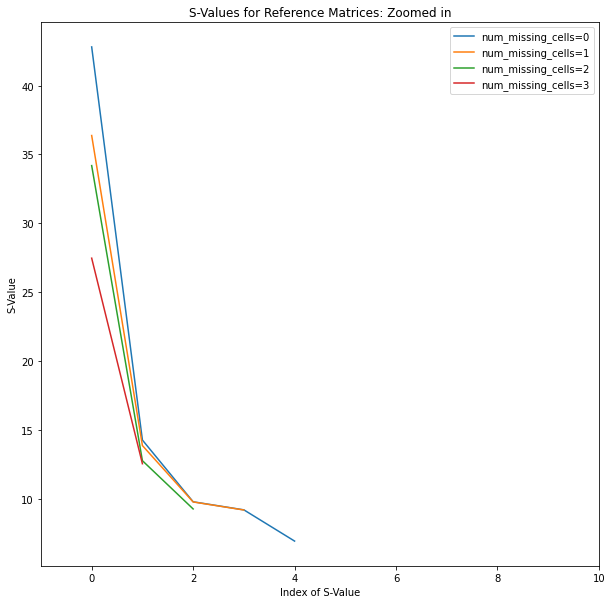

In [1613]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_ref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Reference Matrices: Zoomed in')
plt.xlim([-1,10])
# Add a legend
plt.legend()
# Display the plot
plt.show()

Extracting missing cell info:

In [1614]:
# Get the corresponding missing_cell_tot dataframe
missing_cell_exp_usedref = dict()
missing_cell_exp_usedref[0] = []
for num in num_cells_missing[1:]:
    missing_cell_exp_usedref[num] = all_refs[0][missing_cell_tot[num].columns]  
# and using the other reference
missing_cell_exp_avref = dict()
missing_cell_exp_avref[0] = []
for num in num_cells_missing[1:]:
    missing_cell_exp_avref[num] = all_refs_av[0][missing_cell_tot[num].columns]  

In [1615]:
# Get the corresponding missing_cell_proportions
missing_cell_prop = dict()
missing_cell_prop[0] = []
for num in num_cells_missing[1:]:
    missing_cell_prop[num] = prop_df[missing_cell_tot[num].columns]  

In [1616]:
#multiplying missing cell proportions * the missing cell expression ref.
missing_cell_usedexp_x_prop = dict()
missing_cell_usedexp_x_prop[0] = []
for num in num_cells_missing[1:]:
    missing_cell_exp_matrix = missing_cell_exp_usedref[num]  
    missing_cell_prop_matrix = missing_cell_prop[num]  
    #multiplication
    result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  
    #convert to dataframe
    missing_cell_usedexp_x_prop[num] = pd.DataFrame(result_matrix.T, columns = gene_ids)
missing_cell_usedexp_x_prop[1]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.044181,0.028759,0.025187,0.027557,0.0734,0.003472,0.028024,0.011383,0.032531,0.064645,...,0.018794,0.001502,0.0734,0.00015,0.033449,0.021264,0.025688,0.003372,0.010265,0.026238
1,0.343459,0.223566,0.195799,0.214224,0.5706,0.026989,0.217857,0.088492,0.252891,0.502538,...,0.146103,0.011678,0.5706,0.001168,0.260027,0.165307,0.199692,0.02621,0.079799,0.203973
2,0.072352,0.047095,0.041246,0.045127,0.1202,0.005685,0.045893,0.018641,0.053273,0.105862,...,0.030777,0.00246,0.1202,0.000246,0.054776,0.034823,0.042066,0.005521,0.01681,0.042968
3,0.204775,0.133293,0.116738,0.127723,0.3402,0.016091,0.12989,0.05276,0.150777,0.29962,...,0.087109,0.006963,0.3402,0.000696,0.155032,0.098558,0.119059,0.015627,0.047577,0.121612
4,0.099559,0.064805,0.056756,0.062097,0.1654,0.007823,0.06315,0.025651,0.073306,0.145671,...,0.042351,0.003385,0.1654,0.000339,0.075374,0.047918,0.057885,0.007598,0.023131,0.059126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.026726,0.017396,0.015236,0.016669,0.0444,0.0021,0.016952,0.006886,0.019678,0.039104,...,0.011369,0.000909,0.0444,0.000091,0.020233,0.012863,0.015539,0.002039,0.006209,0.015872
996,0.059591,0.038789,0.033971,0.037168,0.099,0.004683,0.037799,0.015354,0.043877,0.087191,...,0.025349,0.002026,0.099,0.000203,0.045115,0.028681,0.034647,0.004548,0.013845,0.03539
997,0.026726,0.017396,0.015236,0.016669,0.0444,0.0021,0.016952,0.006886,0.019678,0.039104,...,0.011369,0.000909,0.0444,0.000091,0.020233,0.012863,0.015539,0.002039,0.006209,0.015872
998,0.167456,0.109001,0.095463,0.104446,0.2782,0.013159,0.106218,0.043145,0.123299,0.245016,...,0.071234,0.005694,0.2782,0.000569,0.126778,0.080596,0.097361,0.012779,0.038906,0.099449


In [1617]:
#multiplying missing cell proportions * the missing cell average expression.
missing_cell_avexp_x_prop = dict()
missing_cell_avexp_x_prop[0] = []
for num in num_cells_missing[1:]:
    missing_cell_exp_matrix = missing_cell_exp_avref[num]  
    missing_cell_prop_matrix = missing_cell_prop[num]  
    #multiplication
    result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  
    #convert to dataframe
    missing_cell_avexp_x_prop[num] = pd.DataFrame(result_matrix.T, columns = gene_ids)
missing_cell_avexp_x_prop[1]    

,AATF,ABAT,ABCA10,ABCA8,ABCA9,ABCB1,ABCB10,ABCB4,ABCC3,ABCC4,...,ZNF808,ZNF831,ZNF846,ZNF860,ZNFX1,ZNRF1,ZRANB1,ZSCAN31,ZSWIM5,ZSWIM8
0,0.019503,0.01297,0.011721,0.012586,0.032579,0.001729,0.012682,0.0049,0.015276,0.029687,...,0.00807,0.000673,0.032579,0.000096,0.014795,0.009607,0.011625,0.001345,0.004227,0.011529
1,0.151612,0.100826,0.091117,0.097839,0.253262,0.013443,0.098585,0.03809,0.118751,0.230779,...,0.062736,0.005228,0.253262,0.000747,0.115016,0.074686,0.09037,0.010456,0.032862,0.089623
2,0.031938,0.02124,0.019194,0.02061,0.053351,0.002832,0.020768,0.008024,0.025015,0.048615,...,0.013216,0.001101,0.053351,0.000157,0.024229,0.015733,0.019037,0.002203,0.006923,0.01888
3,0.090394,0.060114,0.054325,0.058333,0.150998,0.008015,0.058778,0.02271,0.070801,0.137594,...,0.037404,0.003117,0.150998,0.000445,0.068574,0.044529,0.05388,0.006234,0.019593,0.053435
4,0.043948,0.029226,0.026412,0.02836,0.073413,0.003897,0.028577,0.011041,0.034422,0.066896,...,0.018185,0.001515,0.073413,0.000216,0.03334,0.021649,0.026196,0.003031,0.009526,0.025979
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.011797,0.007846,0.00709,0.007613,0.019707,0.001046,0.007671,0.002964,0.00924,0.017958,...,0.004882,0.000407,0.019707,0.000058,0.00895,0.005812,0.007032,0.000814,0.002557,0.006974
996,0.026305,0.017493,0.015809,0.016975,0.043941,0.002332,0.017105,0.006609,0.020603,0.040041,...,0.010885,0.000907,0.043941,0.00013,0.019956,0.012958,0.015679,0.001814,0.005702,0.01555
997,0.011797,0.007846,0.00709,0.007613,0.019707,0.001046,0.007671,0.002964,0.00924,0.017958,...,0.004882,0.000407,0.019707,0.000058,0.00895,0.005812,0.007032,0.000814,0.002557,0.006974
998,0.07392,0.049158,0.044425,0.047702,0.123479,0.006554,0.048066,0.018571,0.057898,0.112518,...,0.030587,0.002549,0.123479,0.000364,0.056077,0.036414,0.044061,0.005098,0.016022,0.043696


In [1618]:
#seprating into the individual cell types exp * prop used ref.
usedex_prop_individual = dict()
usedex_prop_individual[0] = []
for num in num_missing_cells[1:]:
    usedex_prop_individual[num] = dict()
    x = missing_cell_exp_usedref[num].T
    y = missing_cell_prop[num]
    for col_cell, row in x.iterrows():
        exp = row.values[:,None]
        prop = y[col_cell].values[:,None]
        # Perform matrix multiplication
        result_matrix = np.dot(exp, prop.T)   
        #convert to dataframe  
        usedex_prop_individual[num][col_cell] = pd.DataFrame(result_matrix.T, columns = gene_ids) 

In [1619]:
#seprating into the individual cell types exp * prop average ref.
avex_prop_individual = dict()
avex_prop_individual[0] = []
for num in num_missing_cells[1:]:
    avex_prop_individual[num] = dict()
    x = missing_cell_exp_avref[num].T
    y = missing_cell_prop[num]
    for col_cell, row in x.iterrows():
        exp = row.values[:,None]
        prop = y[col_cell].values[:,None]
        # Perform matrix multiplication
        result_matrix = np.dot(exp, prop.T)   
        #convert to dataframe  
        avex_prop_individual[num][col_cell] = pd.DataFrame(result_matrix.T, columns = gene_ids) 

**Reconstructing Residual Matrix**

With highly variable genes that match elbow S:

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


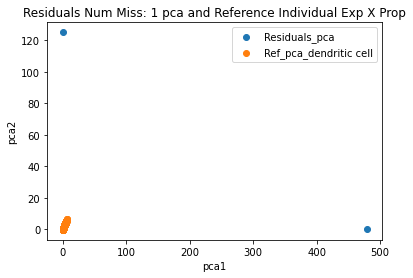

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


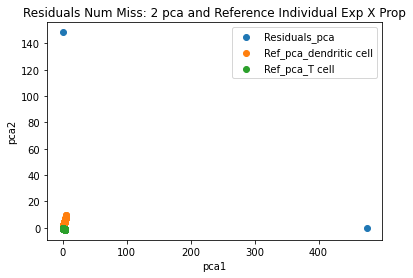

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


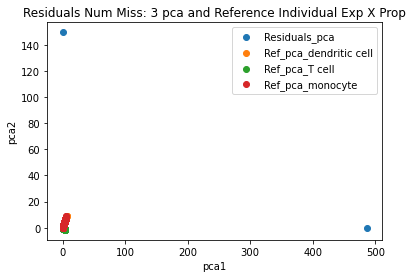

In [1620]:
#reconstructing SVD using all S values, Residual 1.
Recon_Mat_allS = dict()
for num in num_cells_missing:
    num_SVs = len(s_all[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


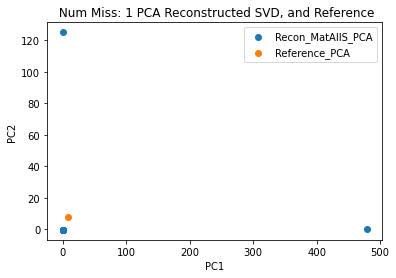

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


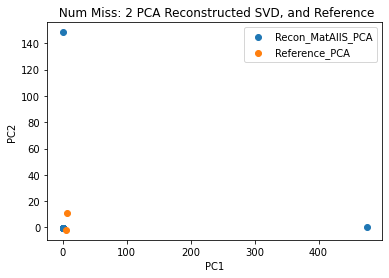

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


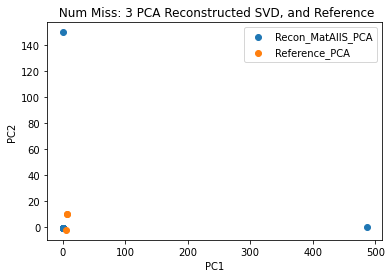

In [1621]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual 1
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


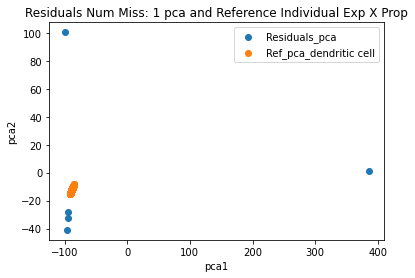

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


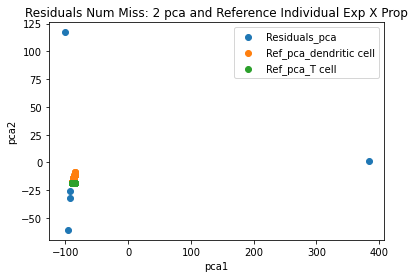

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


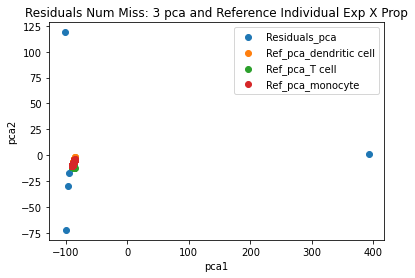

In [1622]:
#reconstructing SVD using all only some S values, Residual 1.
Recon_Mat_matchS = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()   

In [1623]:
#reconstructing Matrix with 1 S val, residual 1.
Recon_Mat_oneS = dict()
num_SVs = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
Recon_Mat_oneS[0]  

,0
0,-7.670194
1,4.882539
2,0.171733
3,1.005608
4,6.287641
...,...
3302,6.914674
3303,8.676322
3304,9.538431
3305,3.021558


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


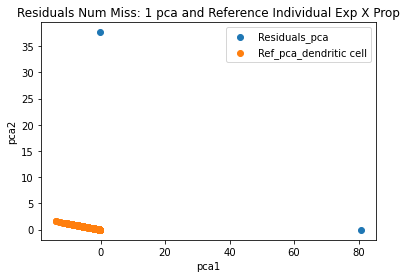

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


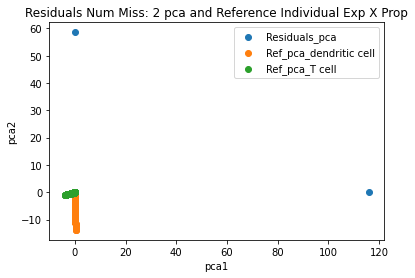

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


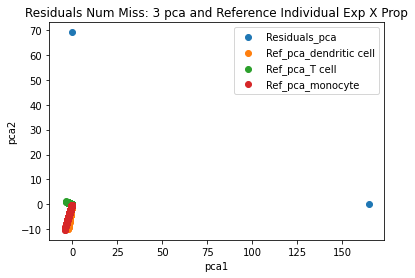

In [1624]:
#reconstructing Matrix with all S values, Residual Diffbase
Recon_Mat_allS_diffbase = dict()
for num in num_cells_missing:
    num_SVs = len(s_diffbase[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_diffbase[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS_diffbase[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_diffbase[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


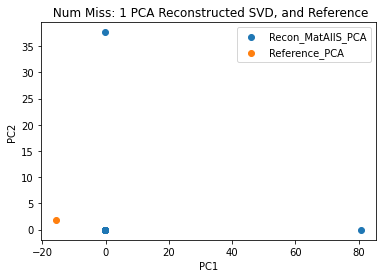

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


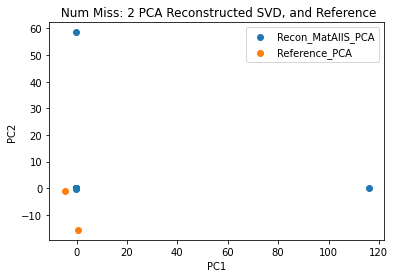

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


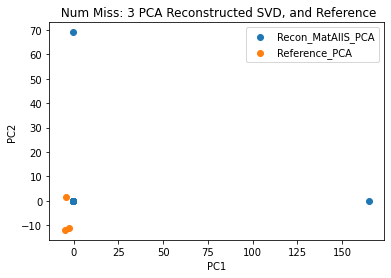

In [1625]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual diffbase
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_diffbase[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


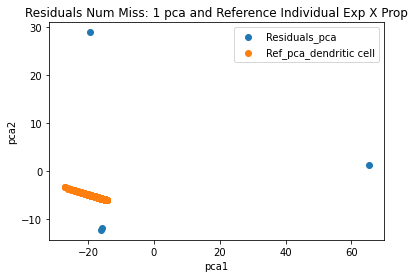

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


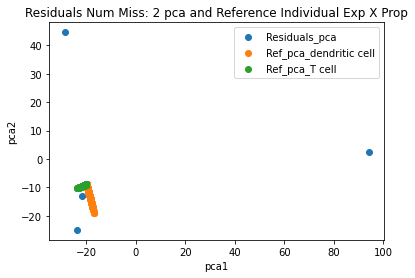

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


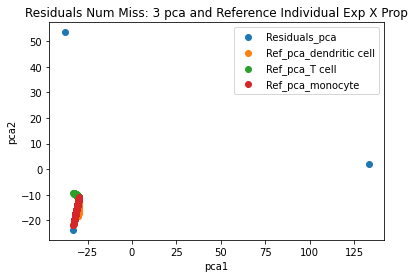

In [1626]:
#reconstructing Matrix with some S values, Residual Diffbase
Recon_Mat_matchS_diffbase = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_diffbase[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS_diffbase[num] = pd.DataFrame(anum[:, 0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS_diffbase[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

In [1627]:
#reconstructing Matrix with one S value, Residual Diffbase
Recon_Mat_oneS_diffbase = dict()
num_SV = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_diffbase[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_diffbase[num].shape[0]))
    diag_val = s_diffbase[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS_diffbase[num] = pd.DataFrame(anum[:,0:num_SV])
#QC    
Recon_Mat_oneS_diffbase[0]    

,0
0,-0.394490
1,-0.528848
2,0.655232
3,-0.245511
4,-1.063477
...,...
3302,-0.373344
3303,-0.025568
3304,-0.017822
3305,0.254903


/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


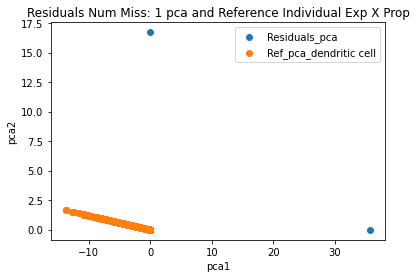

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


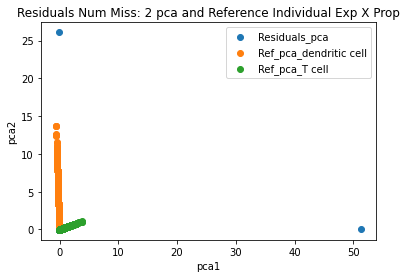

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


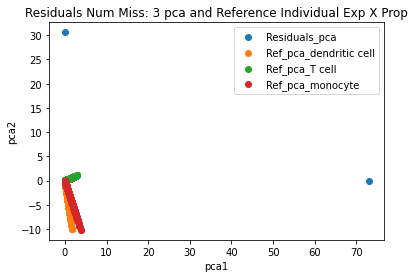

In [1628]:
#reconstructing Matrix with all S values, Residual Diffbase
Recon_Mat_allS_realref = dict()
for num in num_cells_missing:
    num_SVs = len(s_all_realref[num]) #num of cells
    #cutting S and U to 30 to all elbow plots
    U = U_all_realref[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])
    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_allS_realref[num] = pd.DataFrame(anum[:,0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_realref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


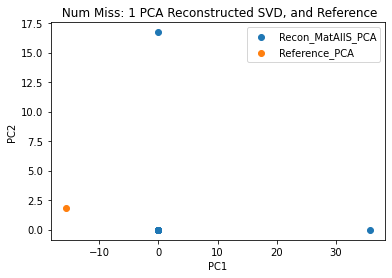

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


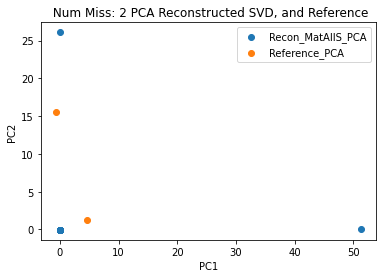

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


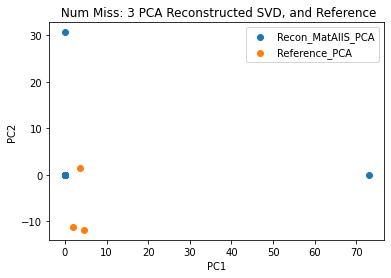

In [1629]:
#analyzing reconstructed matrix of all S values with missing cell exp.
#Residual realref
for num in num_cells_missing[1:]:
    pca = PCA(n_components = 2)
    pseudos_pca = pca.fit_transform(Recon_Mat_allS_realref[num].T)
    ref_pca = pca.transform(missing_cell_exp_usedref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Recon_MatAllS_PCA" )
    plt.scatter(ref_pca[:,0], ref_pca[:,1], label = "Reference_PCA" )
    plt.title(f" Num Miss: {num} PCA Reconstructed SVD, and Reference")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


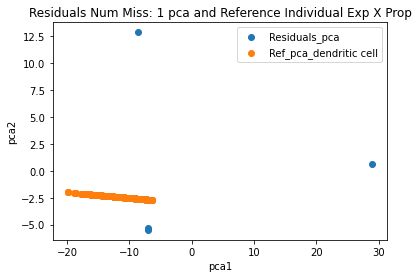

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


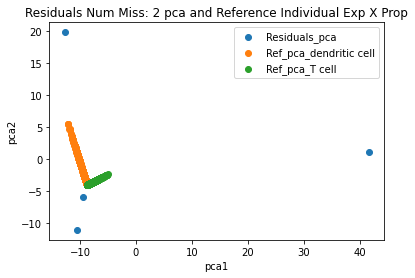

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


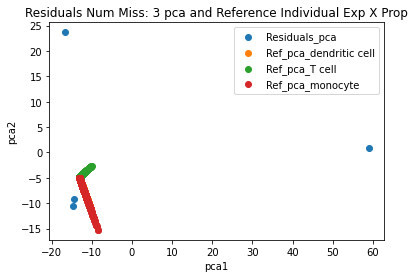

In [1630]:
#reconstructing Matrix with some S values, Residual Diffbase
Recon_Mat_matchS_realref = dict()
for num in num_cells_missing:
    num_SVs = 5 #num of cells
    #cutting S and U to 30 to match elbow plots
    U = U_all_realref[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS_realref[num] = pd.DataFrame(anum[:, 0:num_SVs])
#QC    
#PCA plot of reconstructed matrix with the missig cell type expression X proportions
for num in num_missing_cells[1:]:
    cells_dict =  usedex_prop_individual[num]
    pca = PCA(n_components=2)
    pseudos_pca = pca.fit_transform(Recon_Mat_matchS_realref[num].T)
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_pca" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_pca_{cell}" )
    plt.title(f"Residuals Num Miss: {num} pca and Reference Individual Exp X Prop")
    plt.xlabel("pca1")
    plt.ylabel("pca2")
    plt.legend()
    plt.show() 

In [1631]:
#reconstructing Matrix with one S values, Residual Diffbase
Recon_Mat_oneS_realref = dict()
num_SV = 1
for num in num_cells_missing:
    #cutting S and U to 30 to one elbow plots
    U = U_all_realref[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_all_realref[num].shape[0]))
    diag_val = s_all_realref[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS_realref[num] = pd.DataFrame(anum[:,0:num_SV])
#QC    
Recon_Mat_oneS_realref[0]    

,0
0,-0.163465
1,-0.236588
2,0.305604
3,-0.089341
4,-0.433537
...,...
3302,-0.176548
3303,-0.003704
3304,-0.003840
3305,0.099612


**Plotting Correlations between SVD on Residual and Missing Cell Information:**

**Residual:** 

One S:

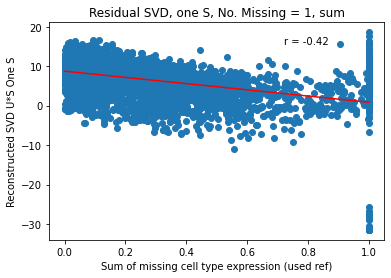

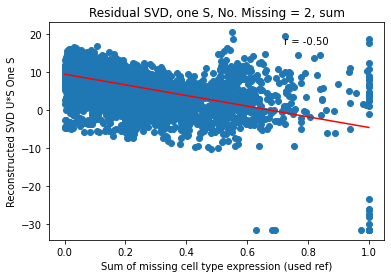

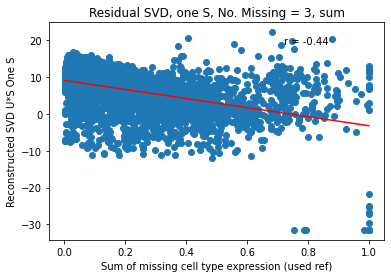

In [1632]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

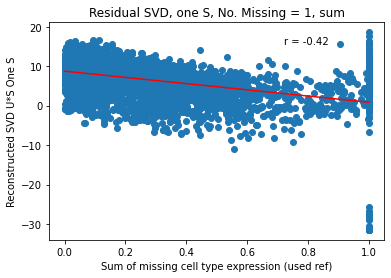

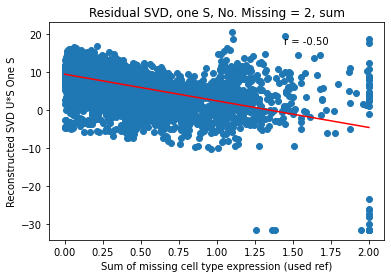

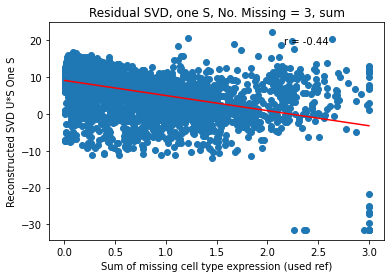

In [1633]:
#one S value with sum of expression of missing cell types. Used Reference.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

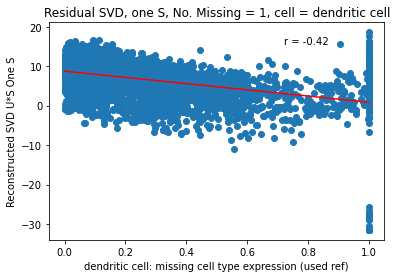

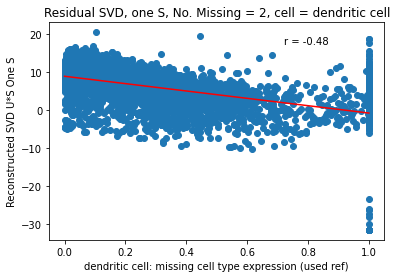

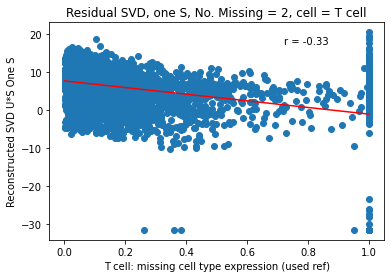

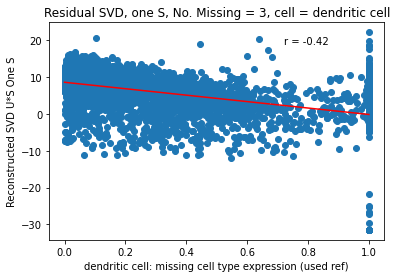

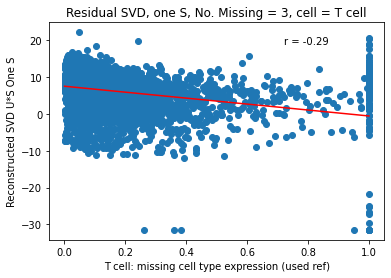

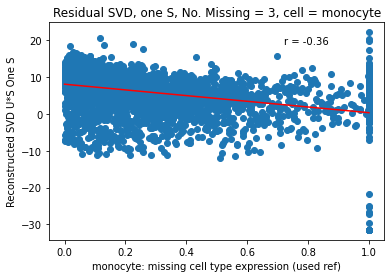

In [1635]:
#Each missing cell expression seprately, used ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num][0].values
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

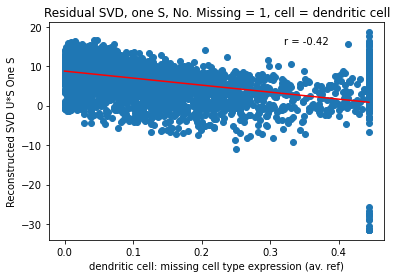

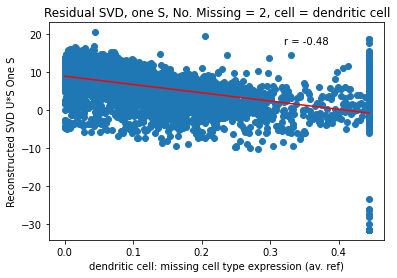

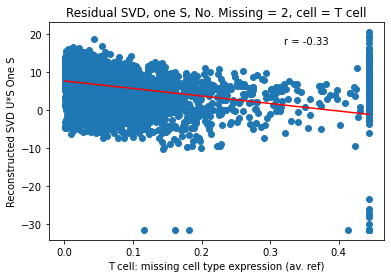

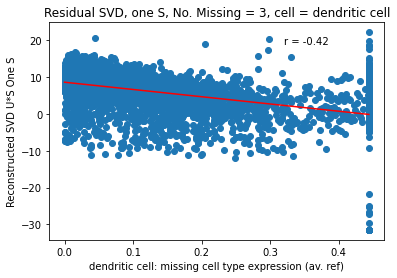

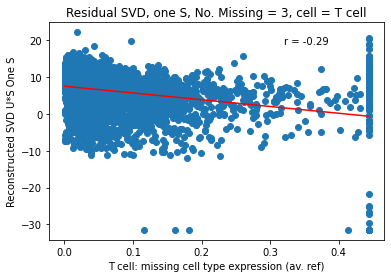

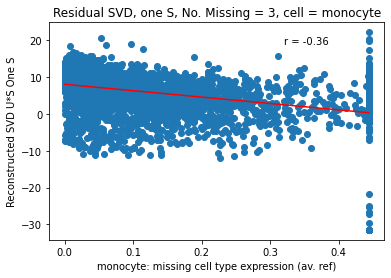

In [1636]:
#Each missing cell expression seprately, average ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num][0].values
    for col in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (av. ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

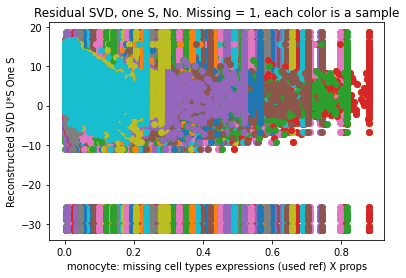

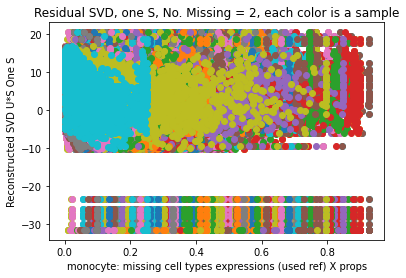

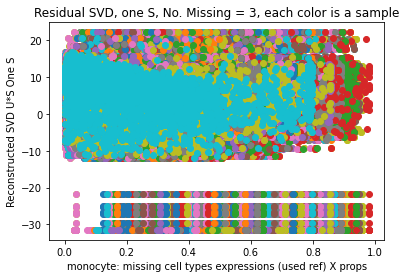

In [1638]:
#Recon_mat with one S, with each sample in missing cell exp X prop, used. ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS[num]
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each row is a sample
        x = row
        plt.scatter(x,y)
    plt.title(f'Residual SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (used ref) X props')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.show()

Match S:

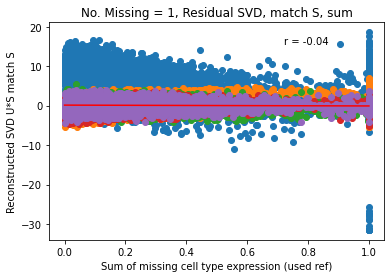

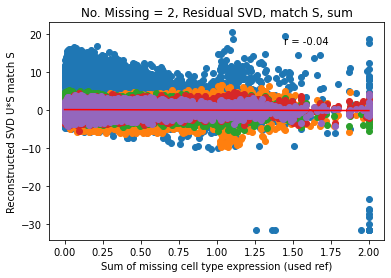

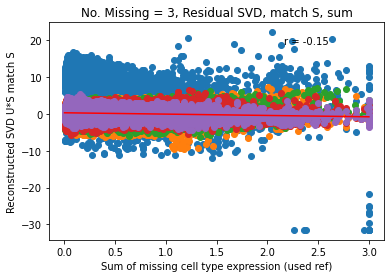

In [1641]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

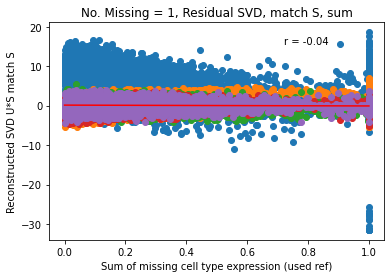

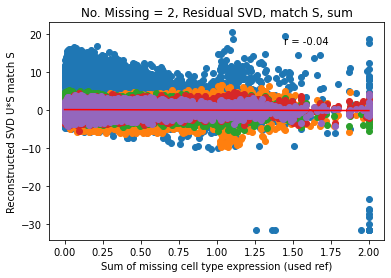

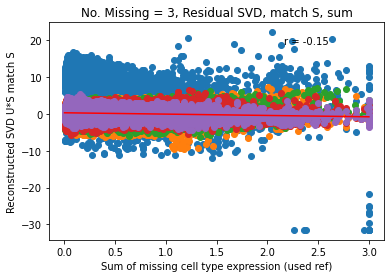

In [1642]:
#sum expr. used
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()


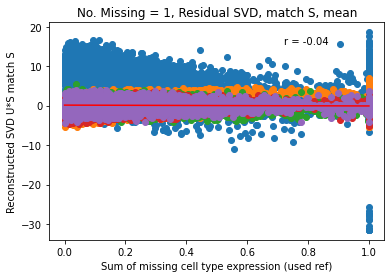

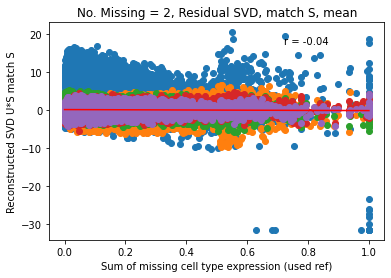

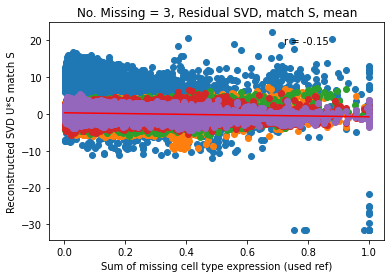

In [1643]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

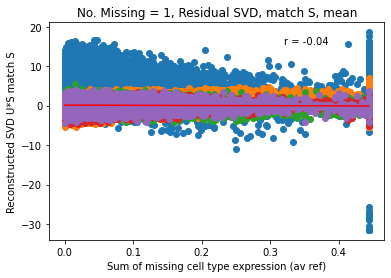

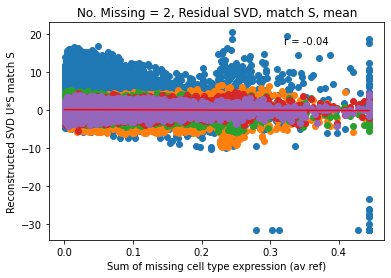

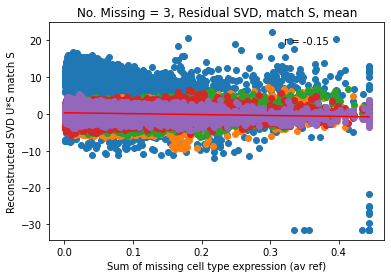

In [1644]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS[num].columns:
        y = Recon_Mat_matchS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

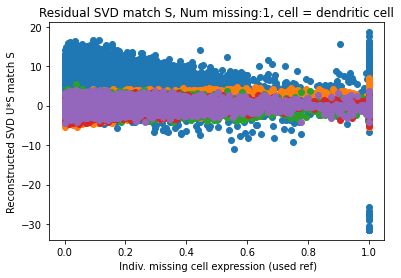

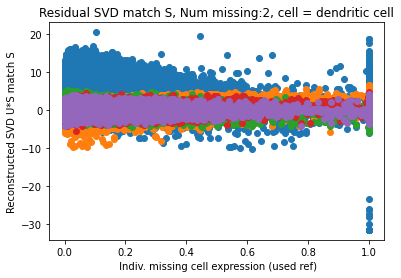

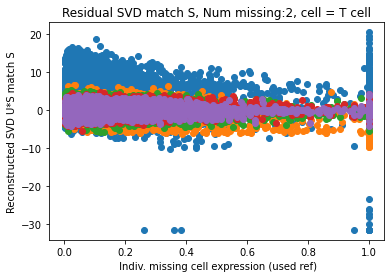

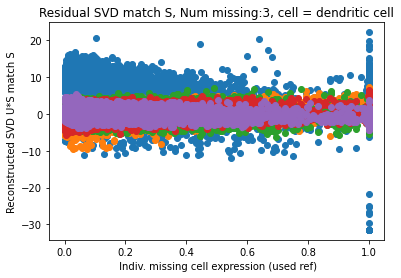

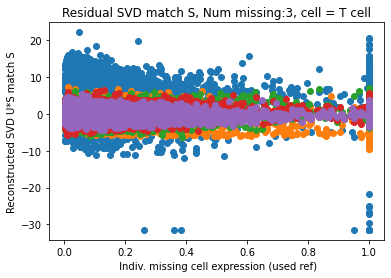

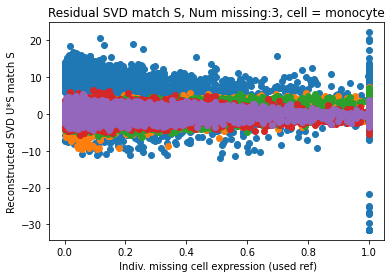

In [1645]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()            

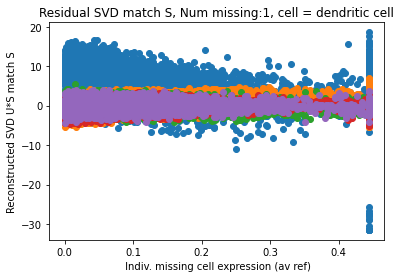

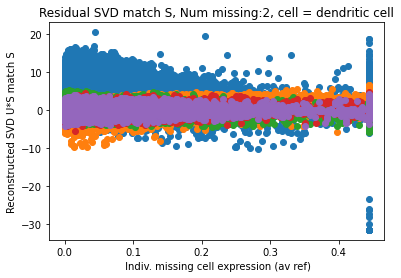

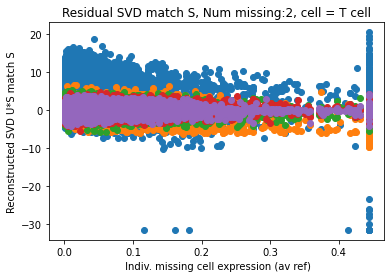

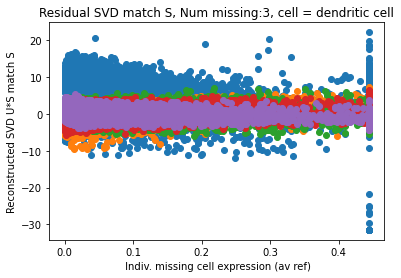

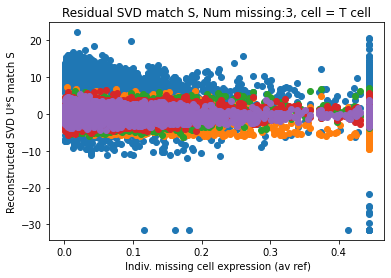

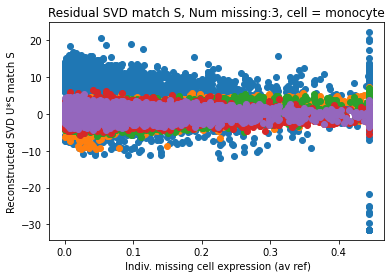

In [1646]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

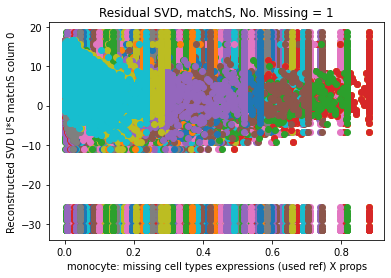

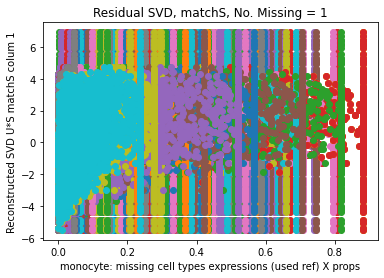

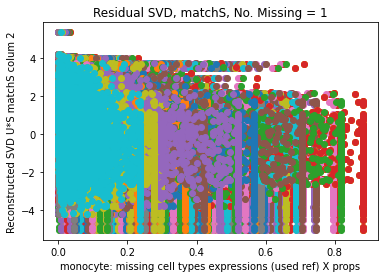

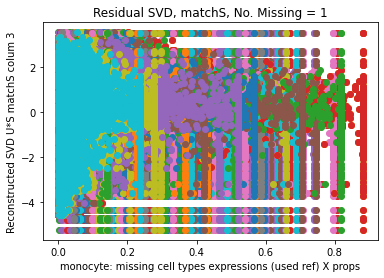

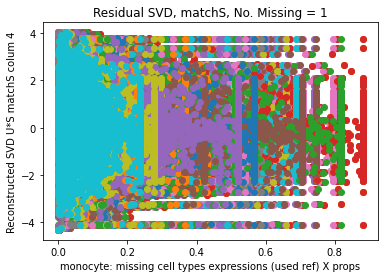

...

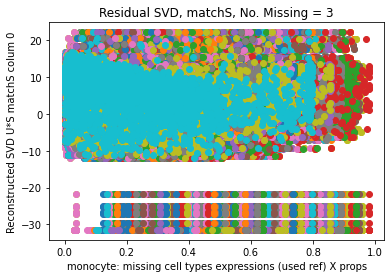

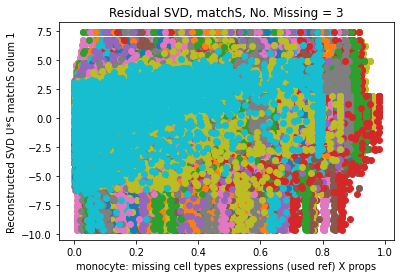

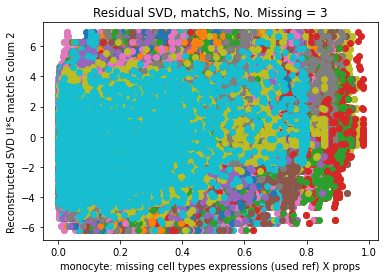

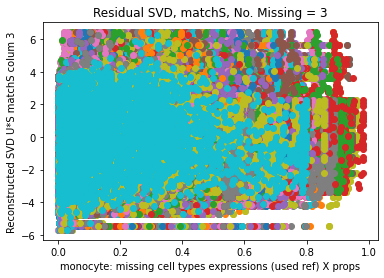

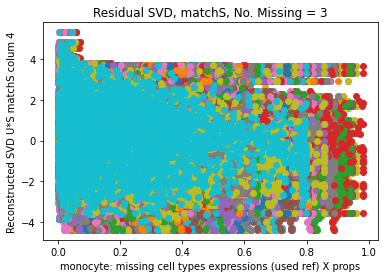

In [1647]:
#Each column in Recon_mat with each sample in missing cell used exp * prop
for num in num_missing_cells[1:]:
    for column in Recon_Mat_matchS[num].columns: 
        y = Recon_Mat_matchS[num][column] #each column
        for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #per sample
            x = row.values
            plt.scatter(x,y)
        plt.title(f'Residual SVD, matchS, No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell types expressions (used ref) X props')
        plt.ylabel(f"Reconstructed SVD U*S matchS colum {column}")
        plt.show()

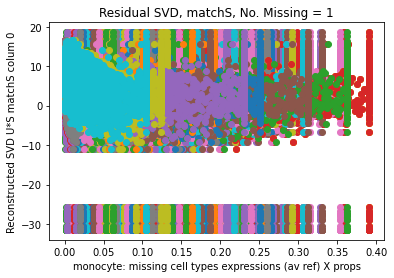

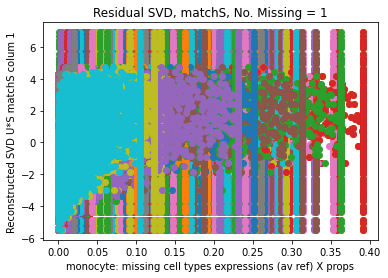

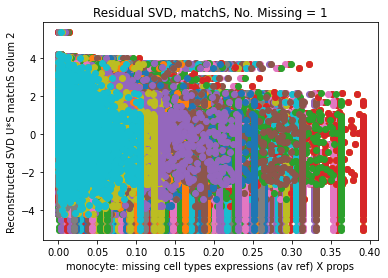

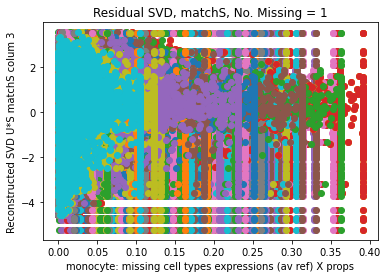

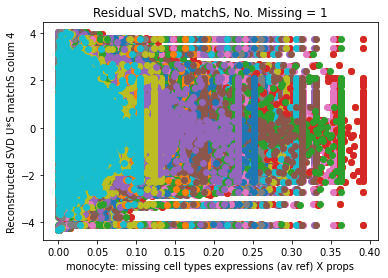

...

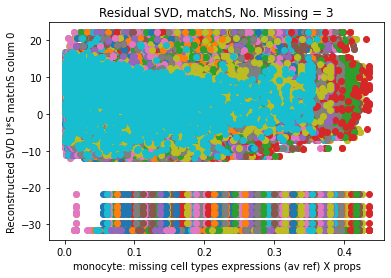

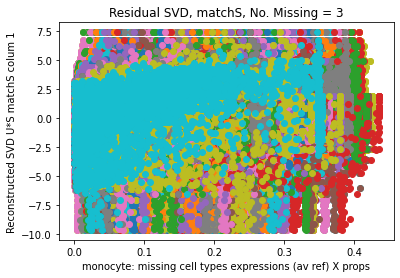

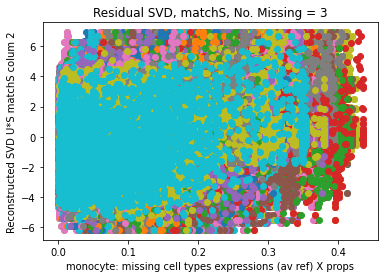

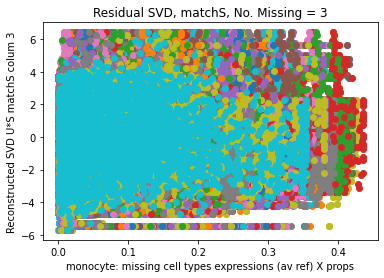

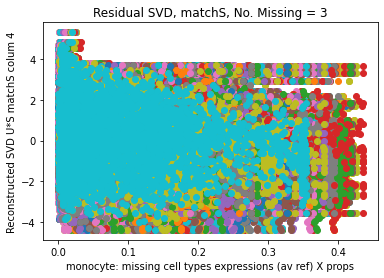

In [1648]:
#Each column in Recon_mat with each sample in missing cell av exp * prop
for num in num_missing_cells[1:]:
    for column in Recon_Mat_matchS[num].columns: 
        y = Recon_Mat_matchS[num][column] #each column
        for index,row in missing_cell_avexp_x_prop[num].iterrows(): #per sample
            x = row.values
            plt.scatter(x,y)
        plt.title(f'Residual SVD, matchS, No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
        plt.ylabel(f"Reconstructed SVD U*S matchS colum {column}")
        plt.show()

All S:

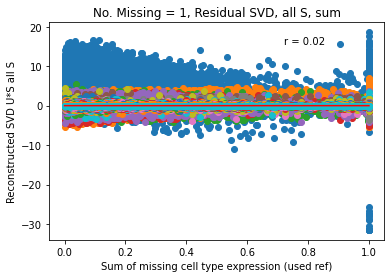

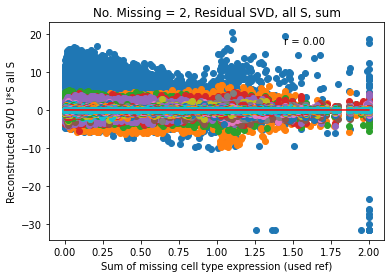

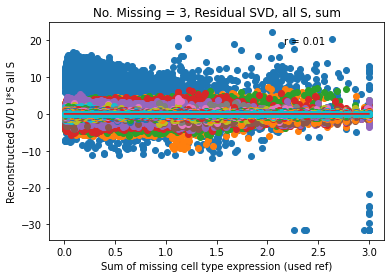

In [1649]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

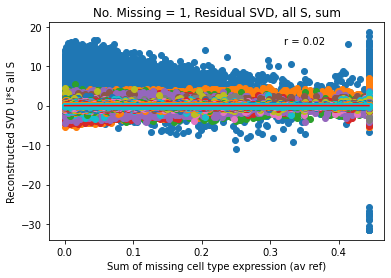

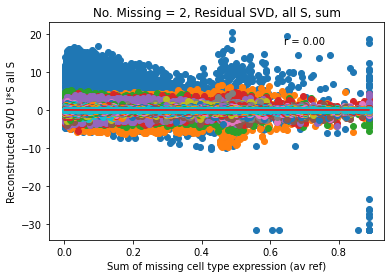

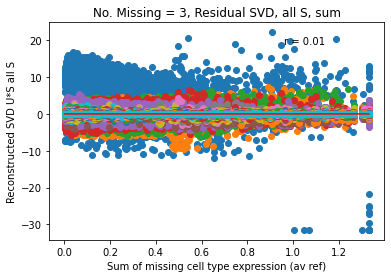

In [1650]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

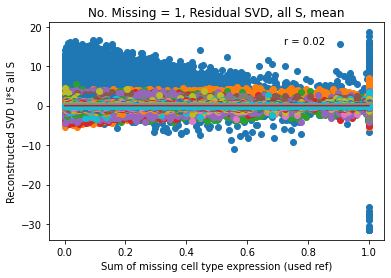

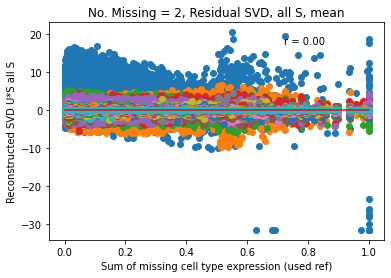

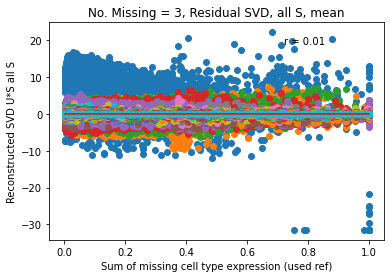

In [1651]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

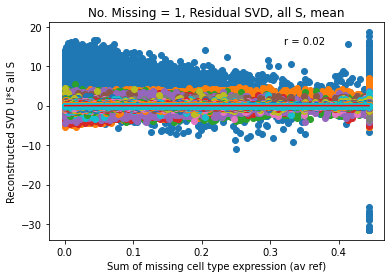

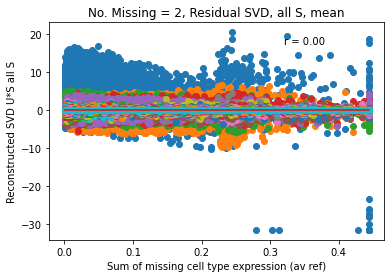

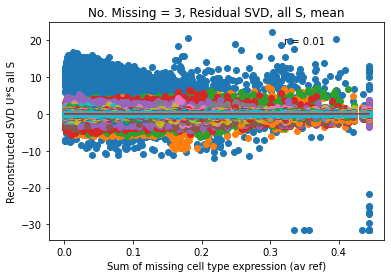

In [1652]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS[num].columns:
        y = Recon_Mat_allS[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

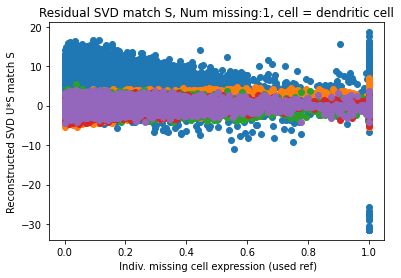

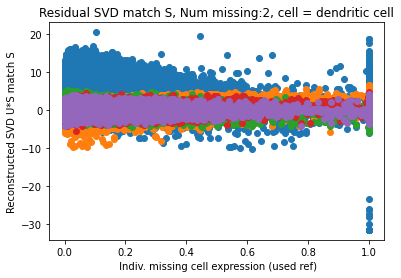

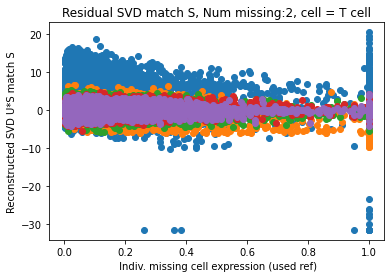

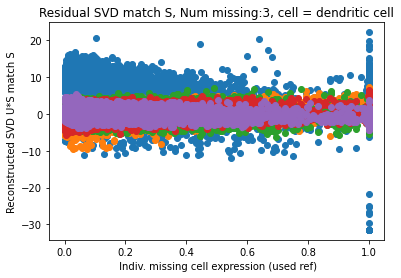

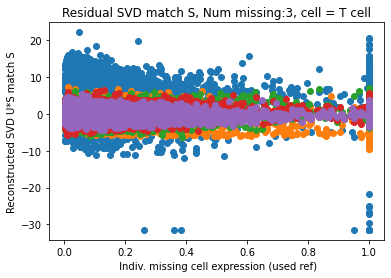

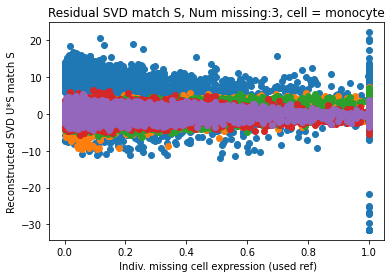

In [1653]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()            

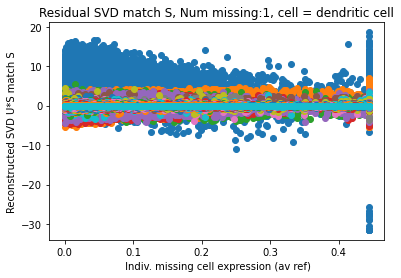

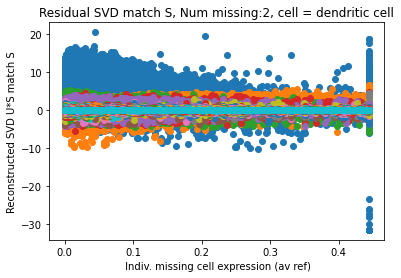

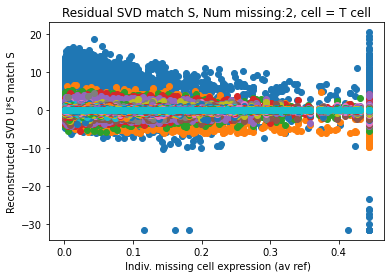

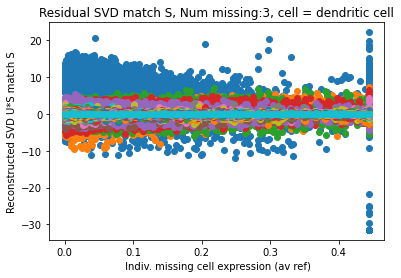

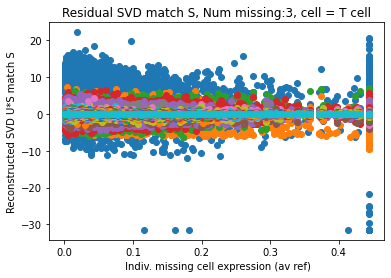

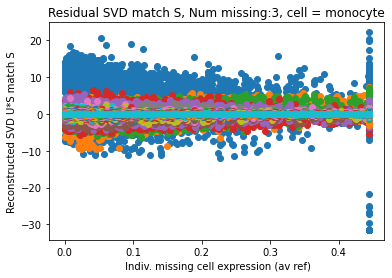

In [1654]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_allS[num].columns:
            y = Recon_Mat_allS[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

**Residual Diffbase**

One S:

In [ ]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS_diffbase[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

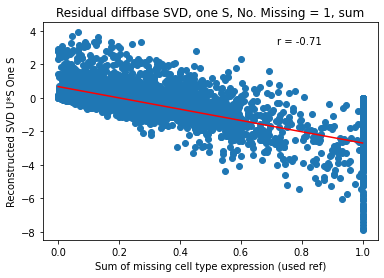

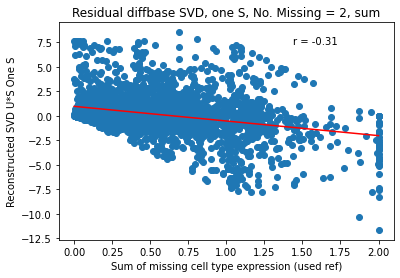

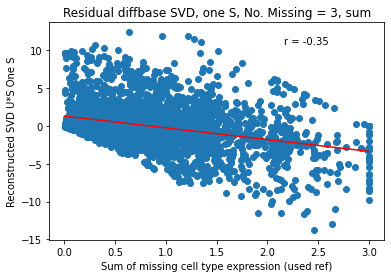

In [1657]:
#one S value with sum expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS_diffbase[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

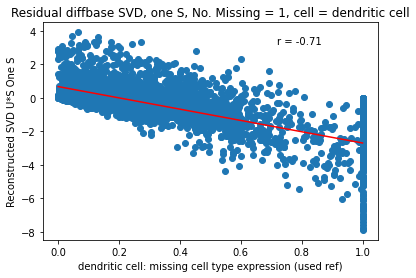

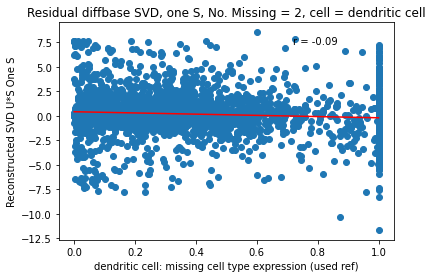

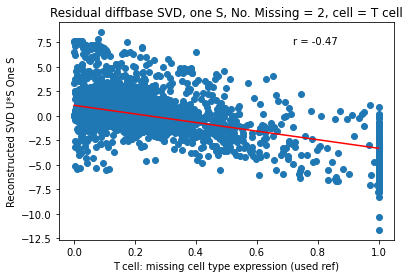

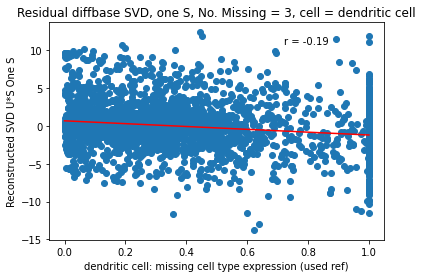

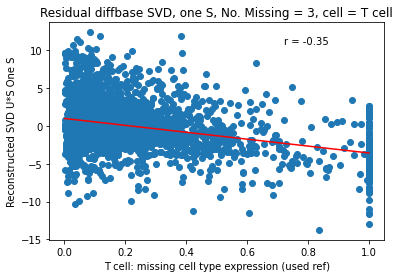

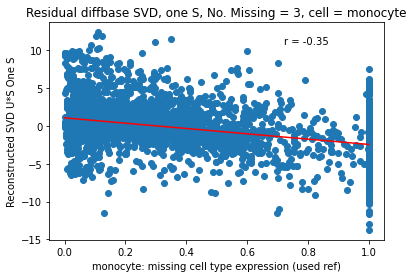

In [1660]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        y = Recon_Mat_oneS_diffbase[num][0].values
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

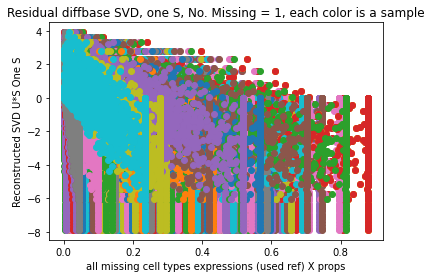

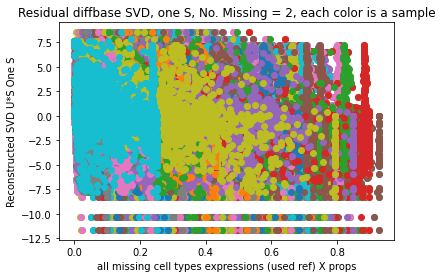

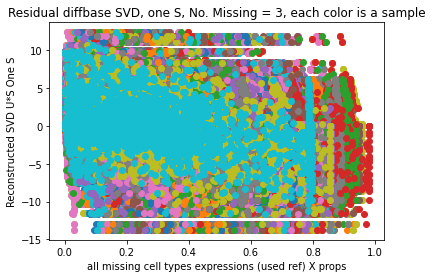

In [1662]:
#Recon_mat with one S, with each sample in each individual missing cell exp X prop, used. ref.
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS_diffbase[num]
    for index,row in missing_cell_usedexp_x_prop[num].iterrows():
        x = row
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'all missing cell types expressions (used ref) X props')
    plt.ylabel(f"Reconstructed SVD U*S One S")  
    plt.show()

Match S:

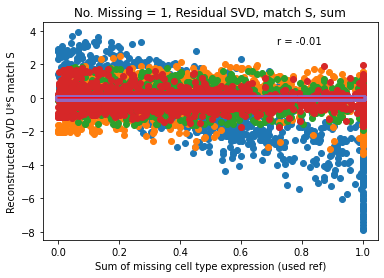

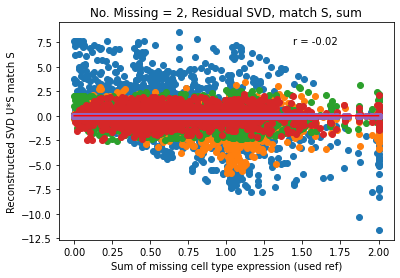

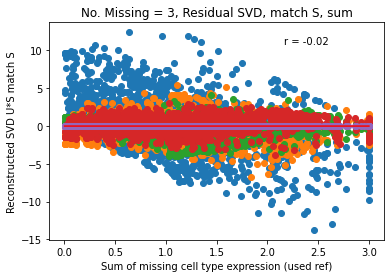

In [1665]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_diffbase[num].columns:
        y = Recon_Mat_matchS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

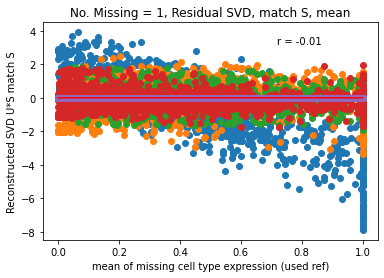

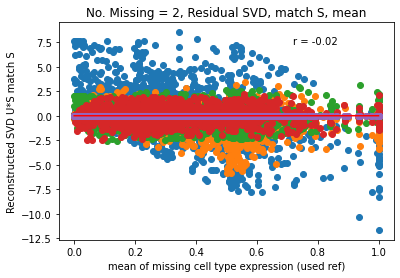

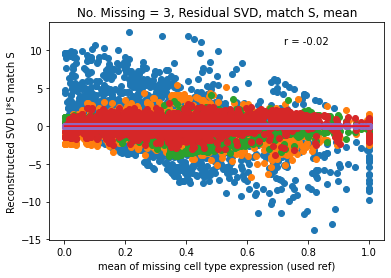

In [1667]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_diffbase[num].columns:
        y = Recon_Mat_matchS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

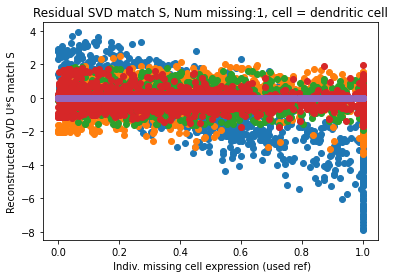

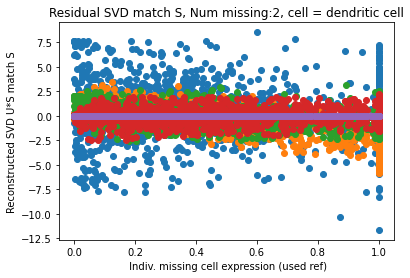

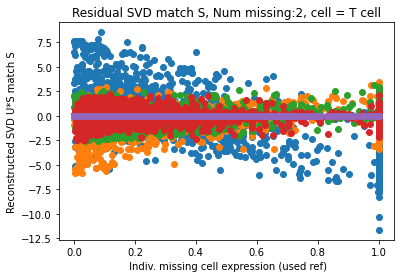

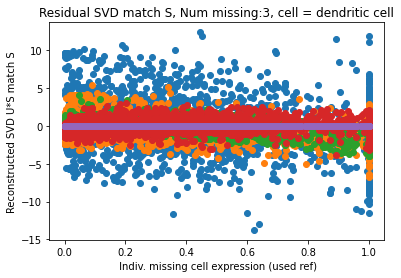

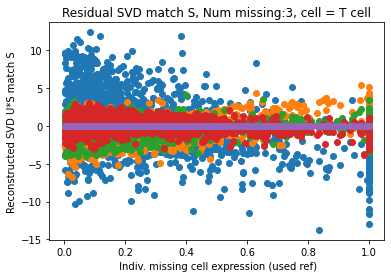

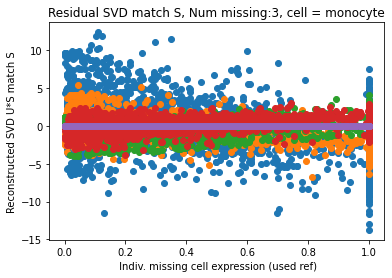

In [1669]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS_diffbase[num].columns:
            y = Recon_Mat_matchS_diffbase[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()           

All S:

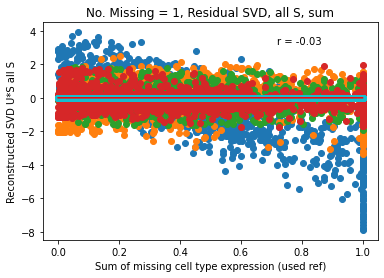

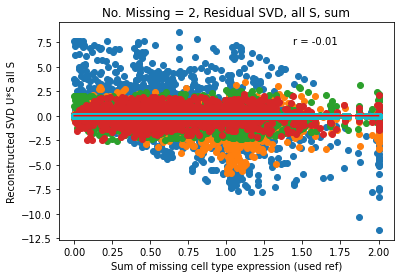

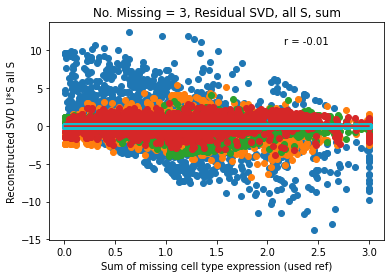

In [1675]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

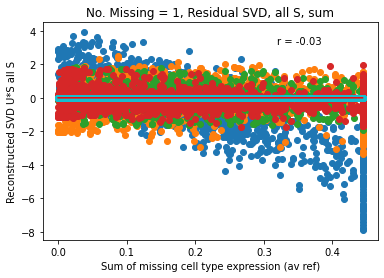

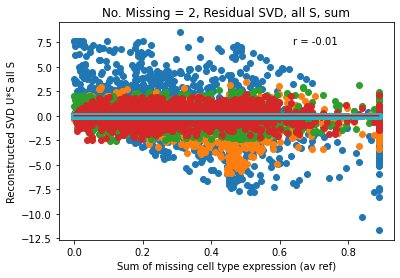

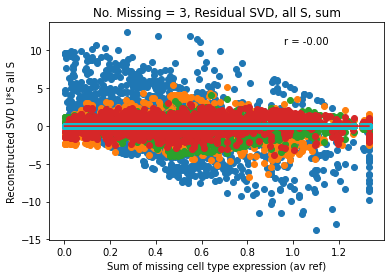

In [1676]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

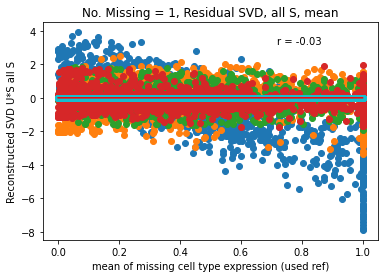

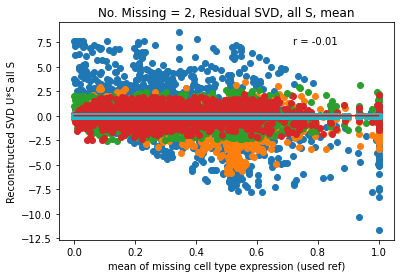

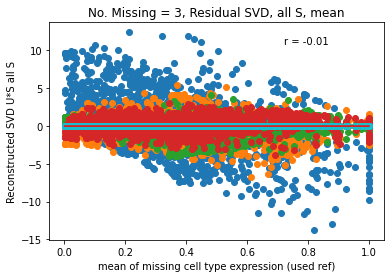

In [1677]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

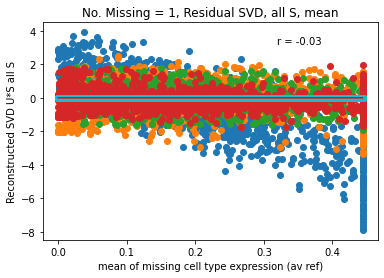

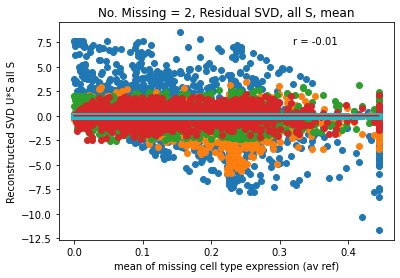

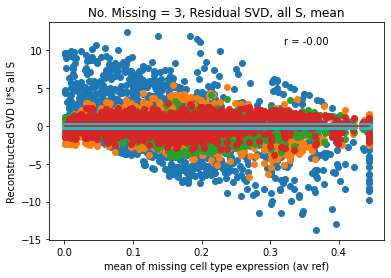

In [1678]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_diffbase[num].columns:
        y = Recon_Mat_allS_diffbase[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

**Residual RealRef**

One S:

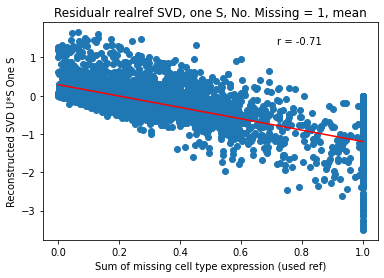

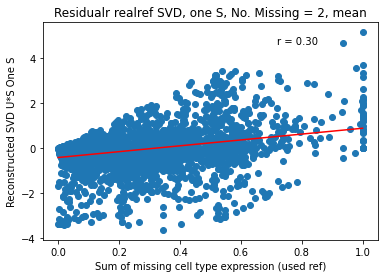

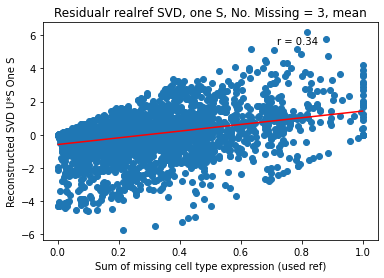

In [1673]:
#one S value with mean expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    y = Recon_Mat_oneS_realref[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residualr realref SVD, one S, No. Missing = {num}, mean')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

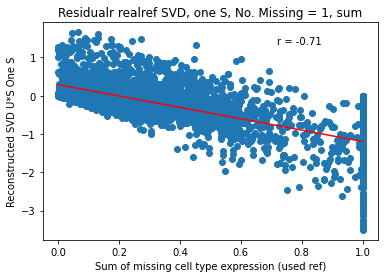

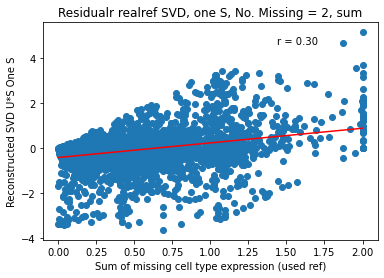

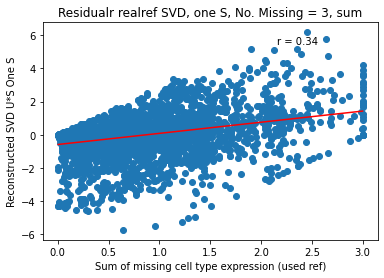

In [1674]:
#one S value with sum expression of missing cell types.
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    y = Recon_Mat_oneS_realref[num][0].values
    plt.scatter(x,y)
    plt.title(f'Residualr realref SVD, one S, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S One S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

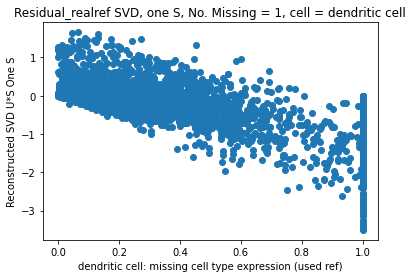

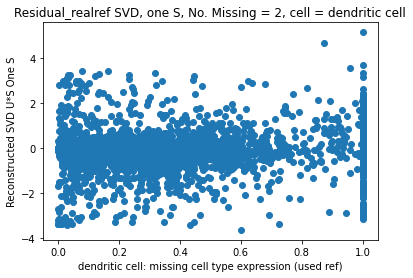

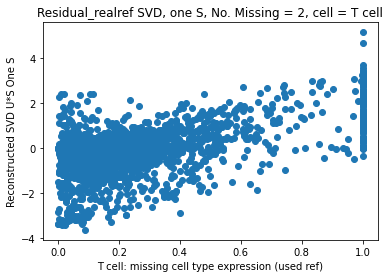

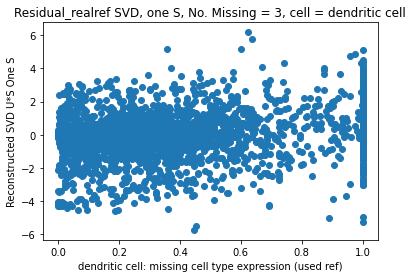

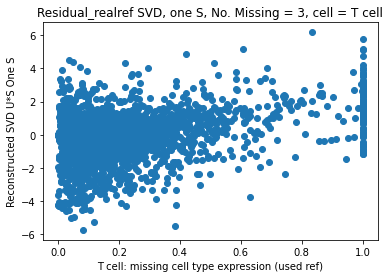

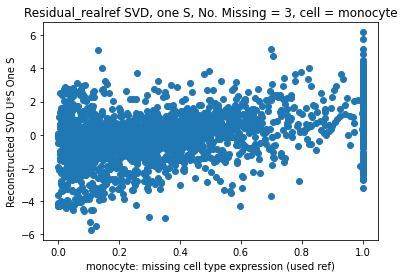

In [1680]:
#one S SVD with each individual missing cell used reference expression
for num in num_missing_cells[1:]:
    y = Recon_Mat_oneS_realref[num]
    for col in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][col].values
        plt.scatter(x,y)
        plt.title(f'Residual_realref SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S One S")
        plt.show()

Match S:

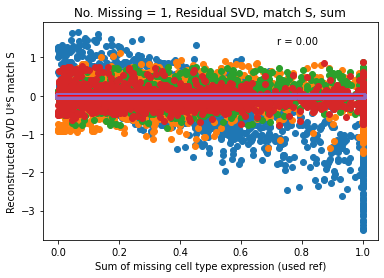

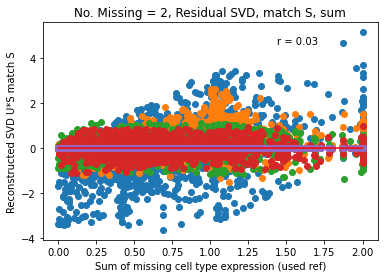

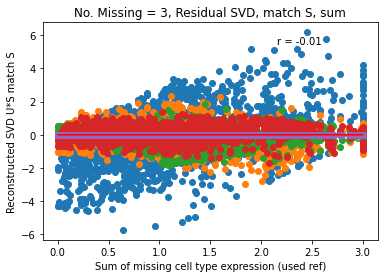

In [1683]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show() 

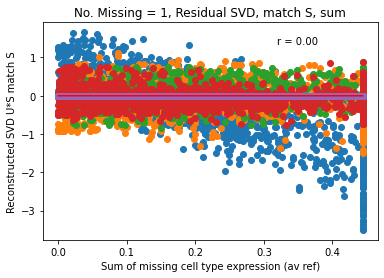

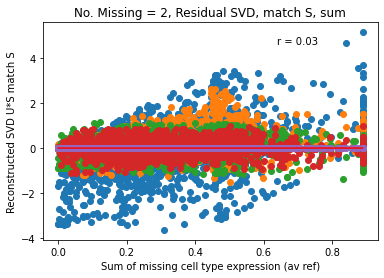

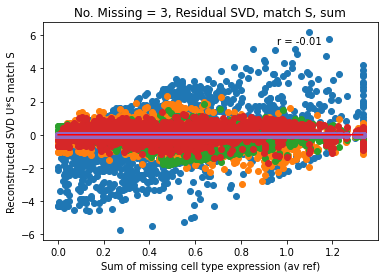

In [1684]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

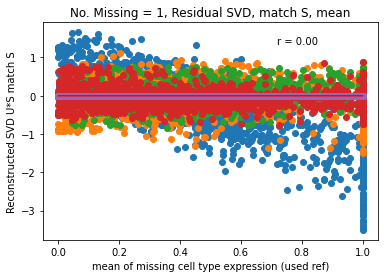

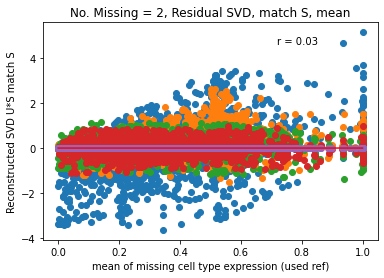

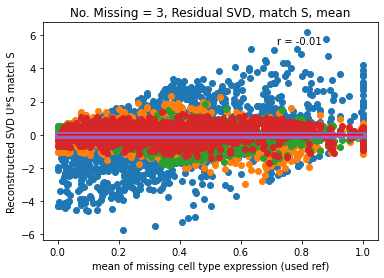

In [1685]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

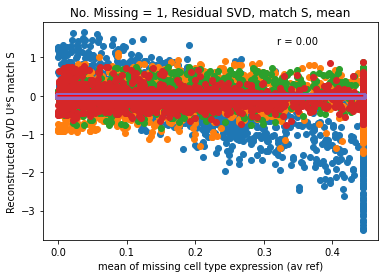

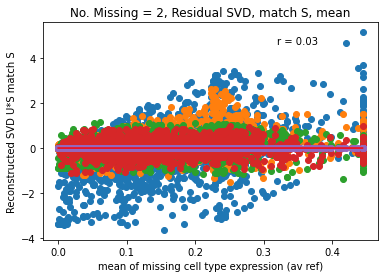

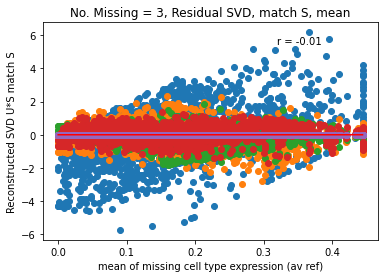

In [1686]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_matchS_realref[num].columns:
        y = Recon_Mat_matchS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

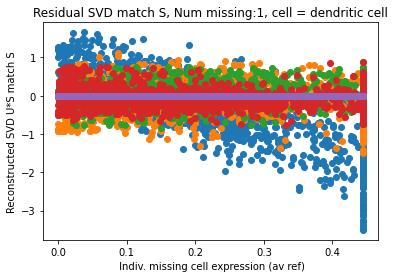

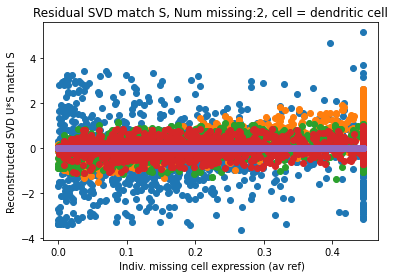

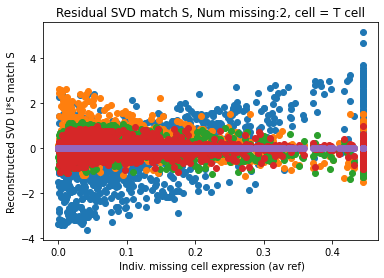

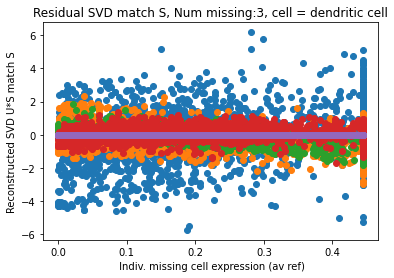

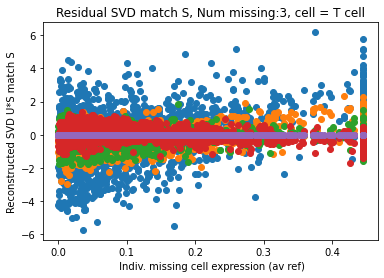

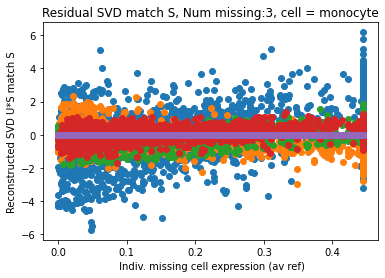

In [1687]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_matchS_realref[num].columns:
            y = Recon_Mat_matchS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

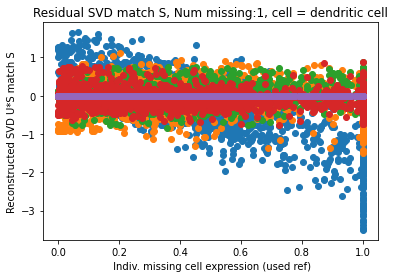

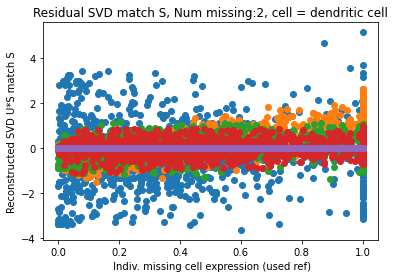

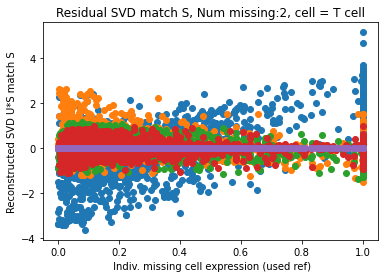

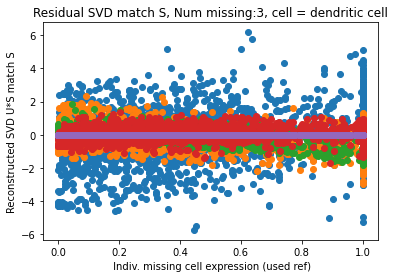

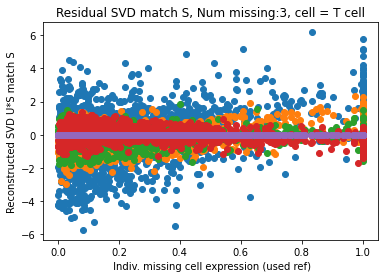

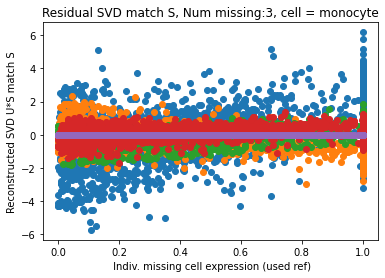

In [1688]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_matchS_realref[num].columns:
            y = Recon_Mat_matchS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD match S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S match S")
        plt.show()   

All S:

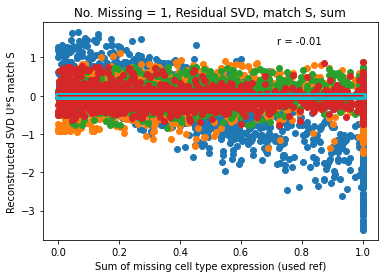

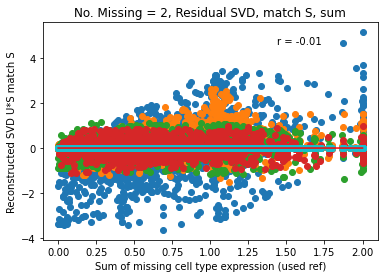

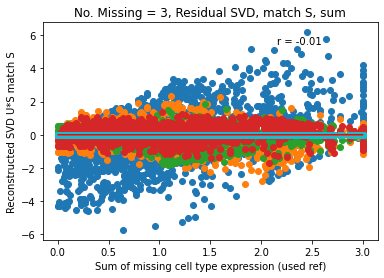

In [1690]:
#sum expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

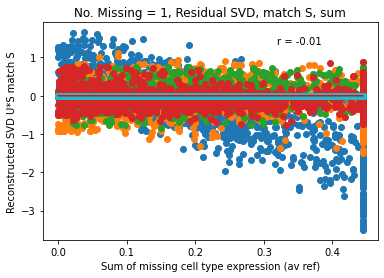

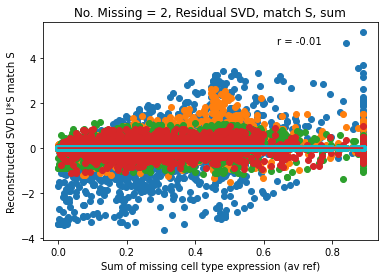

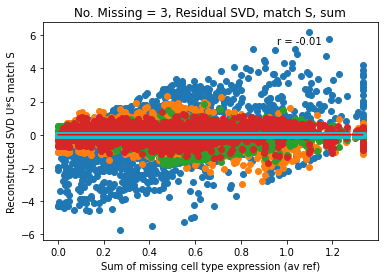

In [1691]:
#sum expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, match S, sum')
    plt.xlabel(f'Sum of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S match S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

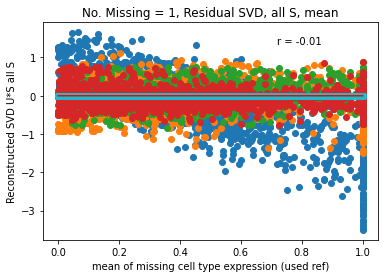

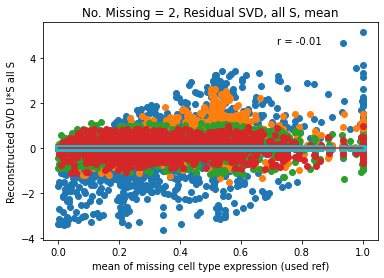

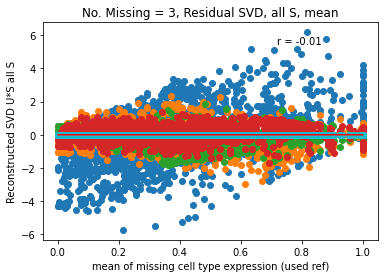

In [1692]:
#mean expression across cell types of used reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (used ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

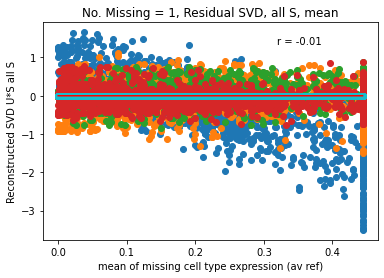

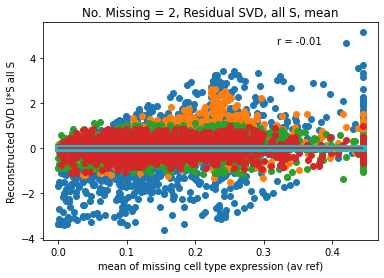

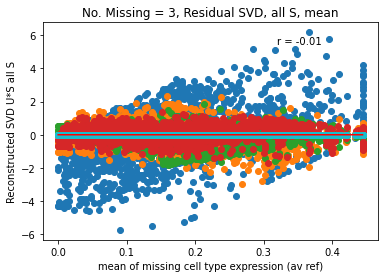

In [1693]:
#mean expression across cell types of av reference
#against each column of SVD reconstructed matrix
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].mean(axis=1).values
    for cellcol in Recon_Mat_allS_realref[num].columns:
        y = Recon_Mat_allS_realref[num][cellcol]
        plt.scatter(x,y)
    plt.title(f'No. Missing = {num}, Residual SVD, all S, mean')
    plt.xlabel(f'mean of missing cell type expression (av ref)')
    plt.ylabel(f"Reconstructed SVD U*S all S")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()   

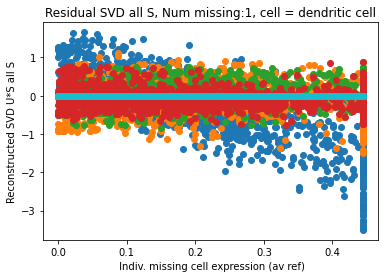

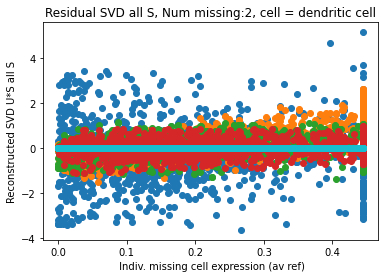

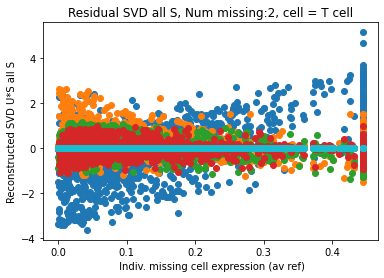

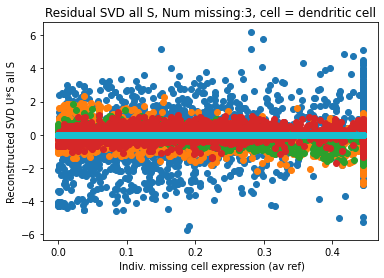

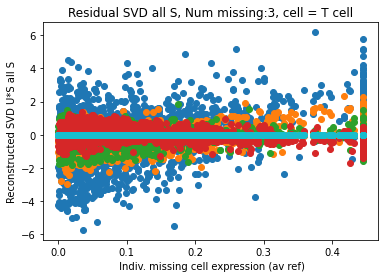

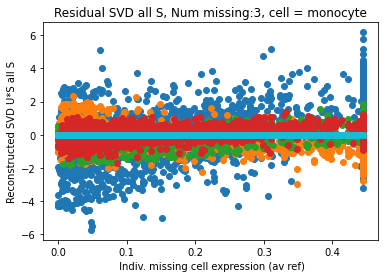

In [1694]:
#Each cell type average expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_avref[num].columns:
        x = missing_cell_exp_avref[num][cell]
        for sval in Recon_Mat_allS_realref[num].columns:
            y = Recon_Mat_allS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD all S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (av ref)')
        plt.ylabel(f"Reconstructed SVD U*S all S")
        plt.show()   

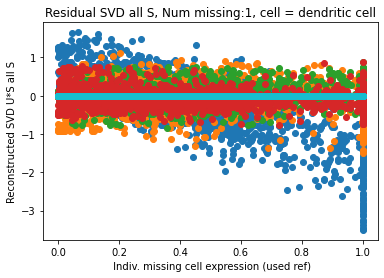

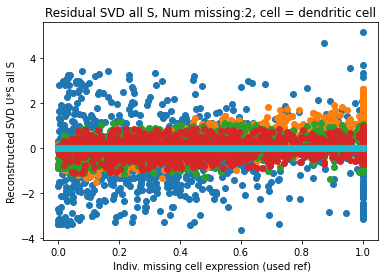

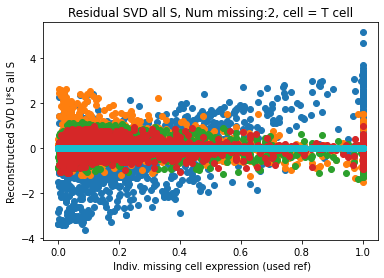

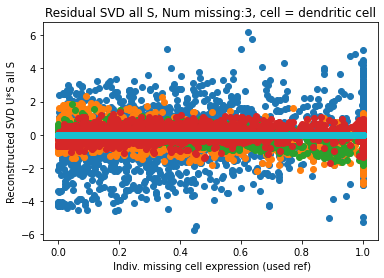

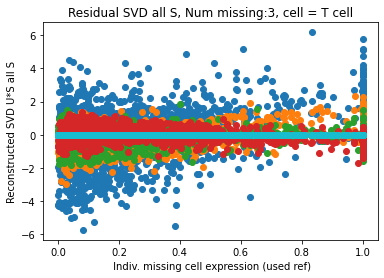

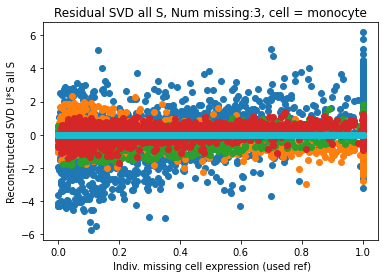

In [1695]:
#Each cell type used expression again each S value column in Recon Mat.
for num in num_missing_cells[1:]:
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        for sval in Recon_Mat_allS_realref[num].columns:
            y = Recon_Mat_allS_realref[num][sval]
            plt.scatter(x,y)
        plt.title(f'Residual SVD all S, Num missing:{num}, cell = {cell}')
        plt.xlabel(f' Indiv. missing cell expression (used ref)')
        plt.ylabel(f"Reconstructed SVD U*S all S")
        plt.show()   

**PCA**

Calculating PCA for each Residual and Percent of Variance Explained

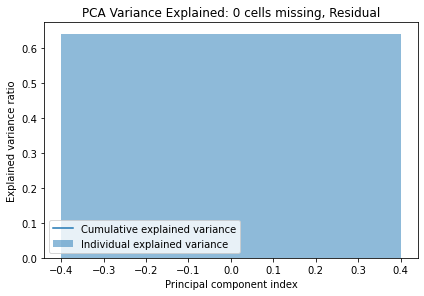

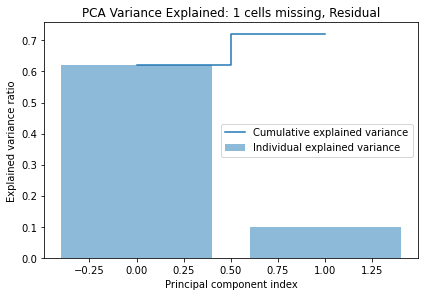

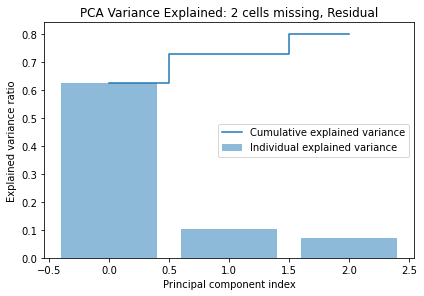

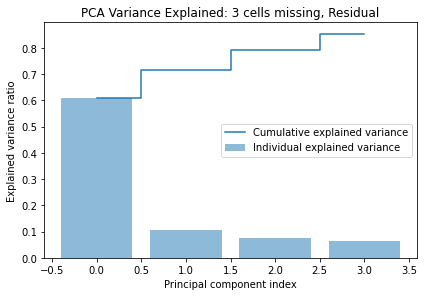

In [1798]:
pca_res = dict()
for num in num_cells_missing:
    df = residuals[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components= num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual")
    plt.show()
    pca_res[num] = pd.DataFrame(pca_results)

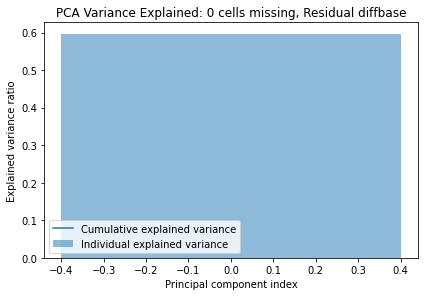

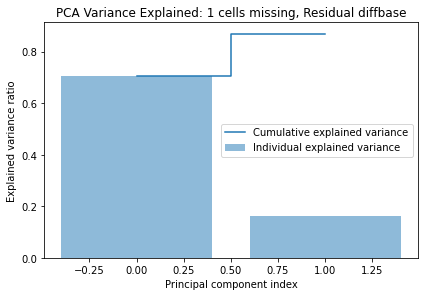

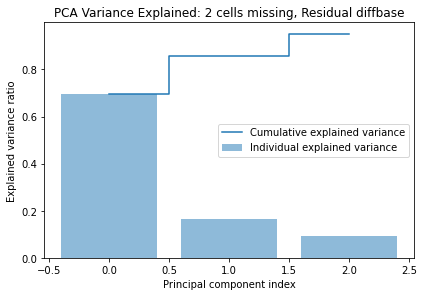

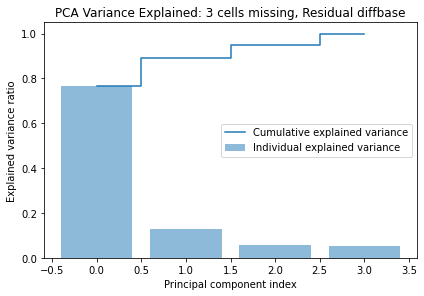

In [1799]:
pca_diffbase = dict()
for num in num_cells_missing:
    df = residuals_diffbase[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components=num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual diffbase")
    plt.show()
    pca_diffbase[num] = pd.DataFrame(pca_results)

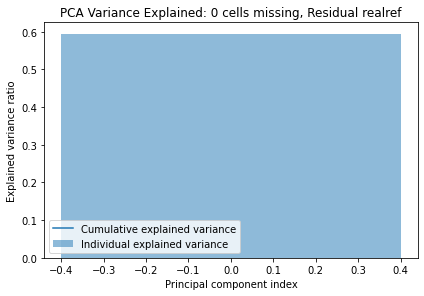

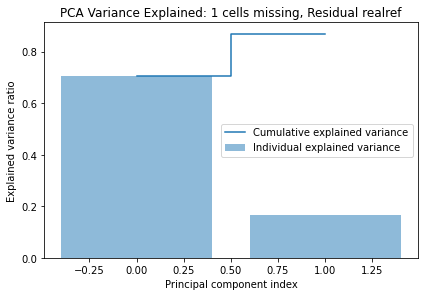

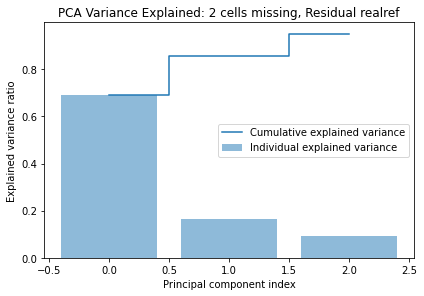

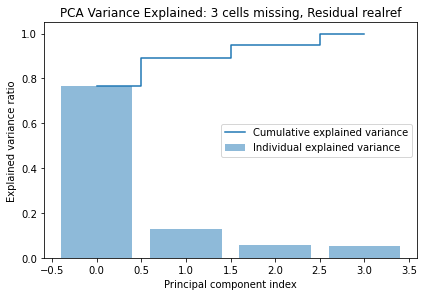

In [1800]:
pca_realref = dict()
for num in num_cells_missing: 
    df = residuals_realref[num].T #transposing to get length of genes instead of samples
    fit = PCA(n_components=num + 1)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing, Residual realref")
    plt.show()
    pca_realref[num] = pd.DataFrame(pca_results)

Analyzing PCA Results

Residual

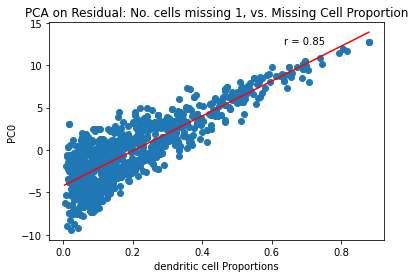

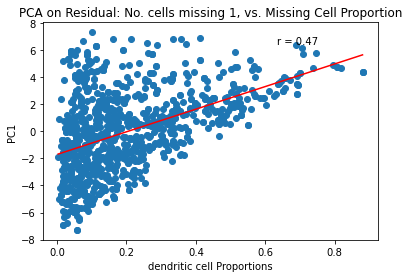

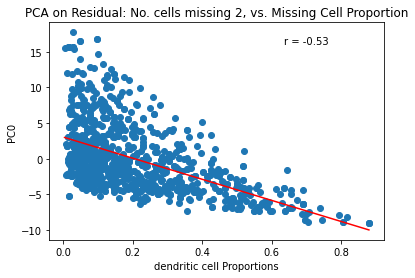

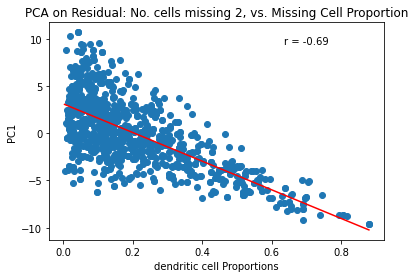

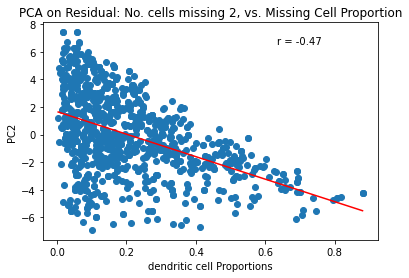

...

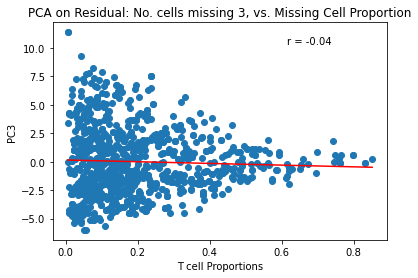

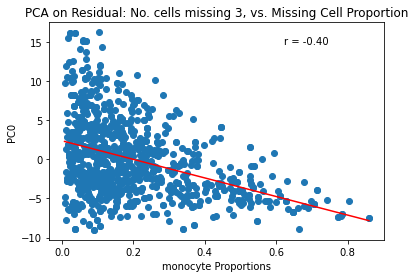

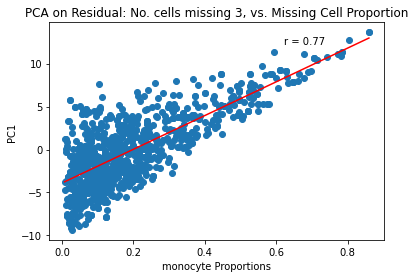

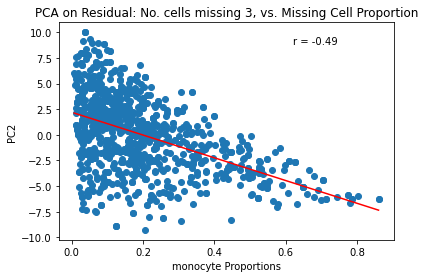

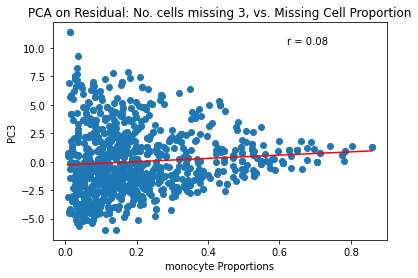

In [1801]:
#Starting with PCA by sample, not by gene, compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    df = residuals[num] # not transposing to get length of samples
    fit = PCA(n_components= num + 1)
    pca_results = fit.fit_transform(df.values)
    pca_results = pd.DataFrame(pca_results)
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in pca_results.columns: #each factor
            y = pca_results[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"PC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

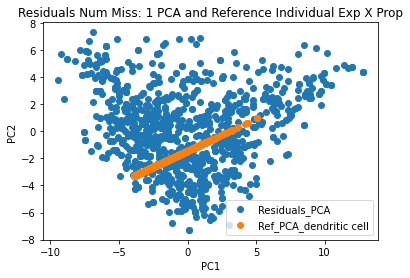

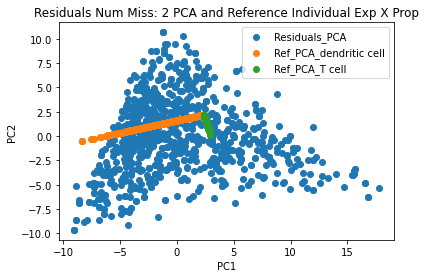

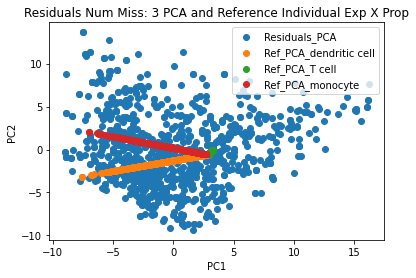

In [1802]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=5)
    pseudos_pca = pca.fit_transform(residuals[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

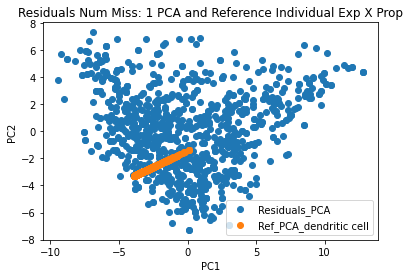

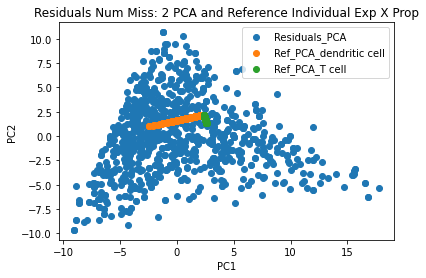

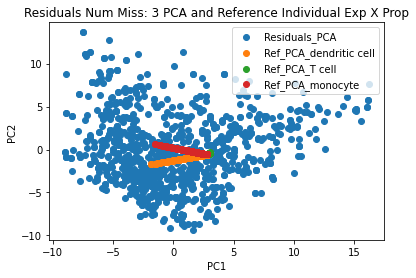

In [1803]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

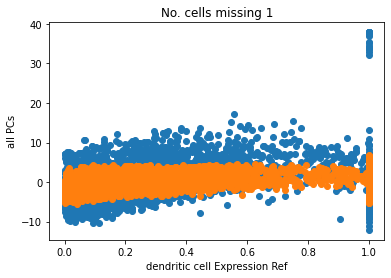

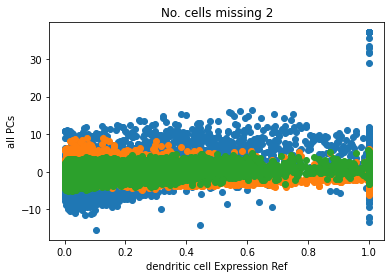

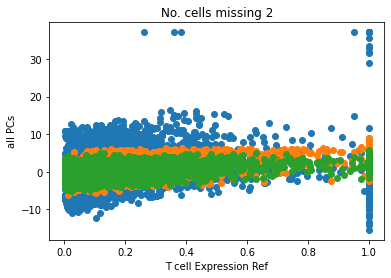

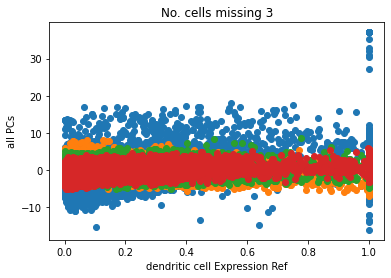

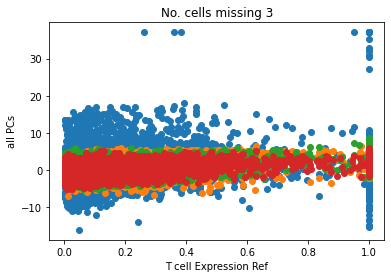

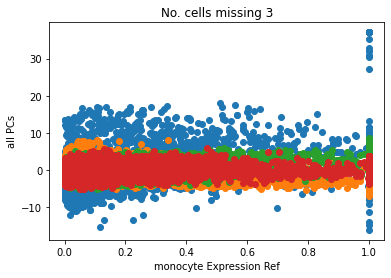

In [1804]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_res[num].columns: #each PC
            y = pca_res[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

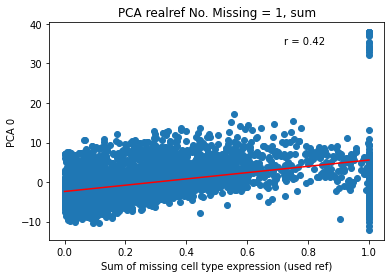

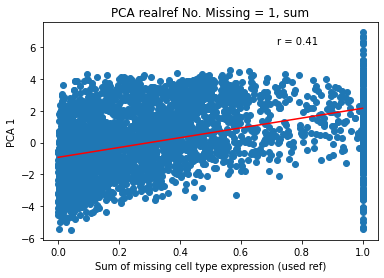

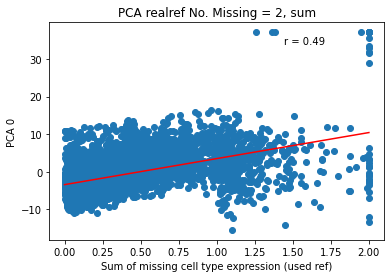

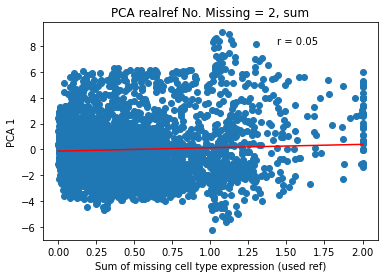

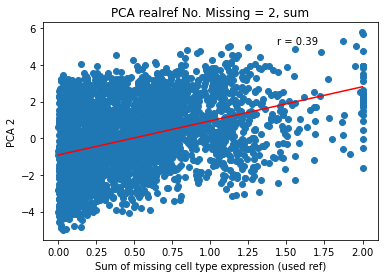

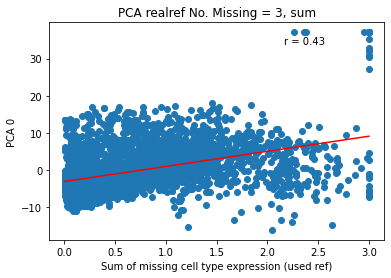

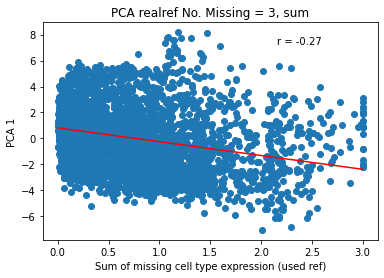

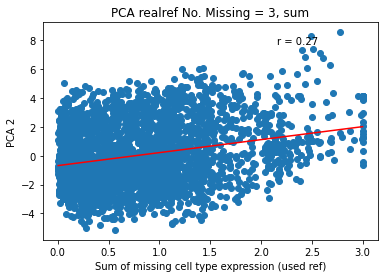

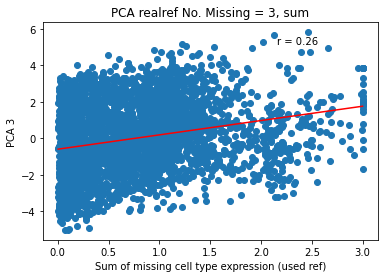

In [1805]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num+1):
        y = pca_res[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

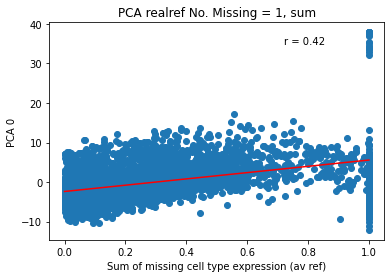

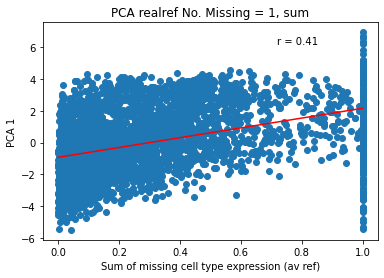

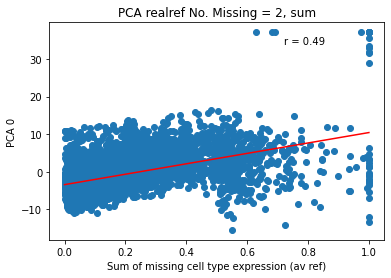

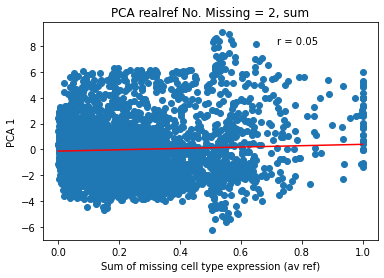

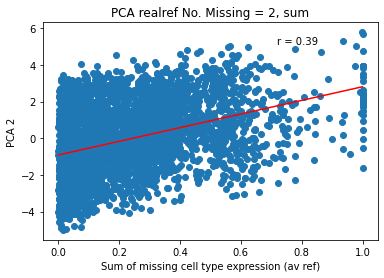

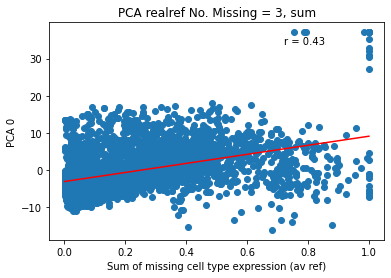

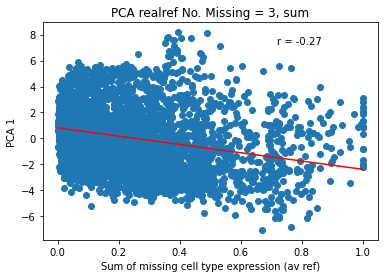

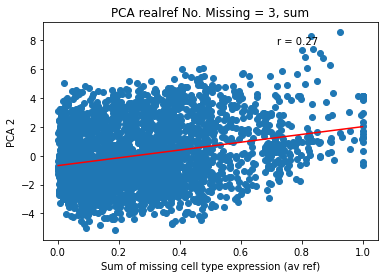

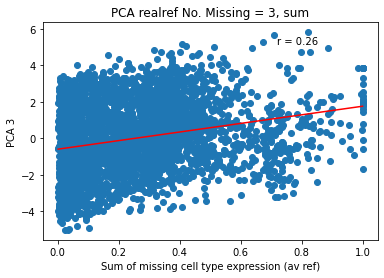

In [1806]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num+1):
        y = pca_res[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

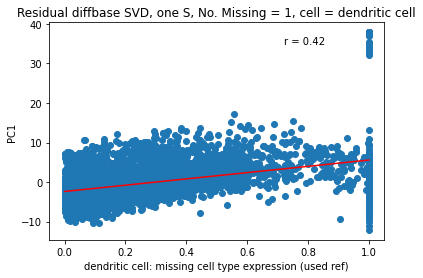

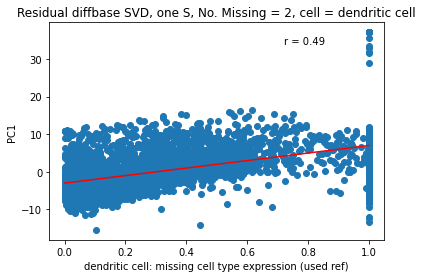

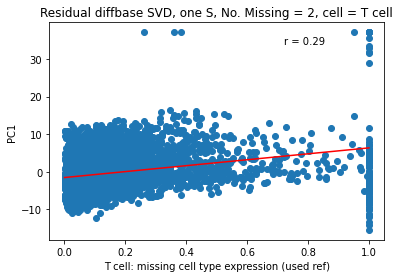

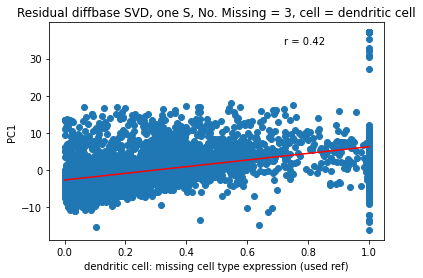

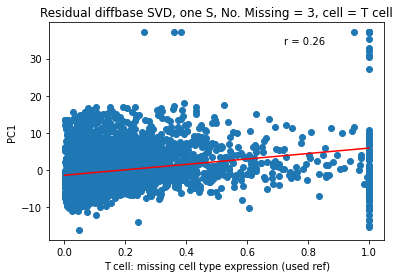

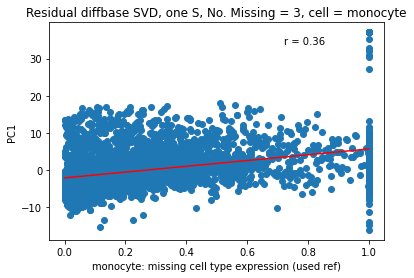

In [1807]:
#Just the first PC with each cell type
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_res[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

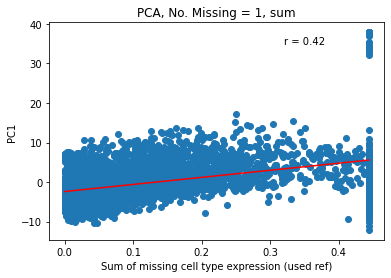

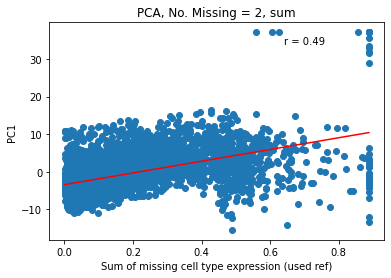

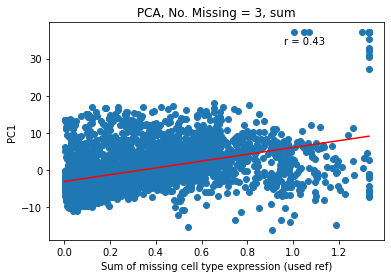

In [1808]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_res[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

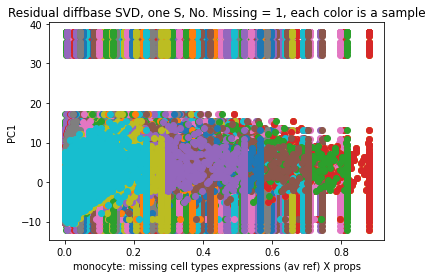

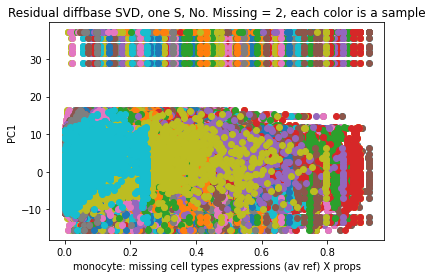

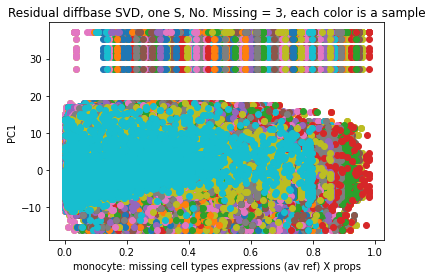

In [1809]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_res[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

Residual diffbase

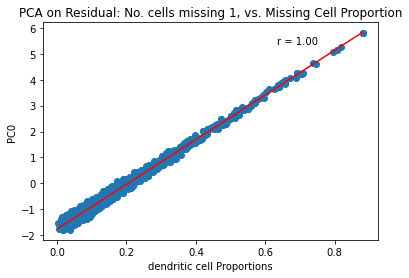

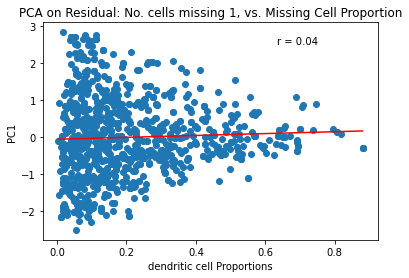

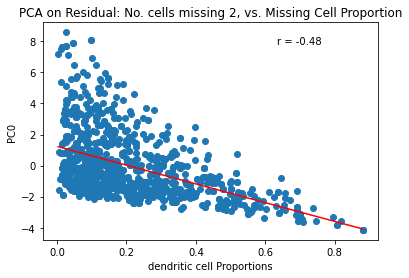

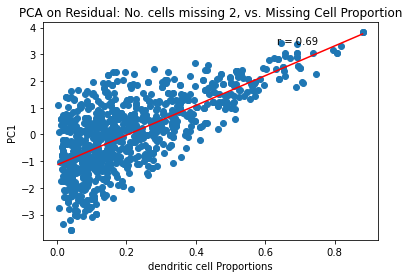

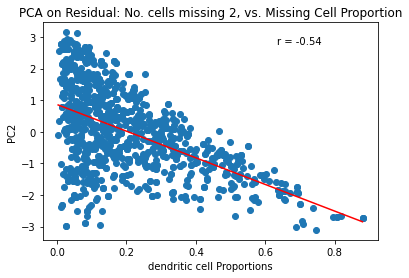

...

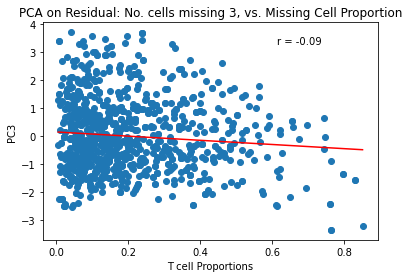

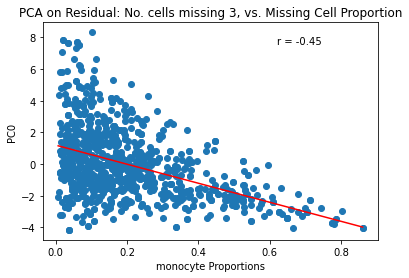

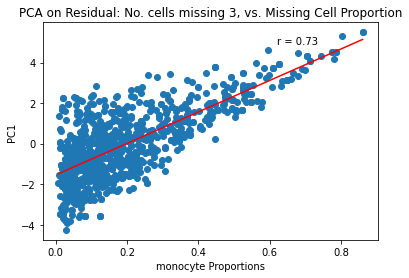

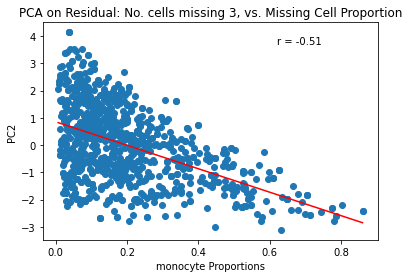

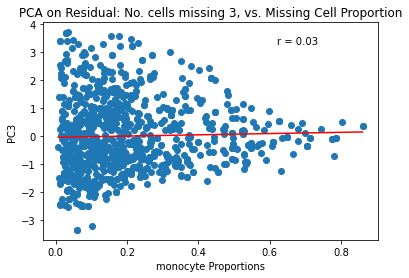

In [1810]:
#Starting with PCA by sample, not by gene, compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    df = residuals_diffbase[num] # not transposing to get length of samples
    fit = PCA(n_components= num + 1)
    pca_results = fit.fit_transform(df.values)
    pca_results = pd.DataFrame(pca_results)
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in pca_results.columns: #each factor
            y = pca_results[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"PC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

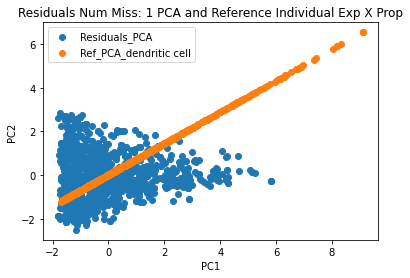

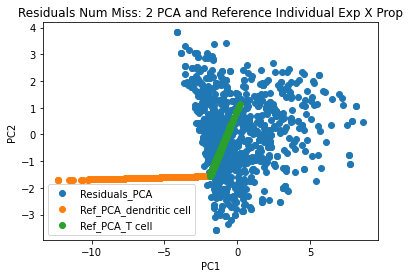

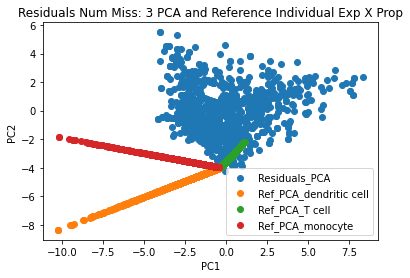

In [1811]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=10)
    pseudos_pca = pca.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

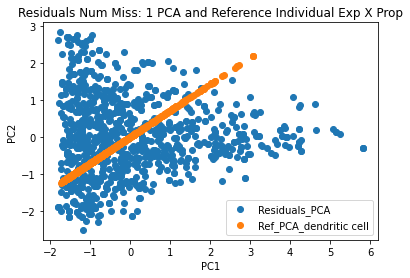

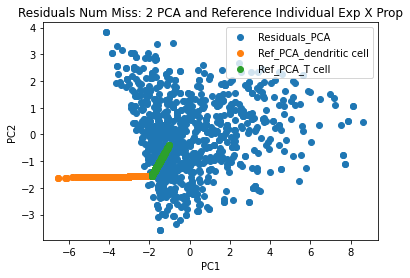

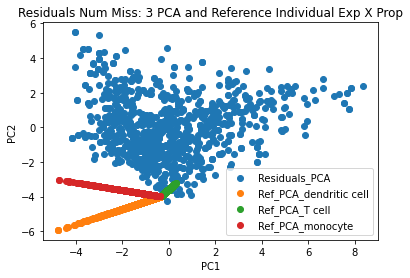

In [1812]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

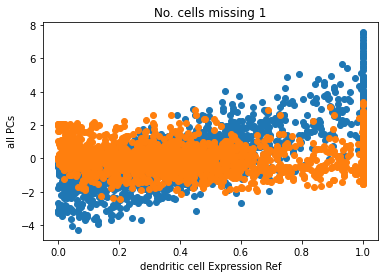

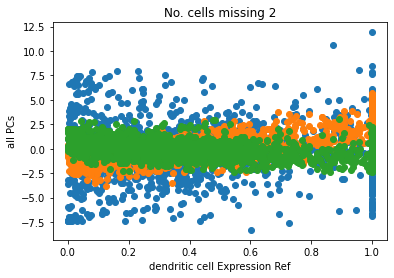

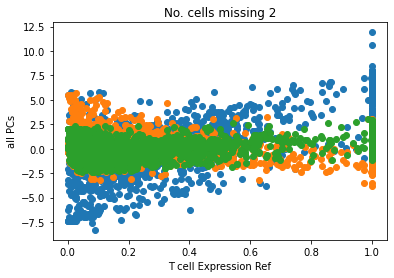

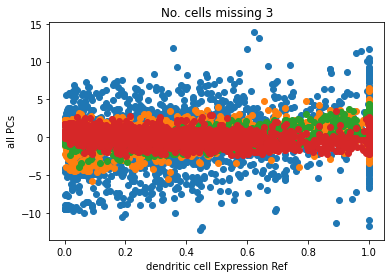

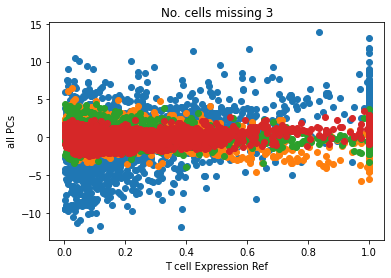

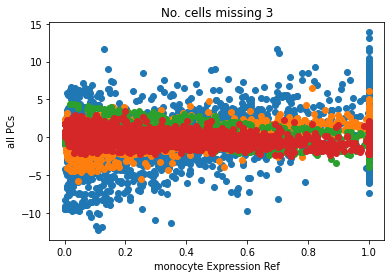

In [1813]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_diffbase[num].columns: #each PC
            y = pca_diffbase[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

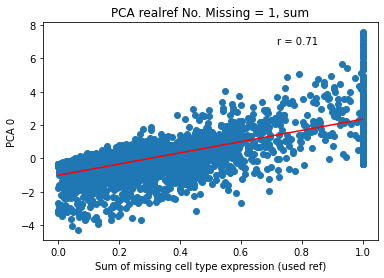

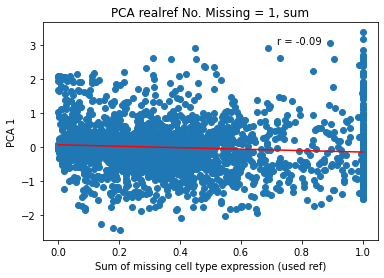

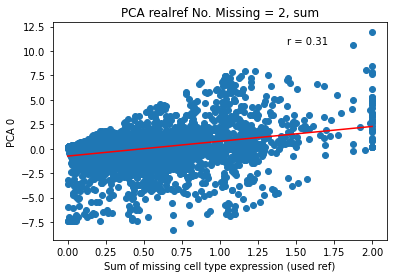

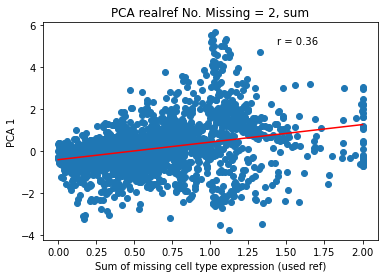

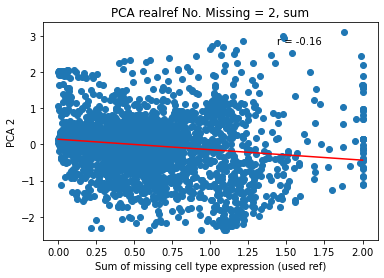

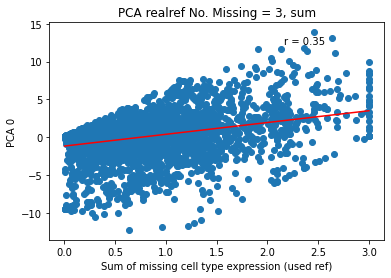

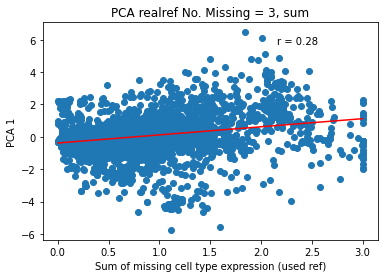

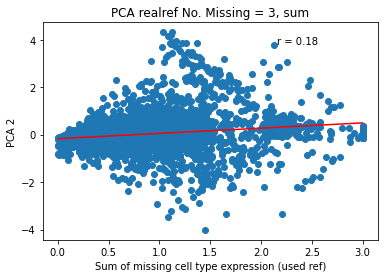

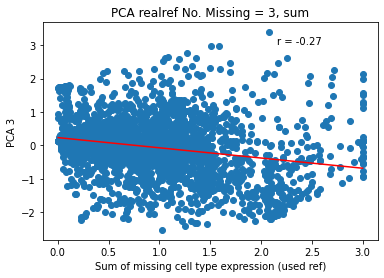

In [1814]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num + 1):
        y = pca_diffbase[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

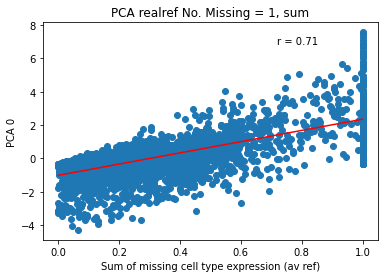

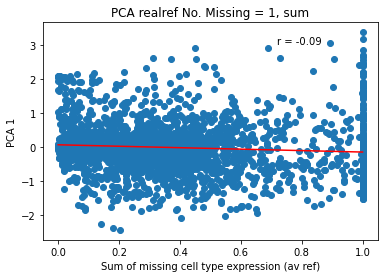

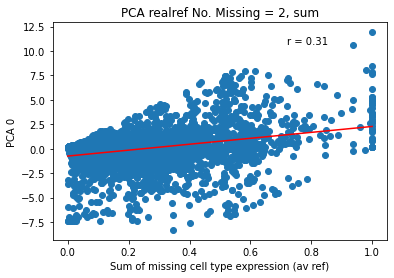

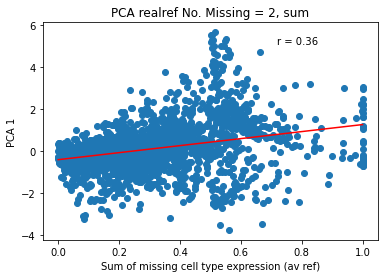

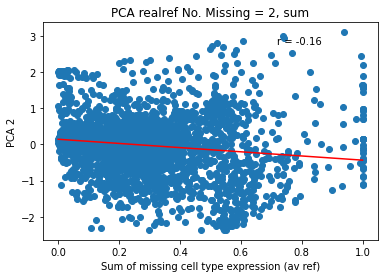

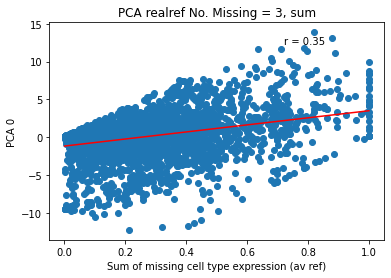

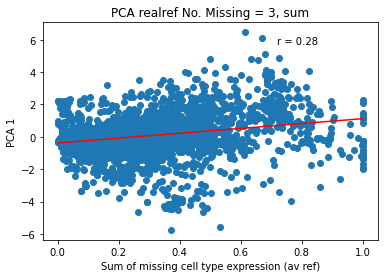

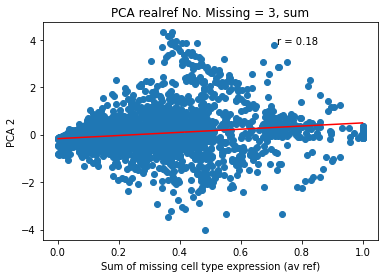

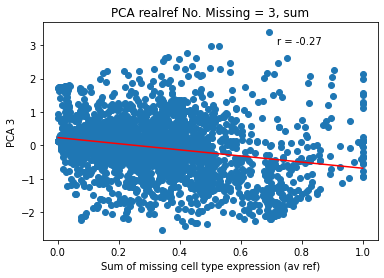

In [1815]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num + 1):
        y = pca_diffbase[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

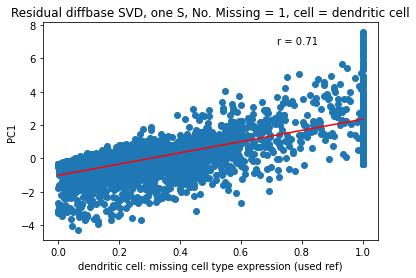

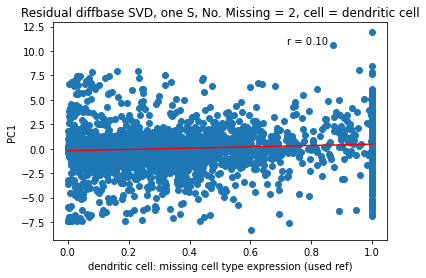

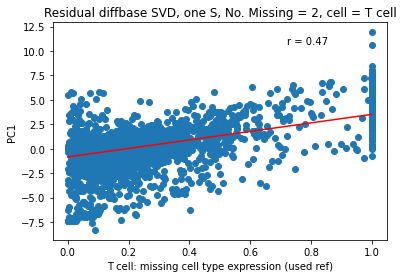

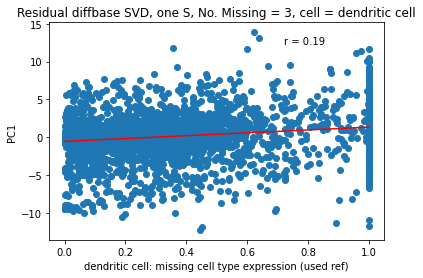

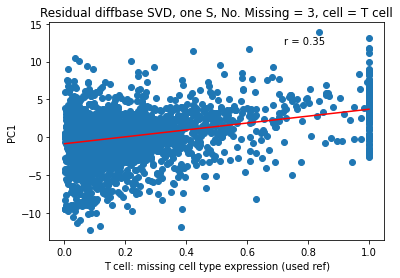

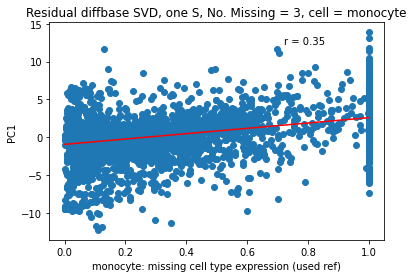

In [1816]:
#Just the first PC with each cell type expression
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_diffbase[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

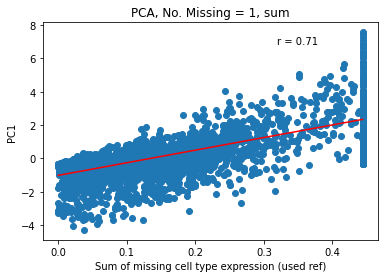

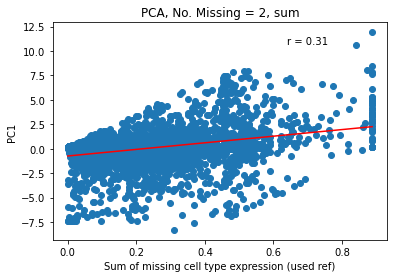

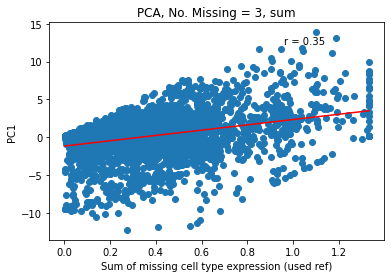

In [1817]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_diffbase[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

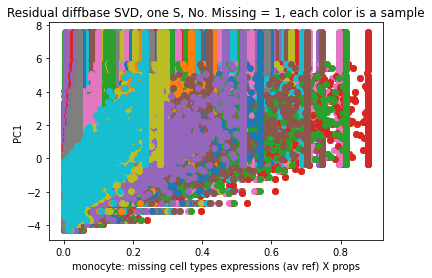

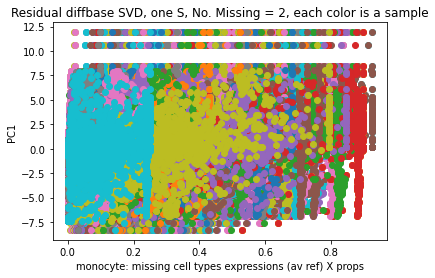

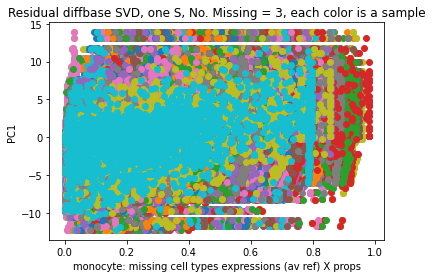

In [1818]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_diffbase[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

Residual realref

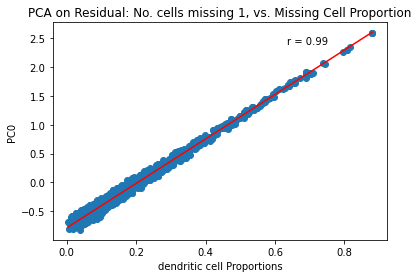

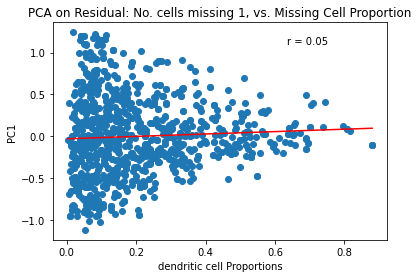

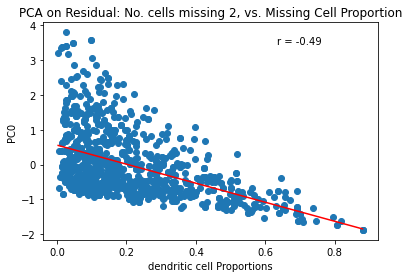

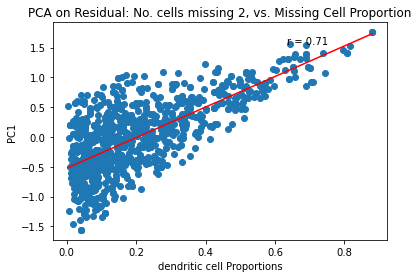

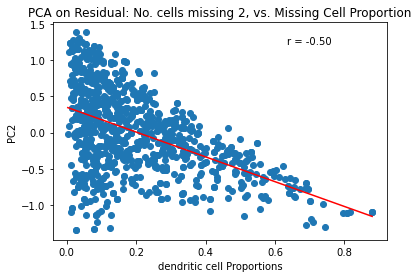

...

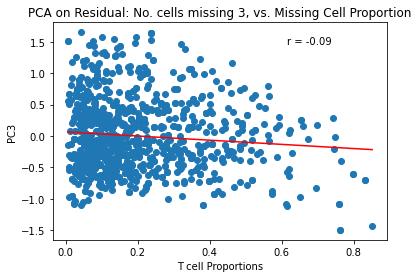

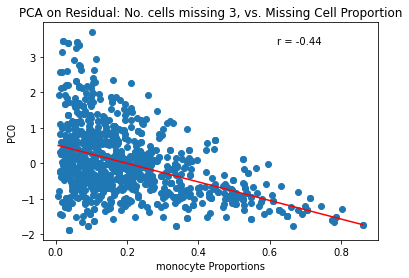

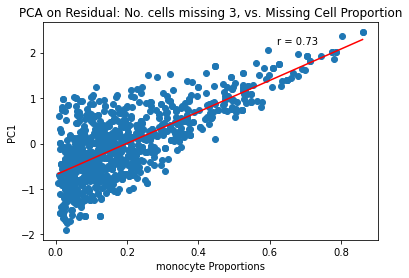

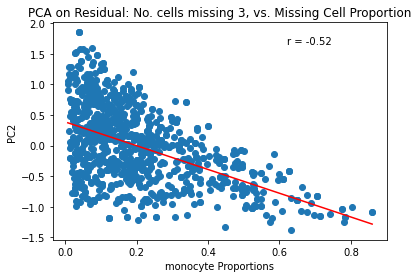

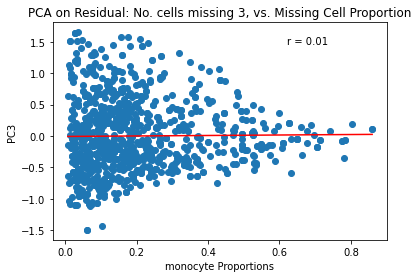

In [1819]:
#Starting with PCA by sample, not by gene, compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    df = residuals_realref[num] # not transposing to get length of samples
    fit = PCA(n_components= num + 1)
    pca_results = fit.fit_transform(df.values)
    pca_results = pd.DataFrame(pca_results)
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in pca_results.columns: #each factor
            y = pca_results[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'PCA on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"PC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

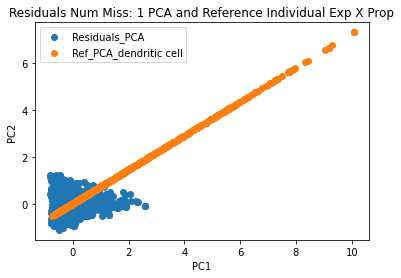

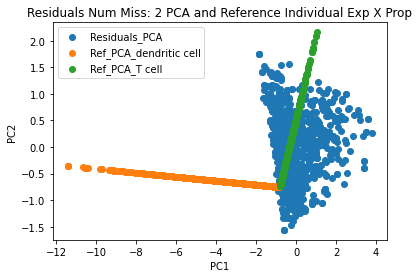

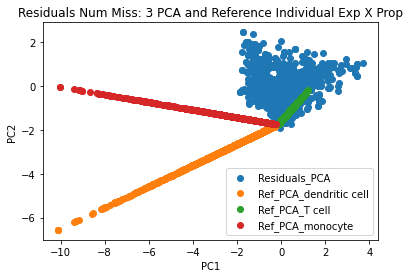

In [1820]:
#PCA of Residual with Each missing cell's used exp * prop
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    pca = PCA(n_components=10)
    pseudos_pca = pca.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

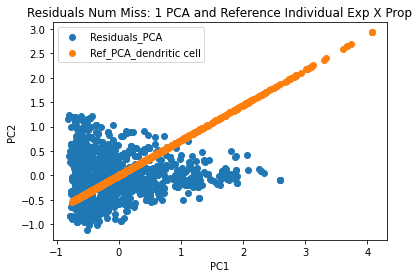

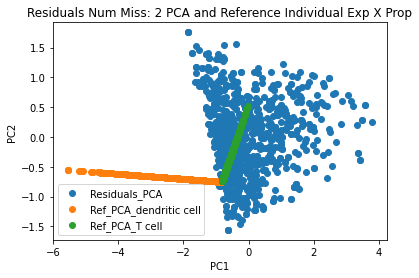

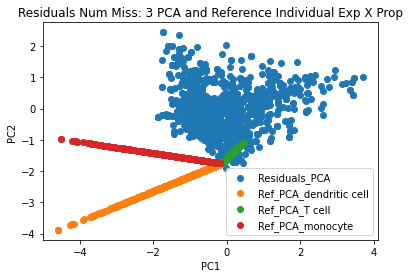

In [1821]:
#PCA of Residual with Each missing cell's av exp * prop
for num in num_missing_cells[1:]:
    cells_dict = avex_prop_individual[num]
    pca = PCA(n_components = 4)
    pseudos_pca = pca.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_pca[:,0], pseudos_pca[:,1], label = "Residuals_PCA" )
    for cell in cells_dict:
        ref_pca = pca.transform(cells_dict[cell])
        plt.scatter(ref_pca[:,0], ref_pca[:,1], label = f"Ref_PCA_{cell}" )
    plt.title(f"Residuals Num Miss: {num} PCA and Reference Individual Exp X Prop")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.legend()
    plt.show()

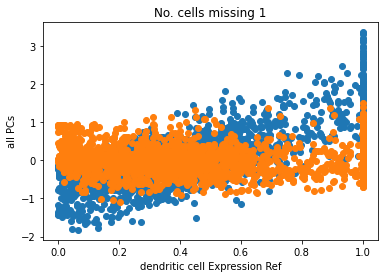

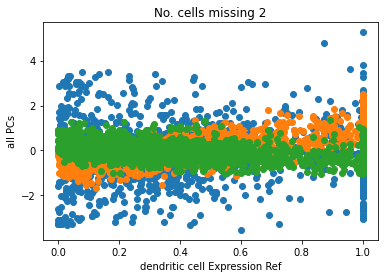

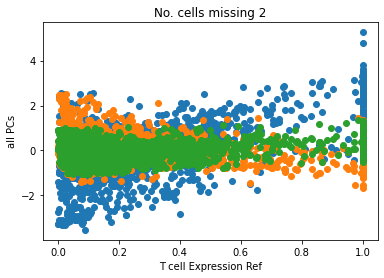

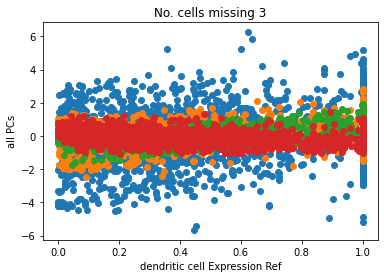

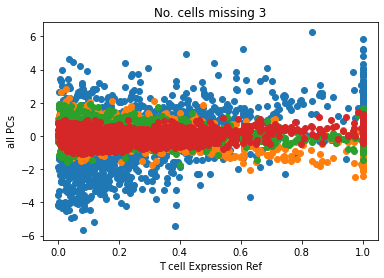

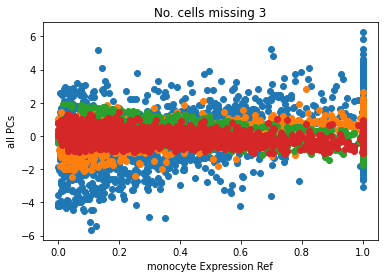

In [1822]:
#each missing cell type expression with each PC
for num in num_missing_cells[1:]:
    for column in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][column] #each missing cell type
        for pc in pca_realref[num].columns: #each PC
            y = pca_realref[num][pc]
            plt.scatter(x,y)
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{column} Expression Ref')
        plt.ylabel(f"all PCs")
        plt.show()

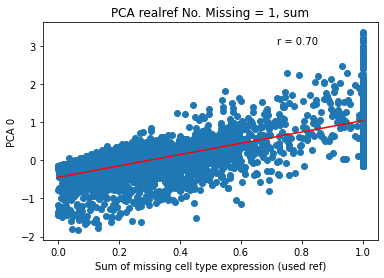

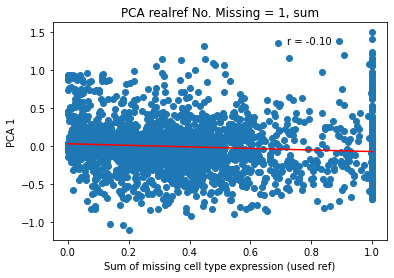

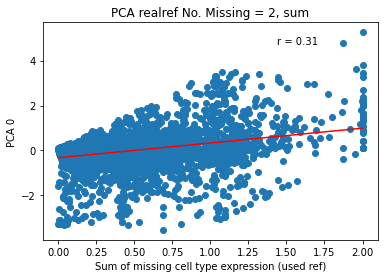

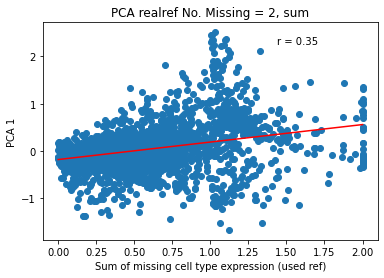

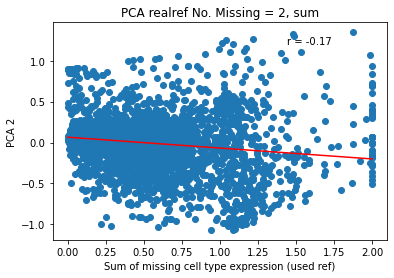

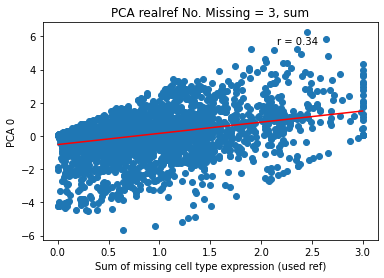

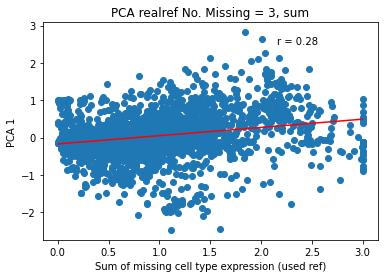

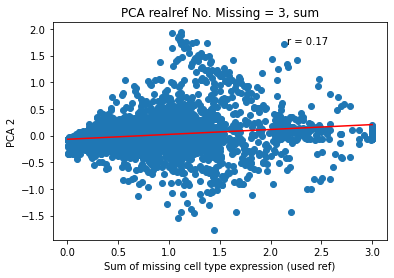

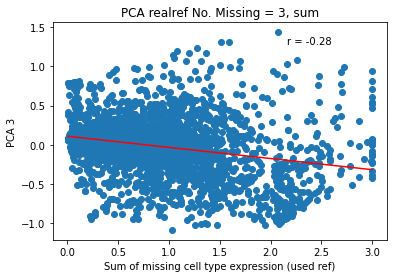

In [1823]:
#Each missing cell type expression summed with each PC 
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].sum(axis=1).values
    for number in range(0,num + 1):
        y = pca_realref[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (used ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

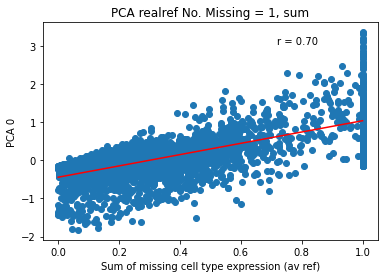

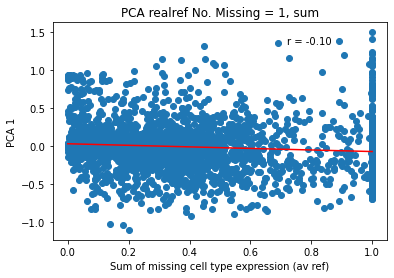

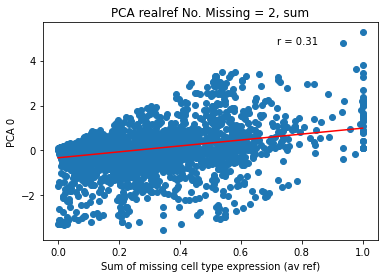

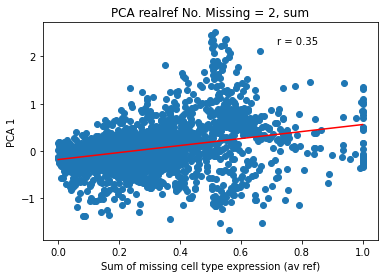

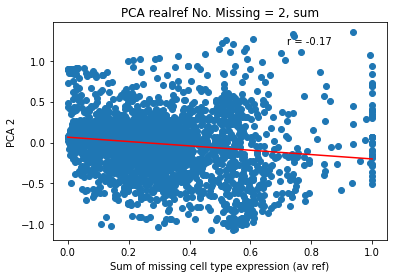

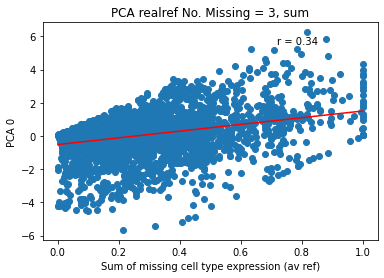

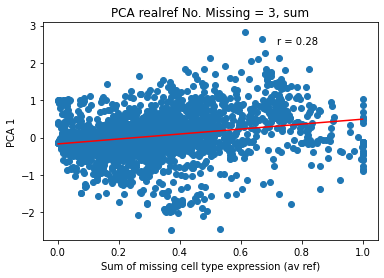

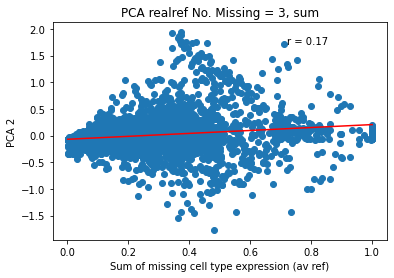

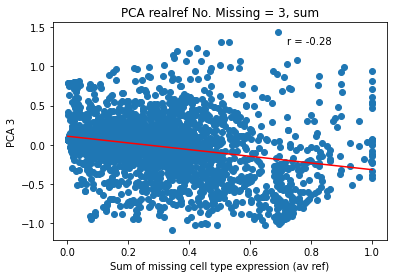

In [1824]:
#same as above, but with average instead of sum:
for num in num_missing_cells[1:]:
    x = missing_cell_exp_usedref[num].mean(axis=1).values
    for number in range(0,num+ 1):
        y = pca_realref[num][number]
        plt.scatter(x,y)
        plt.title(f'PCA realref No. Missing = {num}, sum')
        plt.xlabel(f'Sum of missing cell type expression (av ref)')
        plt.ylabel(f"PCA {number}")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

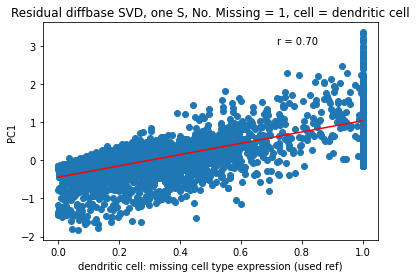

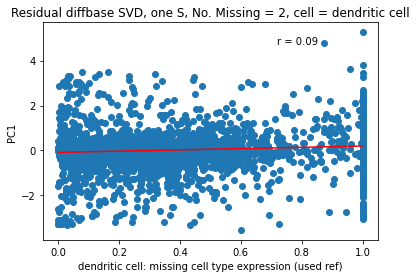

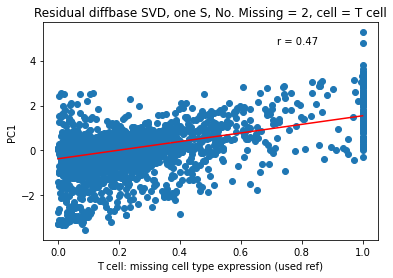

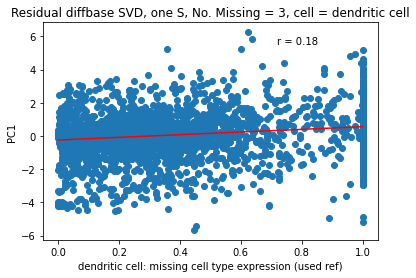

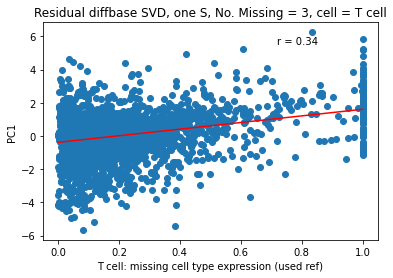

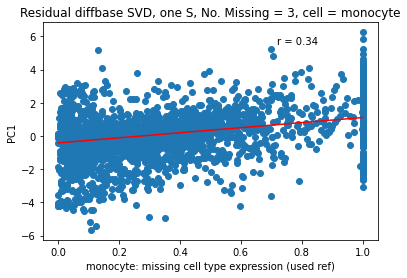

In [1825]:
#Just the first PC with each cell type expression
for num in num_missing_cells[1:]:
    for col in missing_cell_exp_usedref[num].columns: #each cell type
        x = missing_cell_exp_usedref[num][col]
        y= pca_realref[num][0] #with PC0
        plt.scatter(x,y)
        plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, cell = {col}')
        plt.xlabel(f'{col}: missing cell type expression (used ref)')
        plt.ylabel(f"PC1")
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        r, p = stats.pearsonr(x, y)
        plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

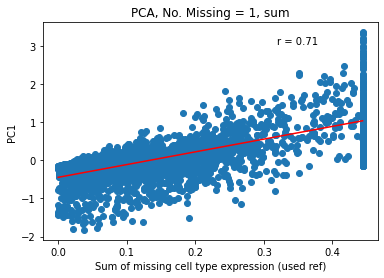

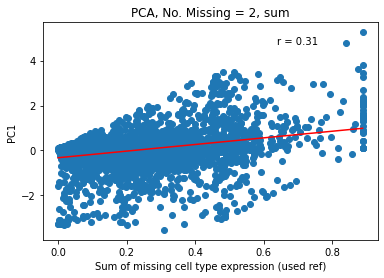

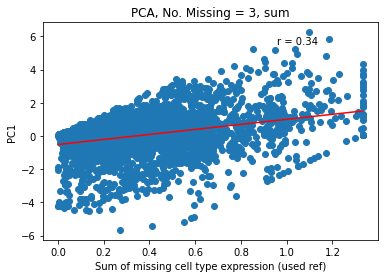

In [1826]:
#just the firsty PC with the SUM of all missing cell types expression
for num in num_missing_cells[1:]:
    x = missing_cell_exp_avref[num].sum(axis=1).values
    y= pca_realref[num][0]
    plt.scatter(x,y)
    plt.title(f'PCA, No. Missing = {num}, sum')
    plt.xlabel(f'Sum of missing cell type expression (used ref)')
    plt.ylabel(f"PC1")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

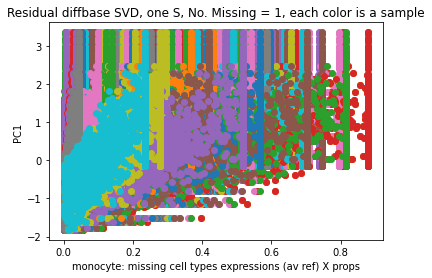

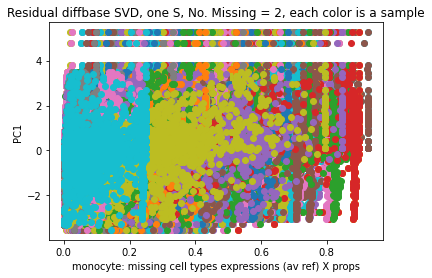

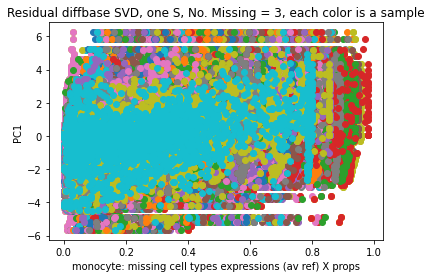

In [1827]:
#combined missing cell types expression X proportions, each sample with PC0
for num in num_missing_cells[1:]:
    for index,row in missing_cell_usedexp_x_prop[num].iterrows(): #each sample 
        x = row.values
        y= pca_realref[num][0] #with PC0
        plt.scatter(x,y)
    plt.title(f'Residual diffbase SVD, one S, No. Missing = {num}, each color is a sample')
    plt.xlabel(f'{col}: missing cell types expressions (av ref) X props')
    plt.ylabel(f"PC1")
    plt.show()

**ICA**

Calculate ICA

In [1836]:
#ICA on residual 1
res_ica = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica[num] = res_ica_df

In [1837]:
#ICA on residual diffbase
res_ica_diffbase = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_diffbase[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica_diffbase[num] = res_ica_df

In [1838]:
#ICA on residual realref
res_ica_realref = dict()
for num in num_missing_cells:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_realref[num].T)
    res_ica_df = pd.DataFrame(res_ica_df)
    res_ica_realref[num] = res_ica_df

Residual

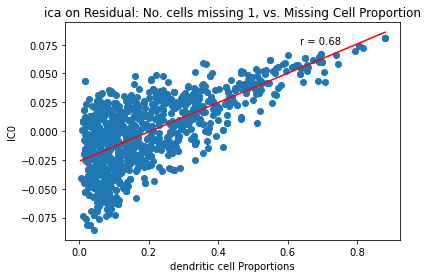

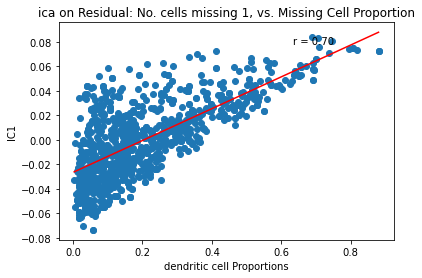

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


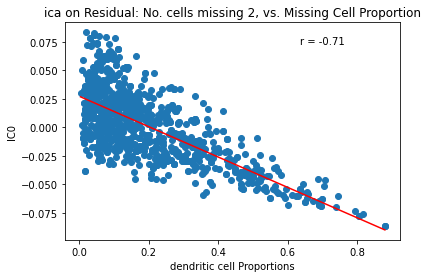

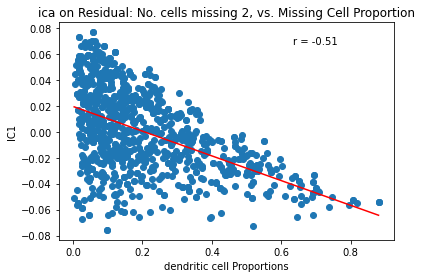

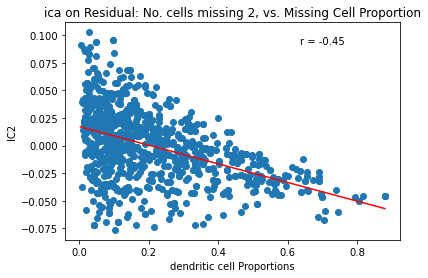

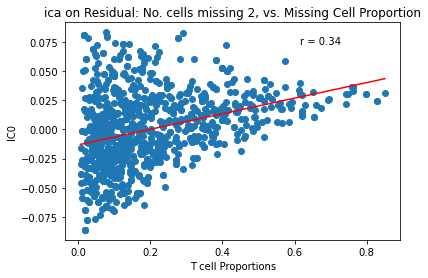

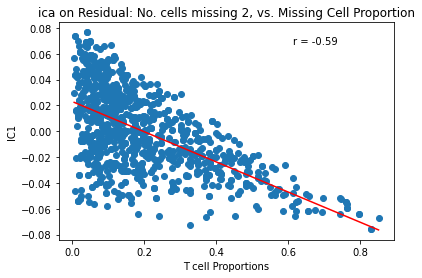

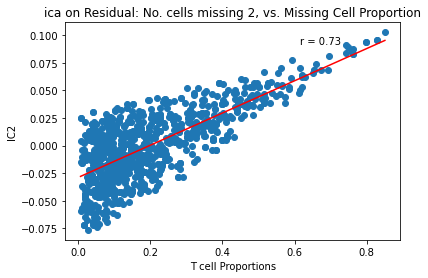

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


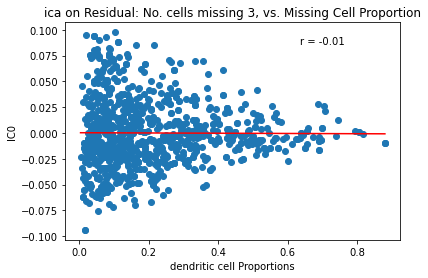

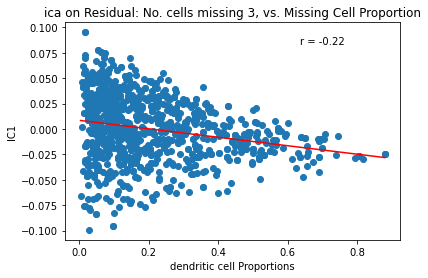

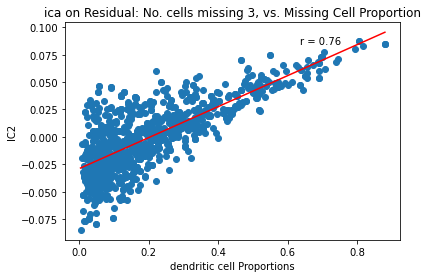

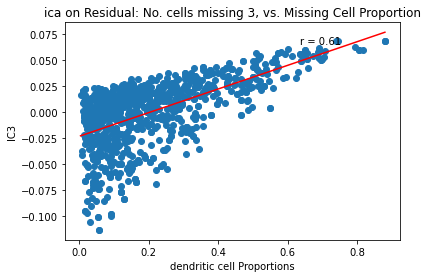

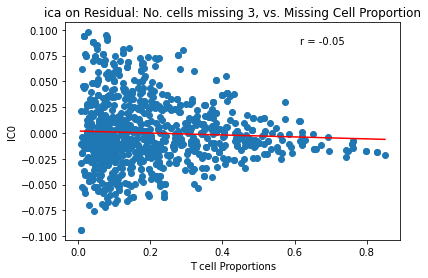

...

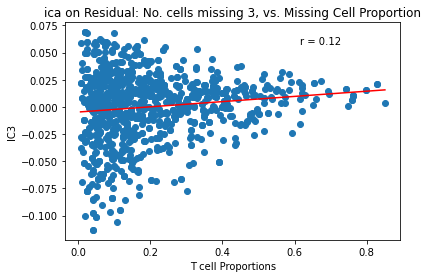

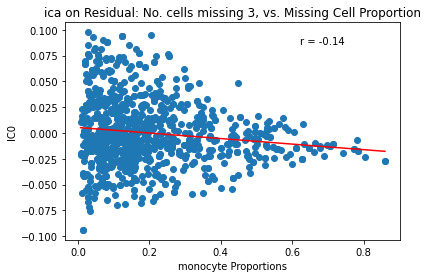

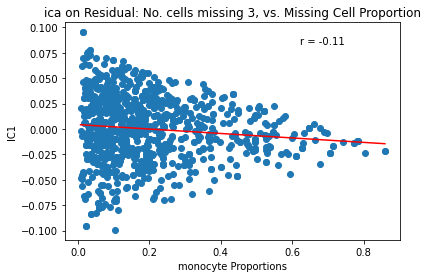

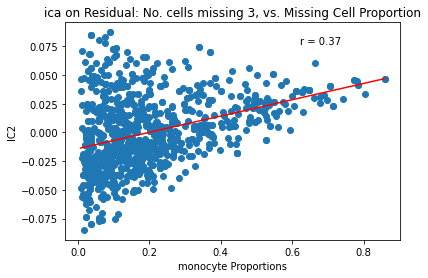

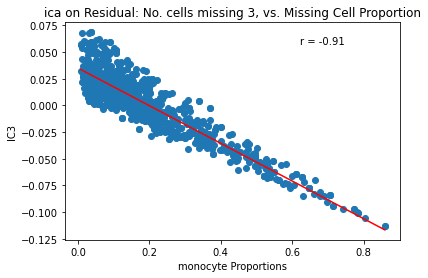

In [1839]:
#ICA on residual, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_ica_df.columns: #each factor
            y = res_ica_df[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'ica on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"IC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


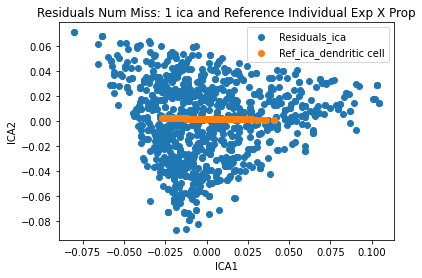

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


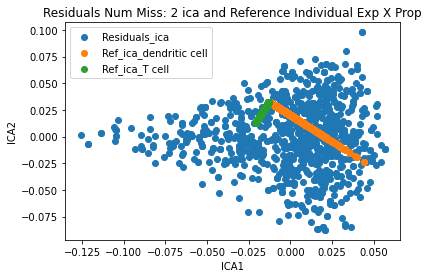

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


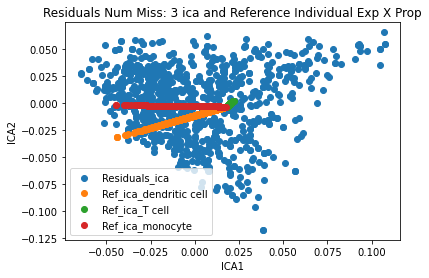

In [1840]:
#ICA with individual missing cell used expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

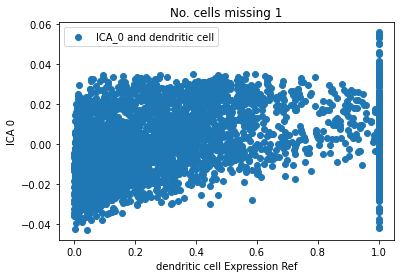

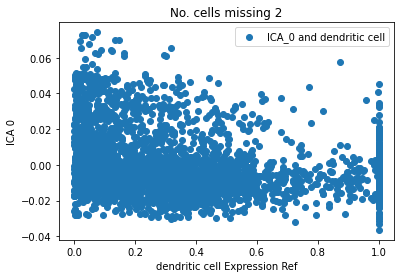

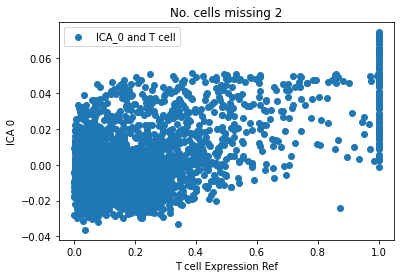

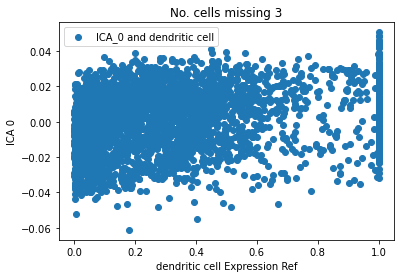

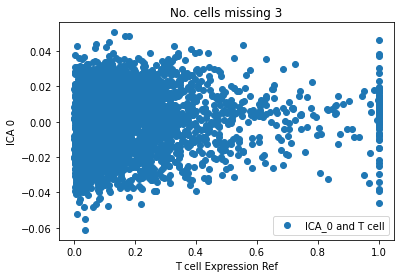

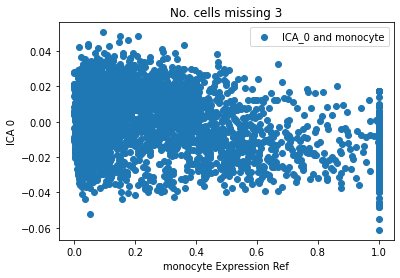

In [1841]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

Residual_diffbase

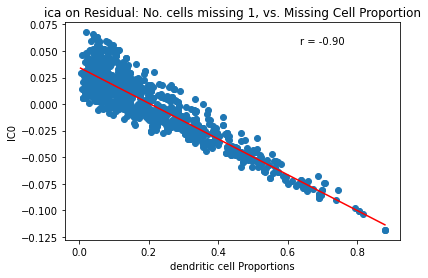

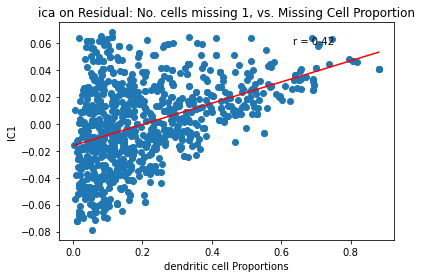

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


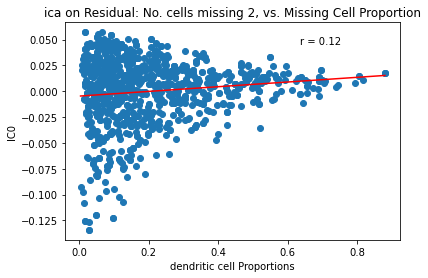

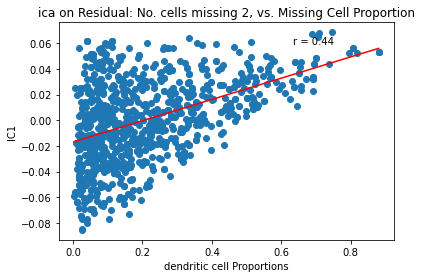

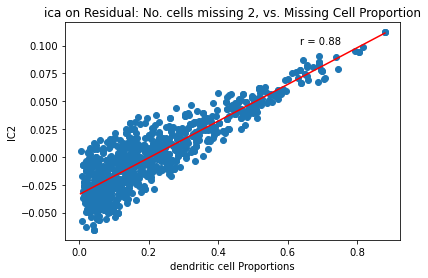

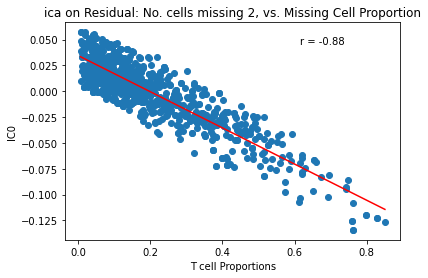

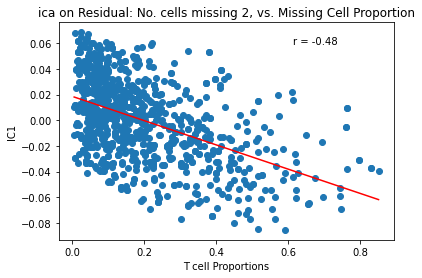

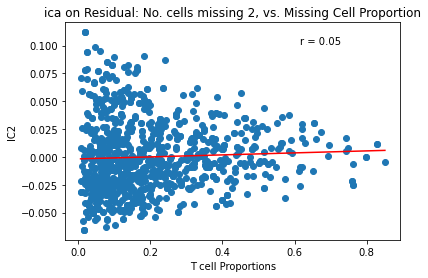

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


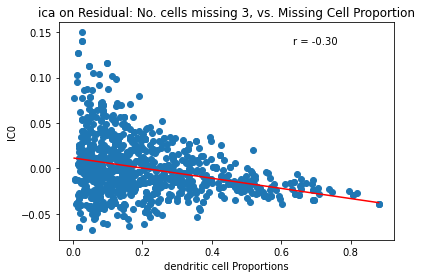

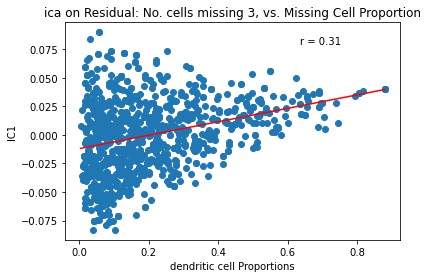

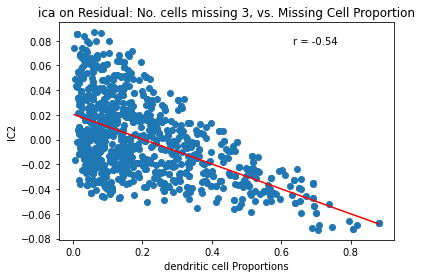

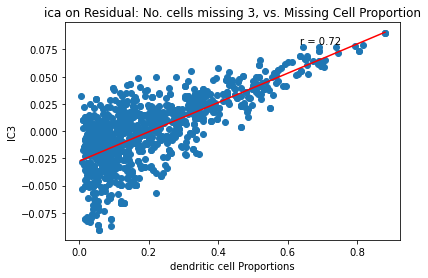

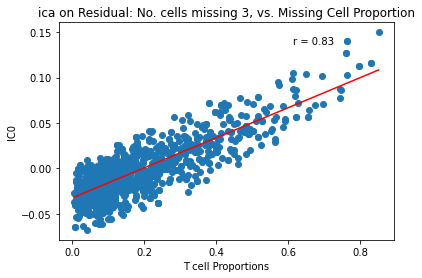

...

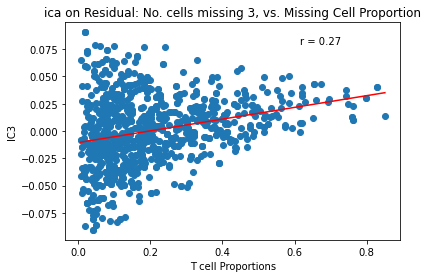

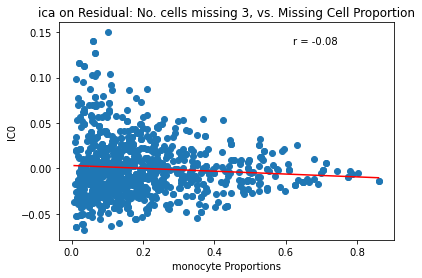

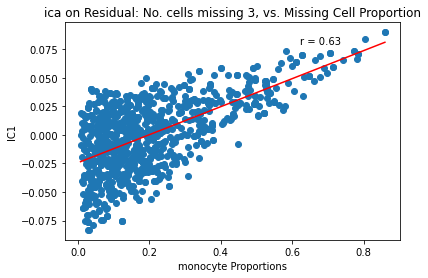

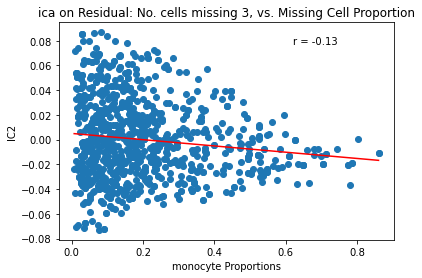

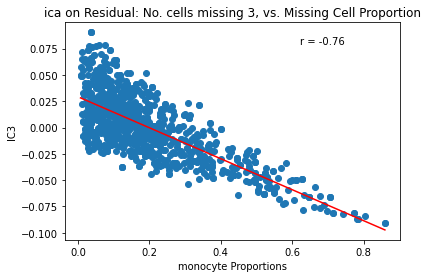

In [1842]:
#ICA on residual diffbase, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_diffbase[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_ica_df.columns: #each factor
            y = res_ica_df[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'ica on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"IC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


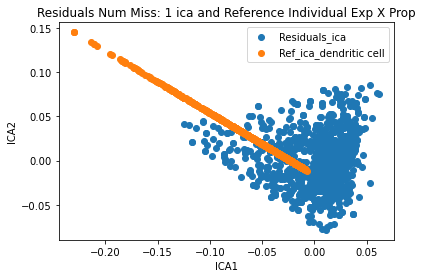

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


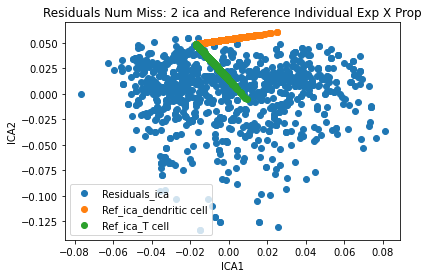

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


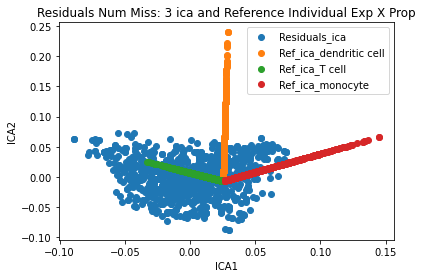

In [1843]:
#ICA with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals_diffbase[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

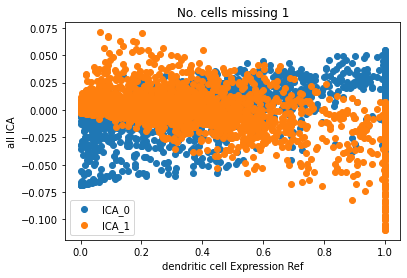

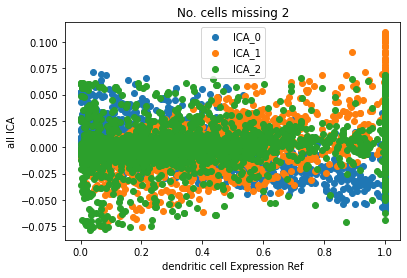

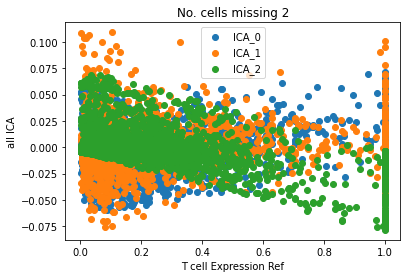

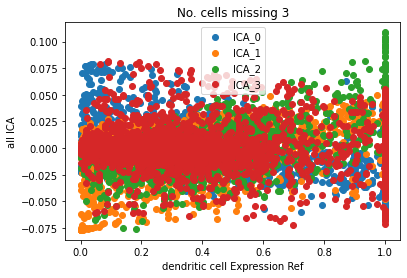

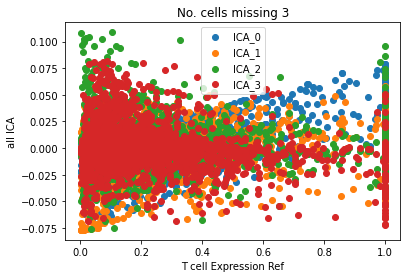

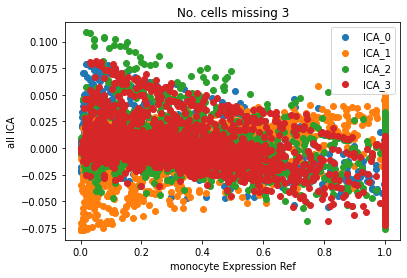

In [1844]:
#all ICs with missing cells expression reference.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_diffbase[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell] #each celll
        for pc in res_ica_all.columns: #with each component.
            y = res_ica_all[pc]
            plt.scatter(x,y, label = f"ICA_{pc}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"all ICA")
        plt.legend()
        plt.show()

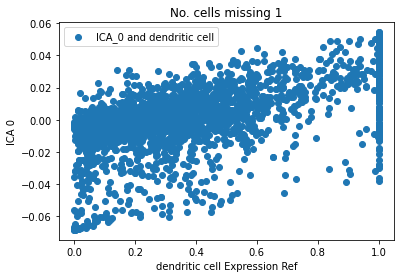

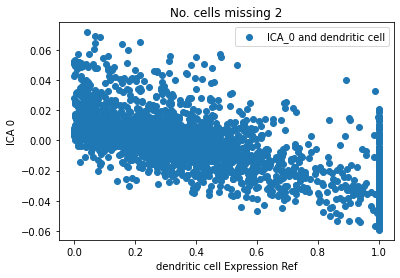

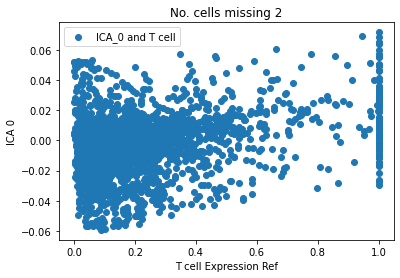

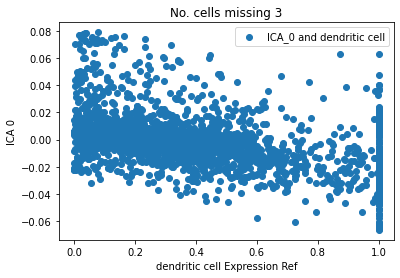

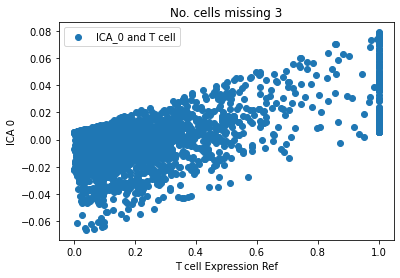

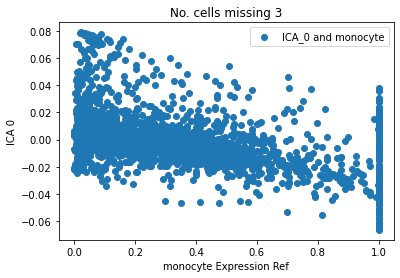

In [1845]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_diffbase[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

Residual_realref

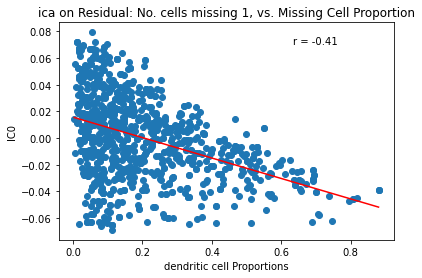

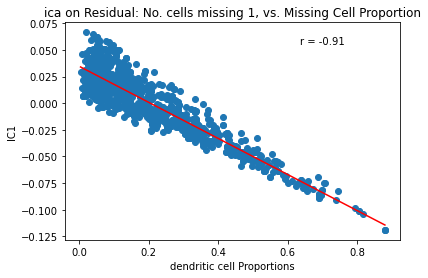

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


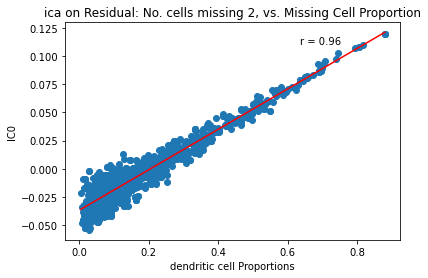

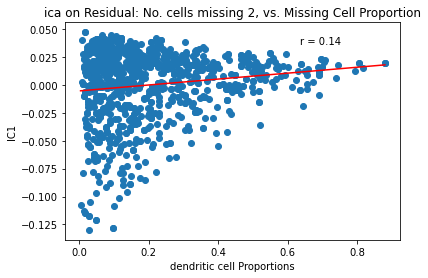

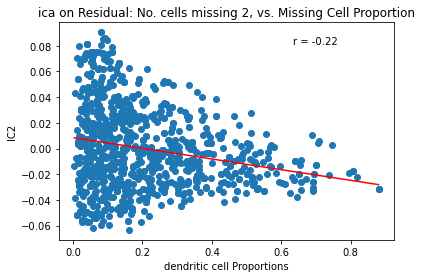

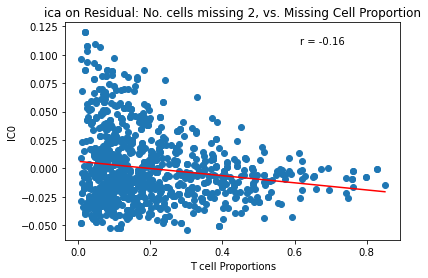

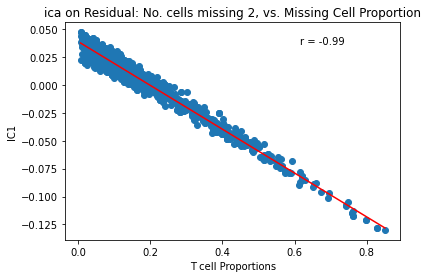

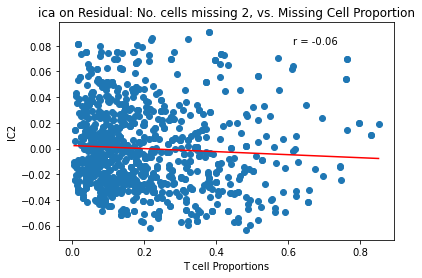

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


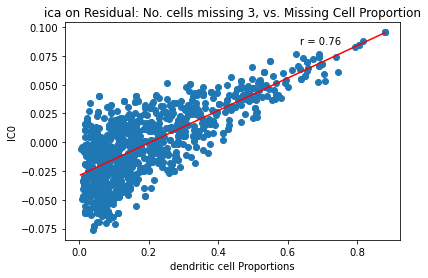

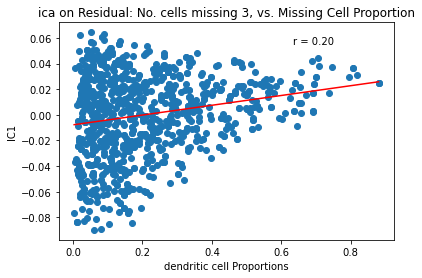

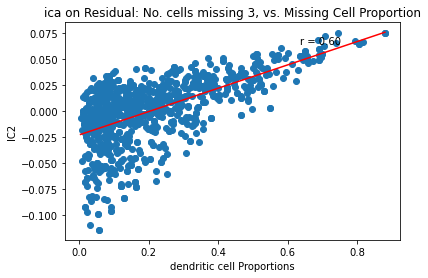

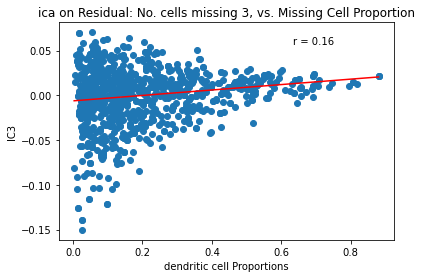

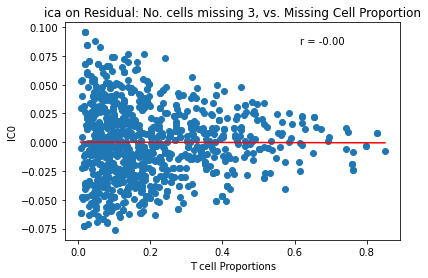

...

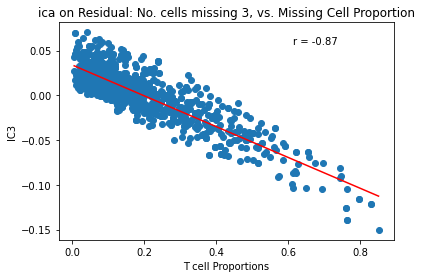

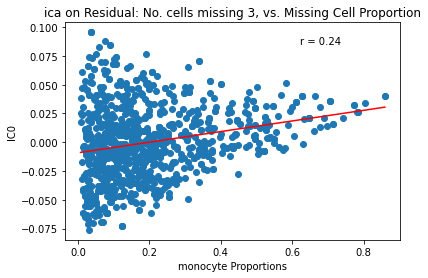

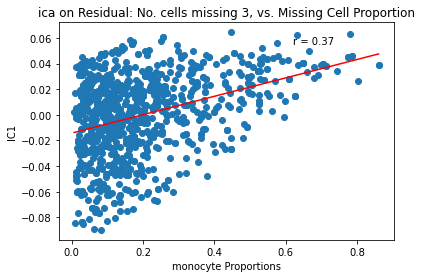

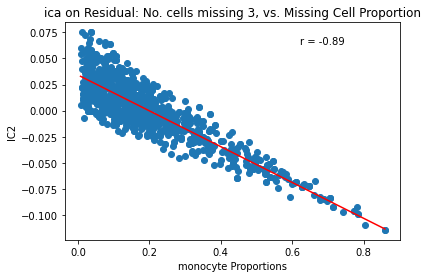

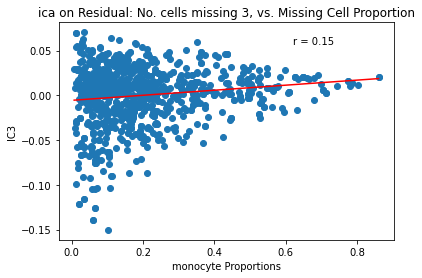

In [1846]:
#ICA on residual diffbase, Starting with ICA by sample, not by gene, 
# compared to the proportions of missing cell types.
for num in num_missing_cells[1:]:
    num_ica = num + 1
    ica = FastICA(n_components = num_ica)
    res_ica_df = ica.fit_transform(residuals_realref[num])
    res_ica_df = pd.DataFrame(res_ica_df)#each missing cell type expression with each factor
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_ica_df.columns: #each factor
            y = res_ica_df[factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'ica on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"IC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


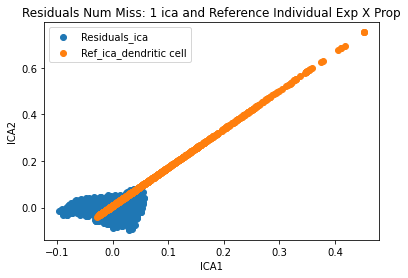

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


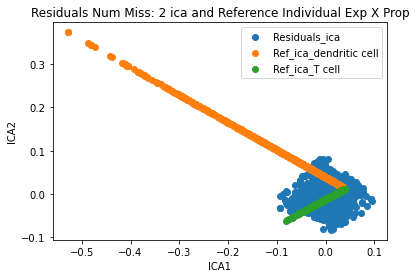

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


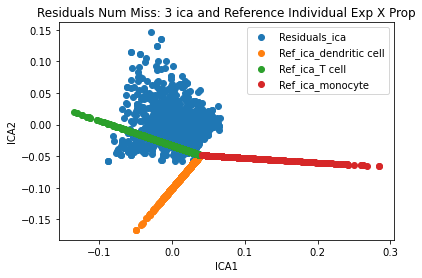

In [1847]:
#ICA with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    ica = FastICA(n_components = 4)
    pseudos_ica = ica.fit_transform(residuals_realref[num])
    plt.scatter(pseudos_ica[:,0], pseudos_ica[:,1], label = "Residuals_ica" )
    for cell in cells_dict:
        ref_ica = ica.transform(cells_dict[cell])
        plt.scatter(ref_ica[:,0], ref_ica[:,1], label = f"Ref_ica_{cell}" )
    plt.title(f"Residuals Num Miss: {num} ica and Reference Individual Exp X Prop")
    plt.xlabel("ICA1")
    plt.ylabel("ICA2")
    plt.legend()
    plt.show()

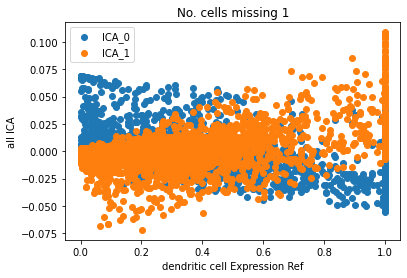

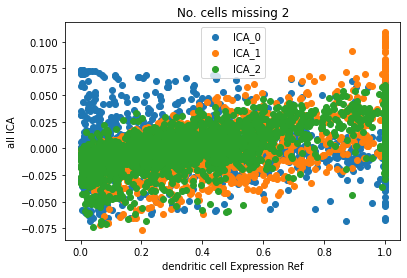

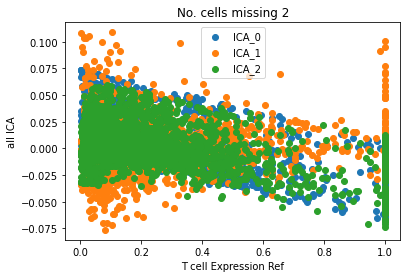

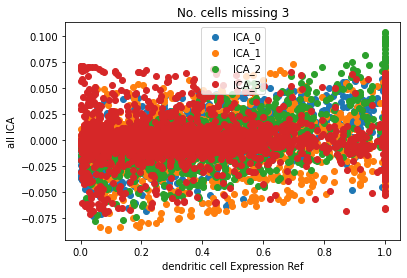

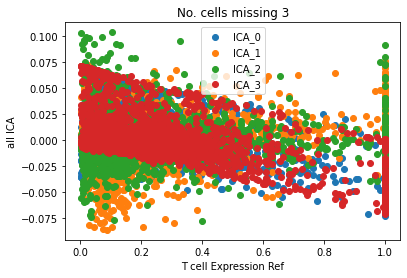

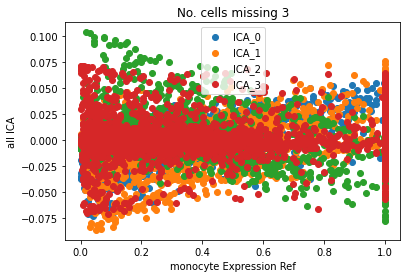

In [1848]:
#all ICs with missing cells expression reference.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_realref[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell] #each celll
        for pc in res_ica_all.columns: #with each component.
            y = res_ica_all[pc]
            plt.scatter(x,y, label = f"ICA_{pc}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"all ICA")
        plt.legend()
        plt.show()

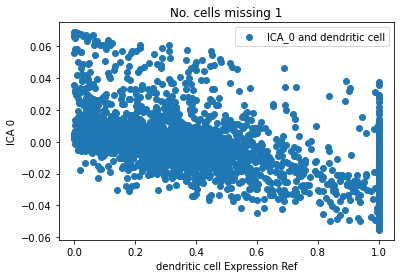

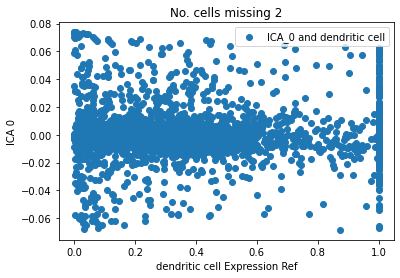

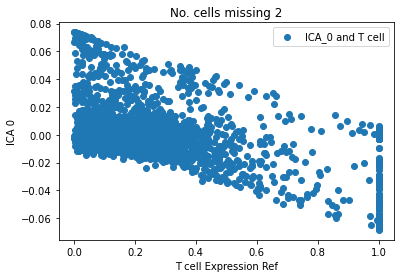

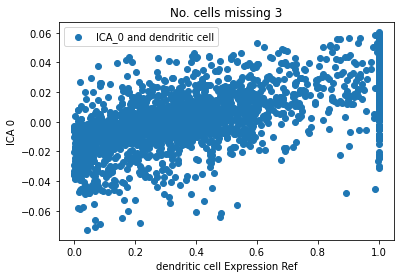

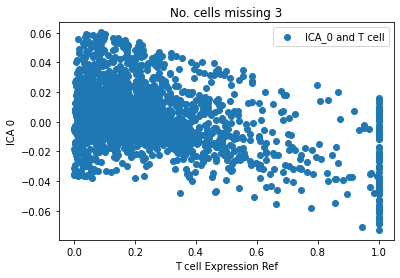

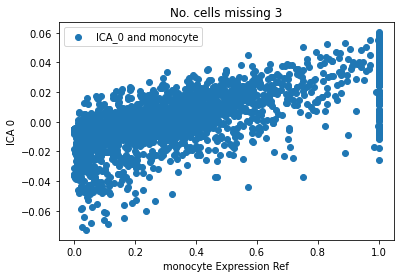

In [1849]:
#each missing cell reference expression with just IC 0.
for num in num_missing_cells[1:]:
    res_ica_all = res_ica_realref[num]
    for cell in missing_cell_exp_usedref[num].columns:
        x = missing_cell_exp_usedref[num][cell]
        y = res_ica_all[0]
        plt.scatter(x,y, label = f"ICA_0 and {cell}")
        plt.title(f'No. cells missing {num}')
        plt.xlabel(f'{cell} Expression Ref')
        plt.ylabel(f"ICA 0")
        plt.legend()
        plt.show()

NMF

Shifting Distributions and Calculating NMF:

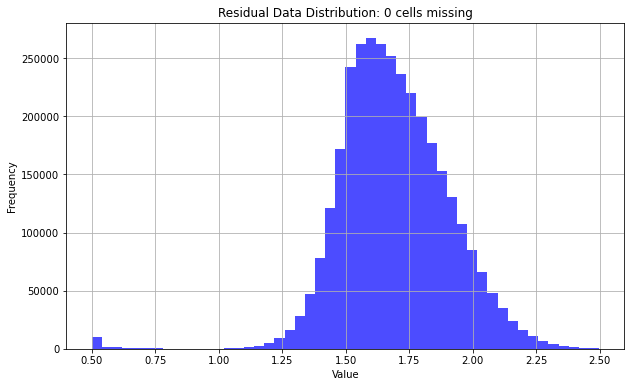

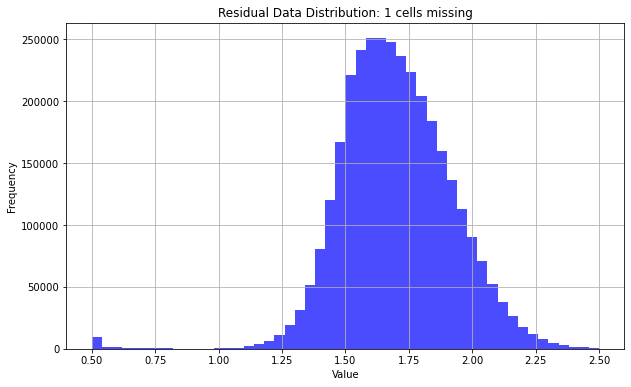

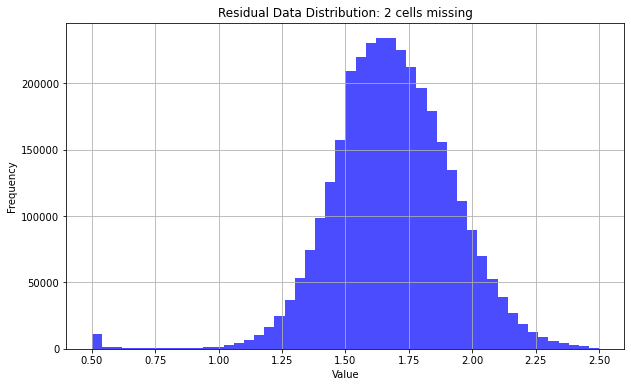

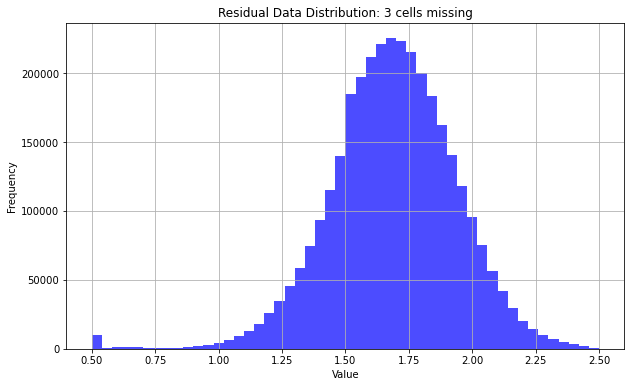

In [1850]:
#shifting distribution of residuals to do NMF
residuals_shift = dict()
for num in num_missing_cells:
    residuals_shift[num] = residuals[num] + 1.5
    data = residuals_shift[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [1851]:
#nmf on residual 1
res_nmf = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve 

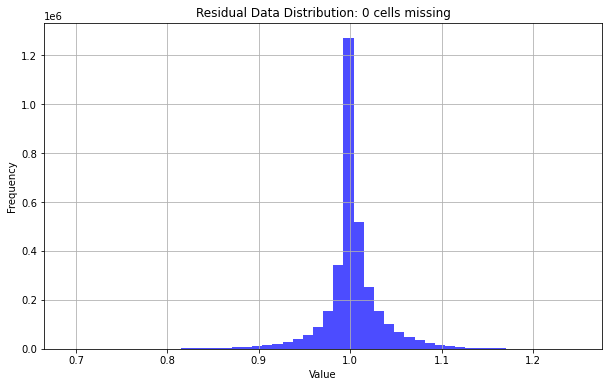

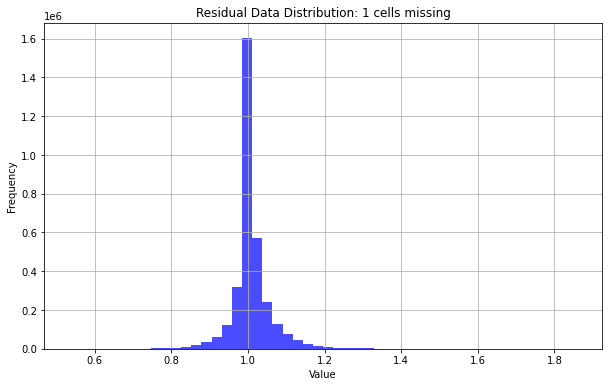

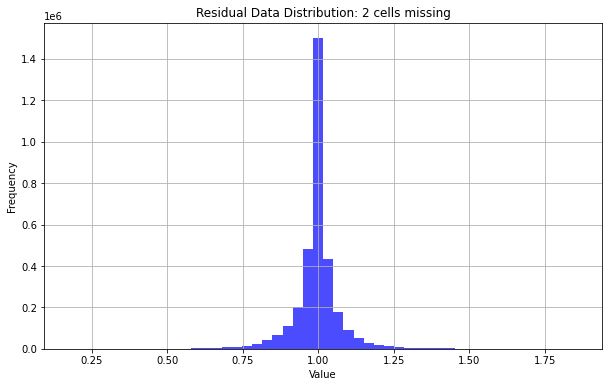

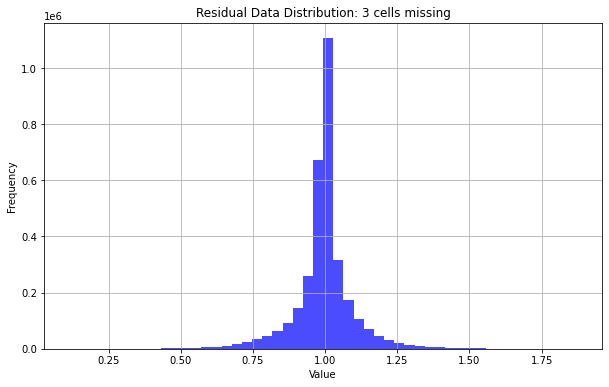

In [1852]:
#shifting distribution of residuals to do NMF
residuals_shift_diffbase = dict()
for num in num_missing_cells:
    residuals_shift_diffbase[num] = residuals_diffbase[num] + 1
    data = residuals_shift_diffbase[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [1853]:
#nmf on residual diffbase
res_nmf_diffbase = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_diffbase[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf_diffbase[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samp

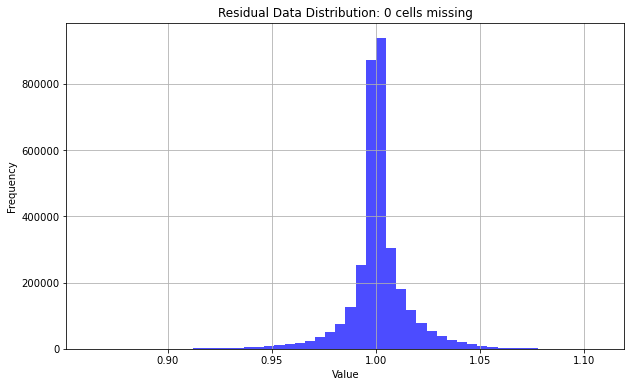

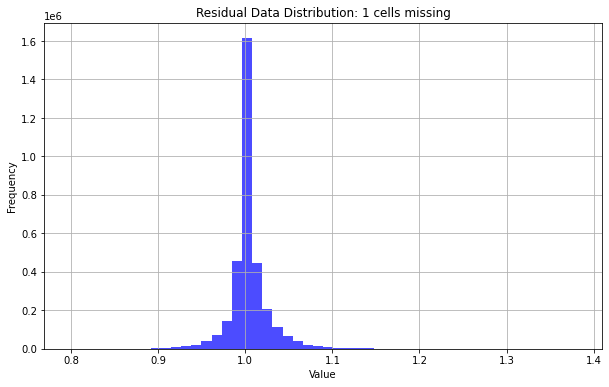

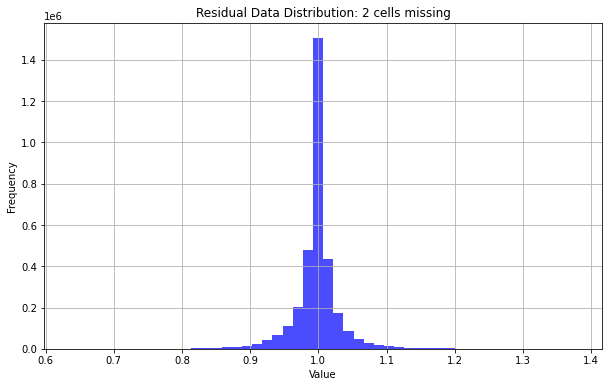

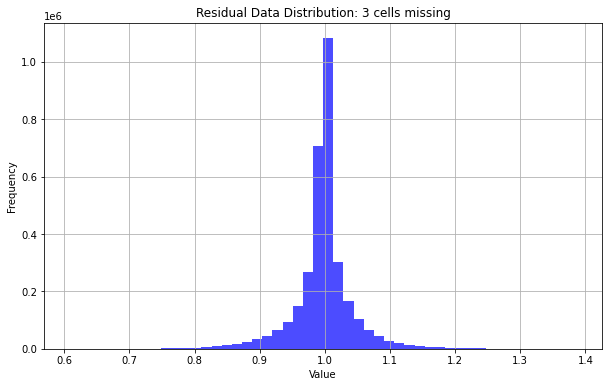

In [1854]:
#shifting distribution of residuals to do NMF
residuals_shift_realref = dict()
for num in num_missing_cells:
    residuals_shift_realref[num] = residuals_realref[num] + 1
    data = residuals_shift_realref[num].values
    plt.figure(figsize=(10, 6))
    plt.hist(data.flatten(), bins=50, color='blue', alpha=0.7)
    plt.title(f'Residual Data Distribution: {num} cells missing')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

In [1855]:
#nmf on residual realref
res_nmf_realref = dict()
for num in num_missing_cells:
    num_nmf = num +1
    nmf = NMF(n_components = num_nmf)
    res_nmf_df = nmf.fit_transform(residuals_shift_realref[num])
    res_nmf_df = pd.DataFrame(res_nmf_df)
    res_nmf_realref[num] = res_nmf_df

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve 

Analyzing NMF Results:

Residual

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


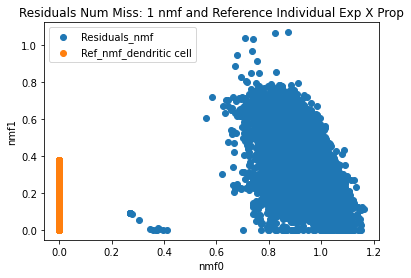

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


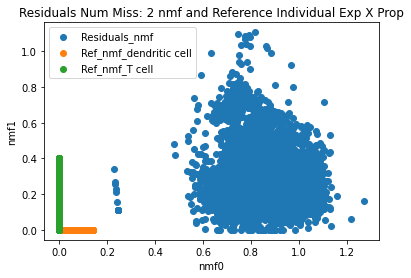

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


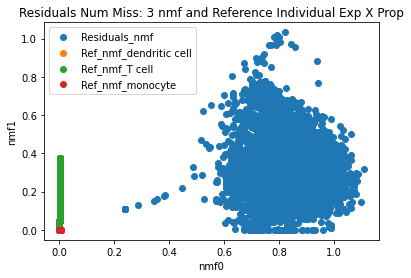

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


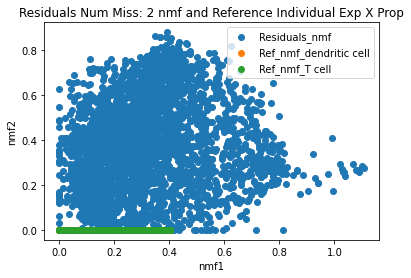

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


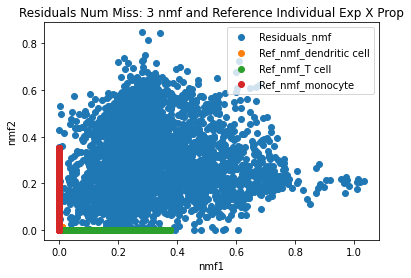

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


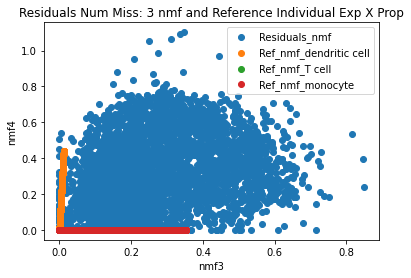

In [1856]:
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


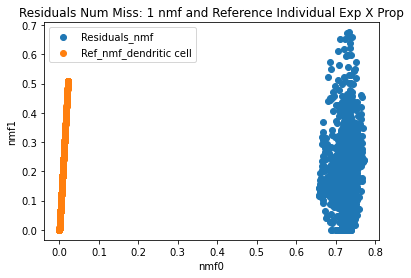

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


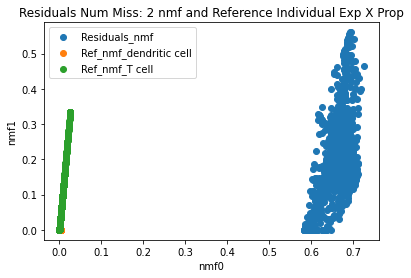

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


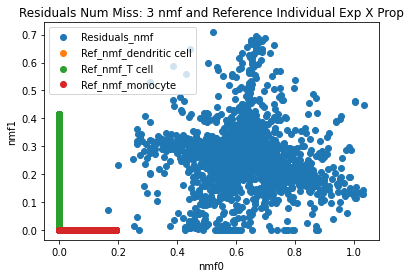

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


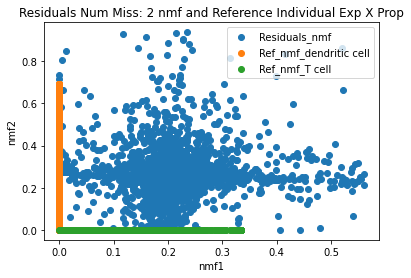

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


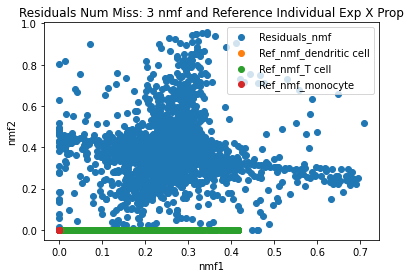

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


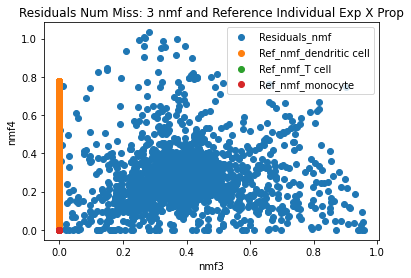

In [1857]:
#nmf of residual diffbase with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

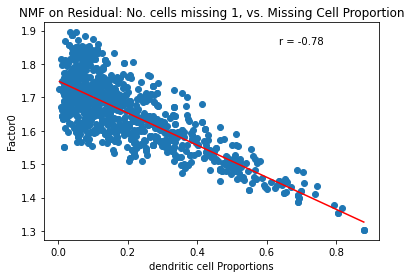

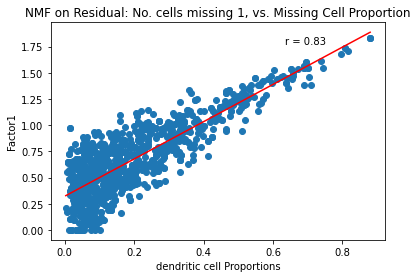

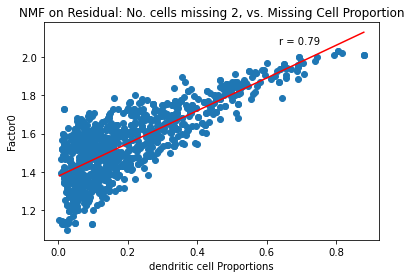

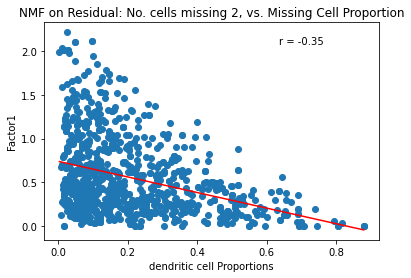

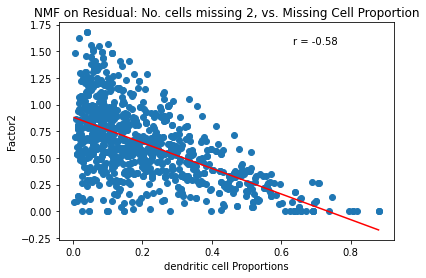

...

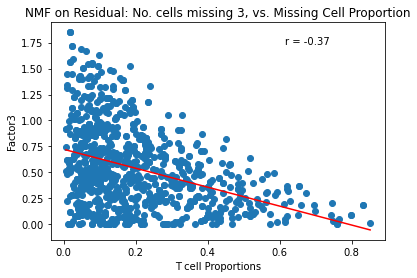

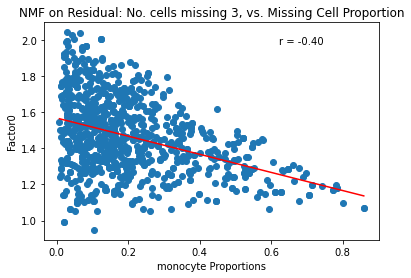

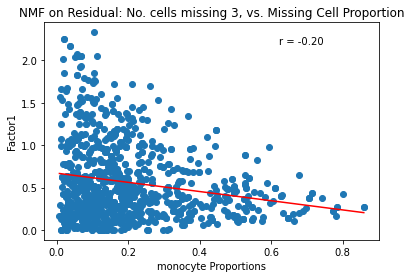

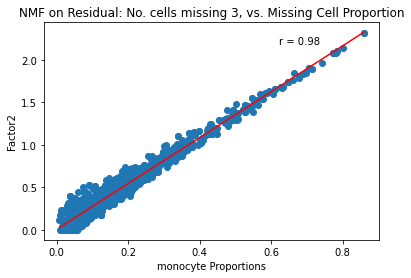

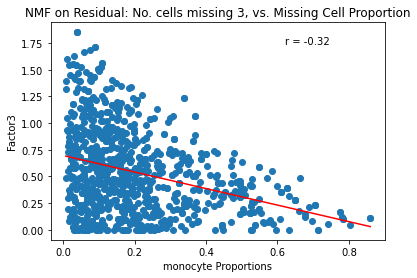

In [1858]:
#each missing cell type expression with each factor
for num in num_missing_cells[1:]:
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_nmf[num].columns: #each factor
            y = res_nmf[num][factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"Factor{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

Residual_diffbase

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


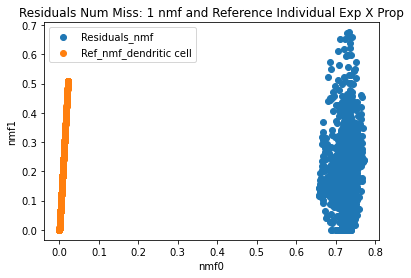

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


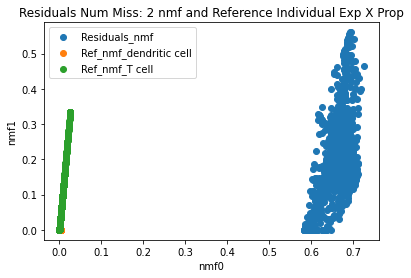

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


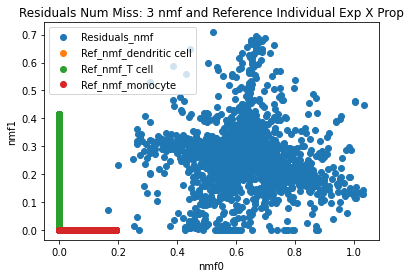

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


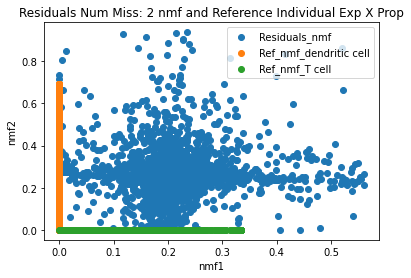

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


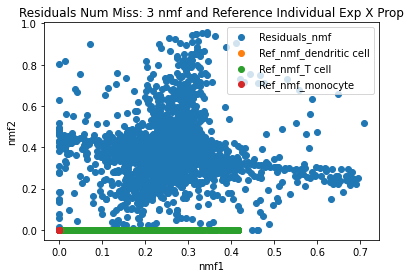

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


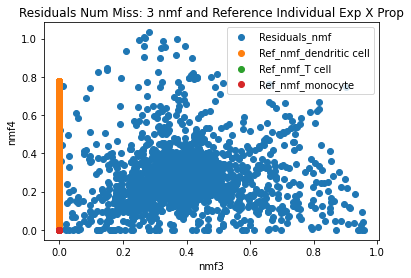

In [1859]:
#nmf of residual diffbase with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_diffbase[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

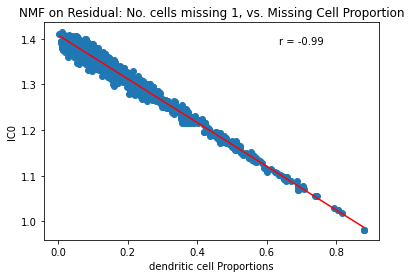

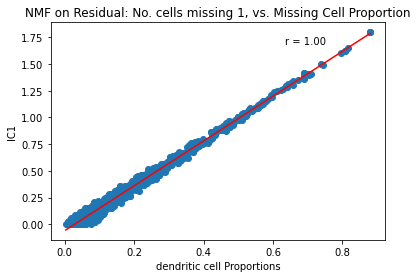

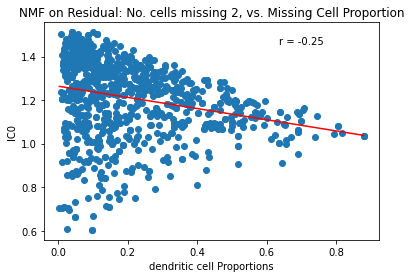

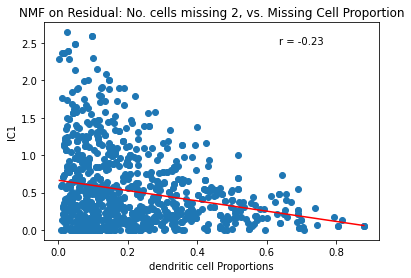

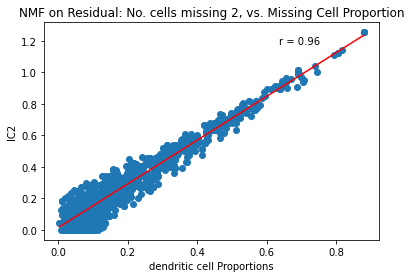

...

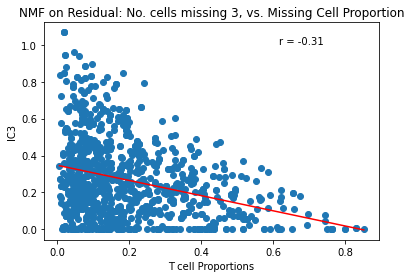

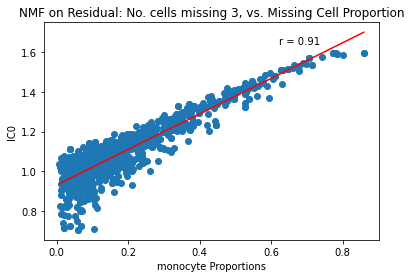

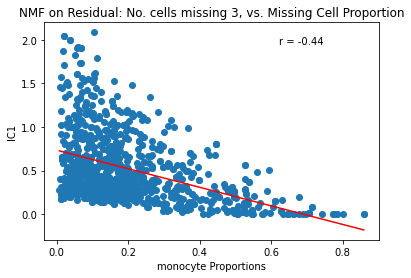

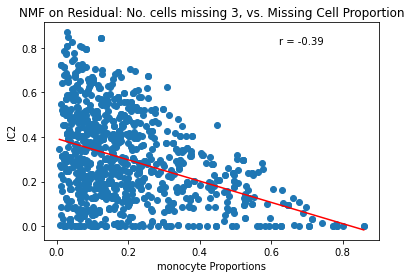

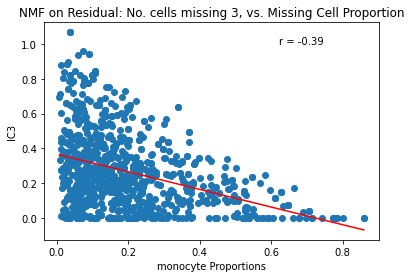

In [1860]:
#each missing cell type expression with each factor
for num in num_missing_cells[1:]:
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_nmf_diffbase[num].columns: #each factor
            y = res_nmf_diffbase[num][factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"IC{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()

Residual_realref

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


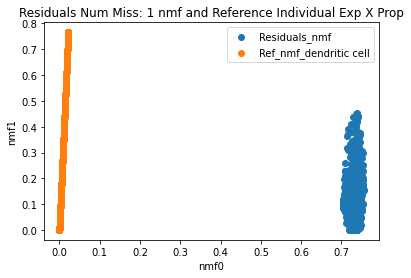

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


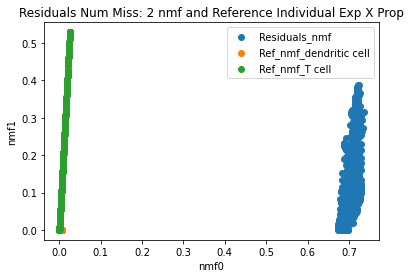

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


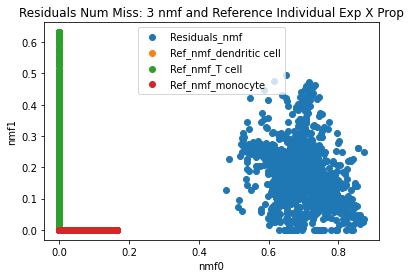

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


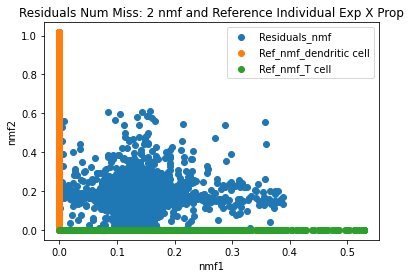

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


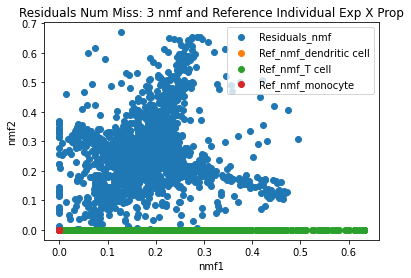

/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:289: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(
/Users/ivicha/opt/anaconda3/envs/env_ml/lib/python3.9/site-packages/sklearn/decomposition/_nmf.py:1637: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


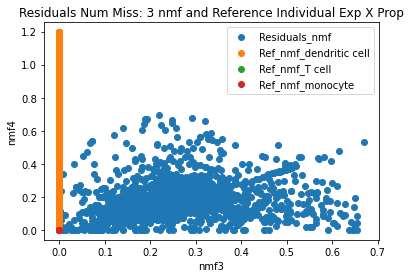

In [1861]:
#nmf of residual realref with individual missing cell expression * proportions.
for num in num_missing_cells[1:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num +1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,0], pseudos_nmf[:,1], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,0], ref_nmf[:,1], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf0")
    plt.ylabel("nmf1")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[2:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,1], pseudos_nmf[:,2], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,1], ref_nmf[:,2], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf1")
    plt.ylabel("nmf2")
    plt.legend()
    plt.show()
#nmf with individual missing cell expression * proportions.
for num in num_missing_cells[3:]:
    cells_dict = usedex_prop_individual[num]
    nmf = NMF(n_components = num+1)
    pseudos_nmf = nmf.fit_transform(residuals_shift_realref[num].T)
    plt.scatter(pseudos_nmf[:,2], pseudos_nmf[:,3], label = "Residuals_nmf" )
    for cell in cells_dict:
        ref_nmf = nmf.transform(cells_dict[cell].T)
        plt.scatter(ref_nmf[:,2], ref_nmf[:,3], label = f"Ref_nmf_{cell}" )
    plt.title(f"Residuals Num Miss: {num} nmf and Reference Individual Exp X Prop")
    plt.xlabel("nmf3")
    plt.ylabel("nmf4")
    plt.legend()
    plt.show()    

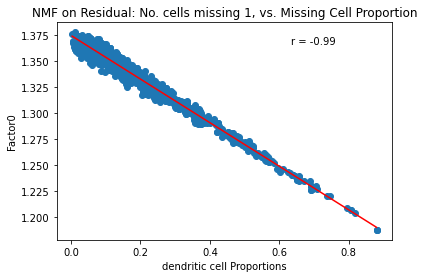

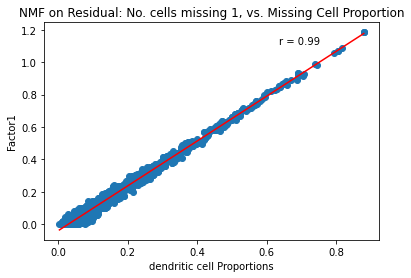

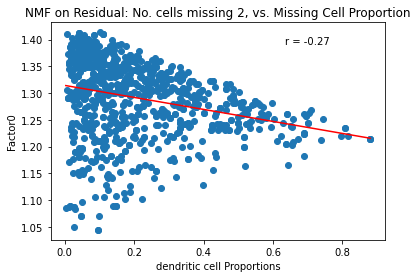

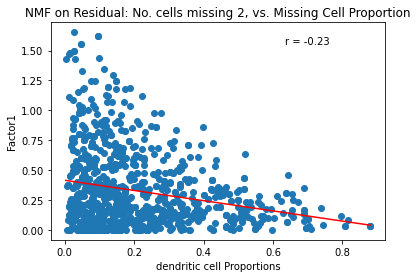

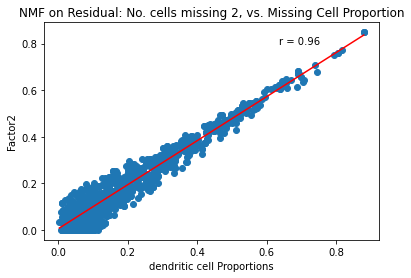

...

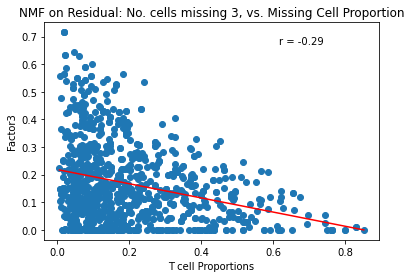

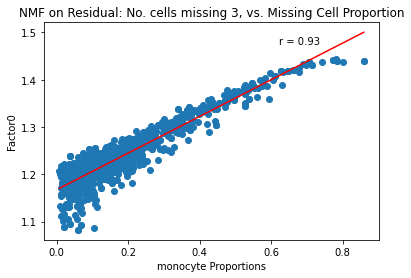

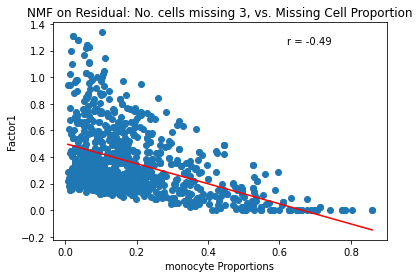

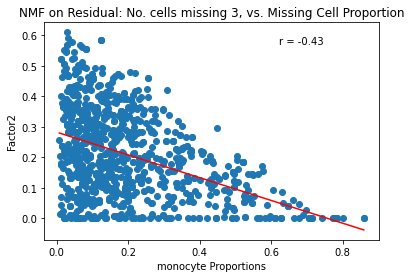

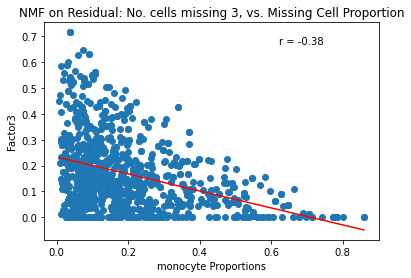

In [1862]:
#each missing cell type expression with each factor
for num in num_missing_cells[1:]:
    for column in missing_cell_prop[num].columns:
        x = missing_cell_prop[num][column] #each missing cell type
        x = list(x)
        for factor in res_nmf_realref[num].columns: #each factor
            y = res_nmf_realref[num][factor]
            y= list(y)
            plt.scatter(x,y)
            plt.title(f'NMF on Residual: No. cells missing {num}, vs. Missing Cell Proportion')
            plt.xlabel(f'{column} Proportions')
            plt.ylabel(f"Factor{factor}")  
            r, p = stats.pearsonr(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
            plt.show()